In [23]:
# import general purpose packages
import pandas as pd
import numpy as np
import os
import random

# import visualization related packages
from PIL import Image
import requests
from io import BytesIO

import matplotlib.pyplot as plt
from matplotlib import gridspec
import seaborn as sns
sns.set()

# import word to vec related package
from gensim.models import Word2Vec
from sklearn.metrics import pairwise_distances


# Text vectorizer related packages
from sklearn.feature_extraction.text import TfidfVectorizer, CountVectorizer

from sklearn.decomposition import TruncatedSVD

# scale the dataset
from sklearn.preprocessing import StandardScaler


# model saving and loading related package
import pickle
from prettytable import PrettyTable

# CONFIGURATIONS

In [2]:
# apparel data pickle path
data_pickle_path = '/media/amd_3/20DAD539DAD50BC2/DSET_REPO/DataSets/CS08_AMZN_FASHION_ENGINE/pickels/16k_apperal_data_preprocessed'

# w2v model path
w2v_pickle_path = '/media/amd_3/20DAD539DAD50BC2/DSET_REPO/DataSets/CS08_AMZN_FASHION_ENGINE/word2vec_model'

# Image related path
img_features_path = '/media/amd_3/20DAD539DAD50BC2/DSET_REPO/DataSets/CS08_AMZN_FASHION_ENGINE/16k_data_cnn_features.npy'
asin_img_path = '/media/amd_3/20DAD539DAD50BC2/DSET_REPO/DataSets/CS08_AMZN_FASHION_ENGINE/16k_data_cnn_feature_asins.npy'
img_base_dir = '/media/amd_3/20DAD539DAD50BC2/DSET_REPO/DataSets/CS08_AMZN_FASHION_ENGINE/15k_images'

# Feature Extraction

## 1) Text features from Title, Color, Brand Fields

In [3]:
def get_text_features(data_pickle_path, w2v_pickle_path):
    
    # read the source data
    df = pd.read_pickle(data_pickle_path)
    
    # sort the data based on asin value
    df = df.sort_values(['asin'])
    df = df.reset_index(drop=True)
    
    # extract individual fields (TEXT data)
    asin_vals = df['asin'].tolist()
    title_ser = df['title']
    color_ser = df['color']
    brand_ser = df['brand']
    
    # print basic information
    print('Data source info:\n', df.head())
    print('Shape of data frame', df.shape)
    print('Sample asin value', df.iloc[125, 0]) # 12566 # asin val example : 'B00JXQB5FQ' 
    
    # ==================== TITLE =============================================================
    
    # load the model
    # declare the dimesnion of w2v model vector
    num_dimension = 300
    
    with open(w2v_pickle_path, 'rb') as handle:
        w2v_model = pickle.load(handle)
     
    print('W2V model loaded, total vocab size:', len(w2v_model))
    
    
    # Vectorize the title
    tf_idf_vectorizer = TfidfVectorizer(min_df=0.0001, max_df=0.95)
    # fit to the data
    tf_idf_vectorizer.fit(title_ser)
    
    # get feature names as list
    feature_names = tf_idf_vectorizer.get_feature_names()
    print('Number of idf features:\t', len(feature_names))
    
    # create a dictionary of idf values
    idf_dict = dict(zip(feature_names, tf_idf_vectorizer.idf_))
    
    # declare an empty list for storing all the vectors
    vec_list = list()
    
    # process every title - Get IDF weighted W2V representation of title
    for title in title_ser:
        
        # initialize a vector for this title
        vector = np.zeros(num_dimension)
        words_present = 0
        
        # process each word in the title one by one
        for word in title.split():
            
            try:
                vector +=  w2v_model[word] * idf_dict[word]
                words_present += 1
            except:
                pass
            
        if words_present > 0:
            vector /=  words_present
    
        # update the list
        vec_list.append(vector)
        
    # create an idf data frame
    df = pd.DataFrame(vec_list, columns=['title_'+ str(i) for i in 
                                         range(1, num_dimension + 1)])
    
    # standard scale the data frame
    std_scaler = StandardScaler()
    df = std_scaler.fit_transform(df)
    df = pd.DataFrame(df, columns=['title_'+ str(i) for i in 
                                   range(1, num_dimension + 1)])
    
    # get dimension of title features
    title_size = df.shape[1]
    
    print('Shape of IDF weighted w2v of title \t', df.shape)
    # ===============================================================================================
    
    # ================= 2- COLOR & Brand ===============================================================
    bow_vectorizer = CountVectorizer(min_df=0.0001, max_df=0.95)
    
    # replace nan values if any & make it a single word
    color_ser = color_ser.map(lambda x : 'NULL' if 
                              pd.isnull(x) else '_'.join(x.split()))
    brand_ser = brand_ser.map(lambda x : 'NULL' if 
                              pd.isnull(x) else '_'.join(x.split()))
    
    
    # get one hot encoding representation
    bow_vectorizer.fit(color_ser)
    color_ser = bow_vectorizer.transform(color_ser)
    feature_names = bow_vectorizer.get_feature_names()
    color_ser = pd.DataFrame(color_ser.toarray(), columns=feature_names)
    
    # update the dataframe
    df = pd.concat([df, color_ser], axis=1)
    print('colour df shape :\t', color_ser.shape)
    color_size = color_ser.shape[1]
    
    bow_vectorizer.fit(brand_ser)
    brand_ser = bow_vectorizer.transform(brand_ser)
    feature_names = bow_vectorizer.get_feature_names()
    brand_ser = pd.DataFrame(brand_ser.toarray(), columns=feature_names)
    
    # update the data frame
    df = pd.concat([df, brand_ser], axis=1)
    print('brand df shape :\t', brand_ser.shape)
    brand_size = brand_ser.shape[1]
    
    print('Text features shape: ', df.shape)
    
    # add asin column
    df.insert(loc=0, column='ASIN', value= asin_vals)
    
    # set partion indices for different features 
    partitions_sizes = (title_size, color_size, brand_size,)
    
    print('Partitions sizes: (idf_features:%d, colour:%d, brand:%d,)'%partitions_sizes)
    
    return (df, partitions_sizes,)

## 2) Features from image

In [4]:
# https://gist.github.com/fchollet/f35fbc80e066a49d65f1688a7e99f069
# https://blog.keras.io/building-powerful-image-classification-models-using-very-little-data.html


# dimensions of our images.
img_width, img_height = 224, 224

top_model_weights_path = 'bottleneck_fc_model.h5'
train_data_dir = 'images2/'
nb_train_samples = 16042
epochs = 50
batch_size = 1


def save_bottlebeck_features():
    
    if os.path.exists(img_features_path):
        print("""Image features already extracted using CNN & saved to
               your local path""")
        
        return
    
    asins = []
    datagen = ImageDataGenerator(rescale=1. / 255)
    
    # build the VGG16 network
    model = applications.VGG16(include_top=False, weights='imagenet')
    generator = datagen.flow_from_directory(
        train_data_dir,
        target_size=(img_width, img_height),
        batch_size=batch_size,
        class_mode=None,
        shuffle=False)

    for i in generator.filenames:
        asins.append(i[2:-5])

    bottleneck_features_train = model.predict_generator(generator, nb_train_samples // batch_size)
    bottleneck_features_train = bottleneck_features_train.reshape((16042,25088))
    
    np.save(open('workshop/models/16k_data_cnn_features.npy', 'wb'), bottleneck_features_train)
    np.save(open('workshop/models/16k_data_cnn_feature_asins.npy', 'wb'), np.array(asins))
    

save_bottlebeck_features()

Image features already extracted using CNN & saved to
               your local path


In [5]:
def reduce_dimension_using_svd(df):
    
    # create an SVD object
    truc_svd = TruncatedSVD(n_components=df.shape[1]-1, n_iter=5, 
                            algorithm='randomized')

    # fit to data
    truc_svd.fit(df)

    # get explained variance ratio of each component
    explained_var_ratios = truc_svd.explained_variance_ratio_

    # get cummulative ratio list for selecting the number of components
    cumulative_ratios = np.cumsum(explained_var_ratios)

    # plot the #components vs captured variance in the data
    plt.title('SVD Decomposition')
    plt.xlabel('Number of components')
    plt.ylabel('Cumulative Percentage Ratio')
    plt.plot(range(1, len(cumulative_ratios) + 1), cumulative_ratios)
    plt.show()

    # set a threshold for stopping selection of components.
    svd_thesh = 0.0001
    
    # select the number of components as the first component for which the difference 
    # between cummulative ratio is very less (less than svd thresh) 
    # compared with the very next component
    
    selected_dim = list(filter(lambda x : x[1] < svd_thesh, 
                        enumerate(np.diff(cumulative_ratios))))[0][0]
    print('Num dimensions selected by SVD', selected_dim)
    print('Total variance captured:%f'%(cumulative_ratios[selected_dim]))

    # create an object for selecting the components
    truc_svd = TruncatedSVD(n_components=selected_dim, n_iter=8, 
                            algorithm='randomized')
    
    # refit with the desired number of components
    truc_svd.fit(df)

    # reduce the number of dimensions to selected number of components
    col_names = ['SVD_' + str(item) for item in range(1,selected_dim+1)]
    df = pd.DataFrame(truc_svd.transform(df), columns=col_names)
    
    return df

In [6]:
def get_image_features(img_features_path, asin_img_path):
    
    # ================ IMAGE features ================================================================
    df = np.load(img_features_path)
    print('Image features shape :\t', df.shape)
    asin_vals = np.load(asin_img_path)
    
    #print('Common asin values:', len(set(asin_vals) & set(df['ASIN'])))
    
    # create data frame
    image_size = df.shape[1]
    df = pd.DataFrame(df, columns=['IMG_' + str(item) 
                            for item in range(1, image_size + 1)])
    
    print('Image features size', image_size)
    
    # add ASIN column
    df.insert(loc=0, column='ASIN', value=asin_vals)
    
    # sort the text df based on ASIN values
    df = df.sort_values(['ASIN'])
    print('Sorting of image df completed')
    df = df.reset_index(drop=True)
    
    # save sorted ASIN values in a list
    sorted_asin = df['ASIN'].tolist()
    
    # drop ASIN value temporaly
    df = df.drop(['ASIN'], axis=1)

    # do the Truncated-SVD as when required
    df = reduce_dimension_using_svd(df)
    
    # get the number of redced dimension
    image_size = df.shape[1]
    
    # add the ASIN VALUE back to the data frame
    df.insert(loc=0, column='ASIN', value=sorted_asin)
    
    return (df, (image_size,),)

## 3)  Combine Text, Image Features

In [7]:
def get_all_features(data_pickle_path, w2v_pickle_path, img_features_path, asin_img_path):
    
    if os.path.exists('./data/Final_df.csv') and os.path.exists('./data/final_partitions.pkl'):
        df = pd.read_csv('./data/Final_df.csv', index_col=False)
        
        #load model from disk
        pickle_in = open('./data/final_partitions.pkl',"rb")
        partitions_dict = pickle.load(pickle_in)
        pickle_in.close()
        
        # get partitions
        partitions = partitions_dict['partitions']
        
        return (df, partitions,)
    
    
    # get text based features
    df_txt, text_partitions = get_text_features(data_pickle_path, w2v_pickle_path)
    
    print('\n\n\n')
    
    # get image based features
    df_img, img_partition = get_image_features(img_features_path, asin_img_path)
    
    
    # drop the ASIN column
    df_img = df_img.drop(['ASIN'], axis=1)
    
    print('Image featues shape', df_img.shape)
    
    # combine text and the image features
    df = pd.concat([df_txt, df_img], axis=1)
    print('Any nan value or infinity present: ', 
          df.isin([np.nan, -np.inf, np.inf, None]).any().any())
    print('Concatenation of data frames completed')
    
    print('Final dataframe shape', df.shape)
    partitions = text_partitions + img_partition
    
    # save the final dataframes to disk
    final_partitions_info_dict = {'partitions' : partitions}
    
    # save model to disk
    pickle_out = open("./data/final_partitions.pkl","wb")
    pickle.dump(final_partitions_info_dict, pickle_out)
    pickle_out.close()
    
    
    # write data frmae to disk
    df.to_csv('./data/Final_df.csv', index=False)
    
    return (df, partitions,)

Data source info:
          asin           brand  color  \
0  0000000060           Jofit  White   
1  6042589113  Dress on Trend  White   
2  6342521018           Crazy  Beige   
3  B00029I0Z6           Roper  Red 2   
4  B0006LTFTK        Ideology   Noir   

                                    medium_image_url  product_type_name  \
0  https://images-na.ssl-images-amazon.com/images...  BUILDING_MATERIAL   
1  https://images-na.ssl-images-amazon.com/images...              SHIRT   
2  https://images-na.ssl-images-amazon.com/images...              SHIRT   
3  https://images-na.ssl-images-amazon.com/images...              SHIRT   
4  https://images-na.ssl-images-amazon.com/images...              PANTS   

                                               title formatted_price  
0       jofit womens jo tech polo white extra large           $25.99  
1  dress trend womens lion chain print baggy over...          $16.00  
2  crazy womens floral sleeveless vintage crochet...           $9.99  
3  ro

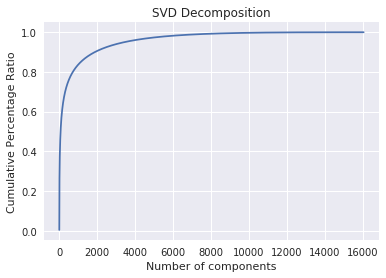

Num dimensions selected by SVD 1058
Total variance captured:0.843180
Image featues shape (16042, 1058)
Any nan value or infinity present:  False
Concatenation of data frames completed
Final dataframe shape (16042, 4094)


,ASIN,title_1,title_2,title_3,title_4,title_5,title_6,title_7,title_8,title_9,...,SVD_1049,SVD_1050,SVD_1051,SVD_1052,SVD_1053,SVD_1054,SVD_1055,SVD_1056,SVD_1057,SVD_1058
0,0000000060,-0.725488,1.252191,0.251974,-0.599627,0.165339,0.918792,0.225216,0.989280,-1.588556,...,-0.166778,-0.200041,-0.254073,-0.456098,-0.127024,-0.240879,-0.242326,0.244390,0.185839,-0.059487
1,6042589113,0.058535,0.072250,-0.907734,0.831356,-0.001838,0.250225,0.199881,0.337636,-2.340854,...,-0.120877,-0.872107,-0.181722,-0.519099,-0.317963,0.062881,0.760047,-0.422860,-0.215892,0.004930
2,6342521018,0.056550,-0.818465,0.118471,0.733309,0.799529,-0.152380,0.148441,-0.747893,-0.102898,...,-0.223701,-0.289555,-0.053055,0.192100,0.328197,0.373874,-0.107148,-0.212226,0.096133,0.010780
3,B00029I0Z6,-1.066330,0.481522,1.447430,0.627053,-0.691602,-0.810547,-0.144988,-0.423558,0.312251,...,0.753429,-0.720246,-0.106816,-0.045370,0.136423,-0.003066,-0.106175,-0.502827,-0.364210,0.304140
4,B0006LTFTK,-1.165708,-0.655533,0.874824,2.883463,0.395946,1.306147,0.646240,-0.568911,-2.303569,...,-0.032671,0.144132,-1.038237,0.568380,0.311660,0.204790,-0.053460,-0.728611,0.532363,-0.170736


In [8]:
final_df, partitions_sizes = get_all_features(data_pickle_path, w2v_pickle_path, 
                                              img_features_path, asin_img_path)

final_df.head()

# Assign Different Weights to Different type of Features

In [11]:
def weight_dataframe(df, weight_tuple, partitions_sizes, file_id):
    
    if os.path.exists('data/final_weigted_df_' + file_id + '.csv'):
        df = pd.read_csv('data/final_weigted_df_' + file_id + '.csv', 
                         index_col=False)
        return df
    
    # initialize partion start column val
    start_index = 1
    
    # a list for holding the start, end column indices for each partition
    partition_bounds_list = list()
    
    # find start, end column indices for each partition
    for size in  partitions_sizes:
        # compute end index
        end_index = start_index + size
        # compute start, end indices
        bounds = (start_index, end_index)
        start_index = end_index
        
        # update the list
        partition_bounds_list.append(bounds)
    
    # partition bounds & its weight
    weight_info_list = list(zip(partition_bounds_list, weight_tuple))
    
    print('Weight info list', weight_info_list )
    
    print(df.shape)
    
    # do for all the partitions
    for bounds, weight in weight_info_list:
        # multiply the partition with corresponding weight
        df.iloc[:, bounds[0]:bounds[1]] *= weight
        
    # save to disk
    df.to_csv('./data/final_weigted_df_' + file_id + '.csv', 
                       index=False)
        
    return df

In [12]:
weight_tuple = (0.25, 0.25, 0.25, 0.25,) # title, color, brand, image
weighted_df = weight_dataframe(final_df, weight_tuple, partitions_sizes, '1')
weighted_df.head()

Weight info list [((1, 301), 0.25), ((301, 1054), 0.25), ((1054, 3036), 0.25), ((3036, 4094), 0.25)]
(16042, 4094)


,ASIN,title_1,title_2,title_3,title_4,title_5,title_6,title_7,title_8,title_9,...,SVD_1049,SVD_1050,SVD_1051,SVD_1052,SVD_1053,SVD_1054,SVD_1055,SVD_1056,SVD_1057,SVD_1058
0,0000000060,-0.045343,0.078262,0.015748,-0.037477,0.010334,0.057425,0.014076,0.061830,-0.099285,...,-0.010424,-0.012503,-0.015880,-0.028506,-0.007939,-0.015055,-0.015145,0.015274,0.011615,-0.003718
1,6042589113,0.003658,0.004516,-0.056733,0.051960,-0.000115,0.015639,0.012493,0.021102,-0.146303,...,-0.007555,-0.054507,-0.011358,-0.032444,-0.019873,0.003930,0.047503,-0.026429,-0.013493,0.000308
2,6342521018,0.003534,-0.051154,0.007404,0.045832,0.049971,-0.009524,0.009278,-0.046743,-0.006431,...,-0.013981,-0.018097,-0.003316,0.012006,0.020512,0.023367,-0.006697,-0.013264,0.006008,0.000674
3,B00029I0Z6,-0.066646,0.030095,0.090464,0.039191,-0.043225,-0.050659,-0.009062,-0.026472,0.019516,...,0.047089,-0.045015,-0.006676,-0.002836,0.008526,-0.000192,-0.006636,-0.031427,-0.022763,0.019009
4,B0006LTFTK,-0.072857,-0.040971,0.054677,0.180216,0.024747,0.081634,0.040390,-0.035557,-0.143973,...,-0.002042,0.009008,-0.064890,0.035524,0.019479,0.012799,-0.003341,-0.045538,0.033273,-0.010671


In [13]:
weight_tuple = (0.60, 0.05, 0.15, 0.20,) # title, color, brand, image
weighted_df = weight_dataframe(final_df, weight_tuple, partitions_sizes, '2')
weighted_df.head()

Weight info list [((1, 301), 0.6), ((301, 1054), 0.05), ((1054, 3036), 0.15), ((3036, 4094), 0.2)]
(16042, 4094)


,ASIN,title_1,title_2,title_3,title_4,title_5,title_6,title_7,title_8,title_9,...,SVD_1049,SVD_1050,SVD_1051,SVD_1052,SVD_1053,SVD_1054,SVD_1055,SVD_1056,SVD_1057,SVD_1058
0,0000000060,-0.027206,0.046957,0.009449,-0.022486,0.006200,0.034455,0.008446,0.037098,-0.059571,...,-0.002085,-0.002501,-0.003176,-0.005701,-0.001588,-0.003011,-0.003029,0.003055,0.002323,-0.000744
1,6042589113,0.002195,0.002709,-0.034040,0.031176,-0.000069,0.009383,0.007496,0.012661,-0.087782,...,-0.001511,-0.010901,-0.002272,-0.006489,-0.003975,0.000786,0.009501,-0.005286,-0.002699,0.000062
2,6342521018,0.002121,-0.030692,0.004443,0.027499,0.029982,-0.005714,0.005567,-0.028046,-0.003859,...,-0.002796,-0.003619,-0.000663,0.002401,0.004102,0.004673,-0.001339,-0.002653,0.001202,0.000135
3,B00029I0Z6,-0.039987,0.018057,0.054279,0.023514,-0.025935,-0.030396,-0.005437,-0.015883,0.011709,...,0.009418,-0.009003,-0.001335,-0.000567,0.001705,-0.000038,-0.001327,-0.006285,-0.004553,0.003802
4,B0006LTFTK,-0.043714,-0.024582,0.032806,0.108130,0.014848,0.048981,0.024234,-0.021334,-0.086384,...,-0.000408,0.001802,-0.012978,0.007105,0.003896,0.002560,-0.000668,-0.009108,0.006655,-0.002134


In [14]:
weight_tuple = (0.50, 0.10, 0.10, 0.30,) # title, color, brand, image
weighted_df = weight_dataframe(final_df, weight_tuple, partitions_sizes, '3')
weighted_df.head()

Weight info list [((1, 301), 0.5), ((301, 1054), 0.1), ((1054, 3036), 0.1), ((3036, 4094), 0.3)]
(16042, 4094)


,ASIN,title_1,title_2,title_3,title_4,title_5,title_6,title_7,title_8,title_9,...,SVD_1049,SVD_1050,SVD_1051,SVD_1052,SVD_1053,SVD_1054,SVD_1055,SVD_1056,SVD_1057,SVD_1058
0,0000000060,-0.013603,0.023479,0.004725,-0.011243,0.003100,0.017227,0.004223,0.018549,-0.029785,...,-0.000625,-0.000750,-0.000953,-0.001710,-0.000476,-0.000903,-0.000909,0.000916,0.000697,-0.000223
1,6042589113,0.001098,0.001355,-0.017020,0.015588,-0.000034,0.004692,0.003748,0.006331,-0.043891,...,-0.000453,-0.003270,-0.000681,-0.001947,-0.001192,0.000236,0.002850,-0.001586,-0.000810,0.000018
2,6342521018,0.001060,-0.015346,0.002221,0.013750,0.014991,-0.002857,0.002783,-0.014023,-0.001929,...,-0.000839,-0.001086,-0.000199,0.000720,0.001231,0.001402,-0.000402,-0.000796,0.000361,0.000040
3,B00029I0Z6,-0.019994,0.009029,0.027139,0.011757,-0.012968,-0.015198,-0.002719,-0.007942,0.005855,...,0.002825,-0.002701,-0.000401,-0.000170,0.000512,-0.000011,-0.000398,-0.001886,-0.001366,0.001141
4,B0006LTFTK,-0.021857,-0.012291,0.016403,0.054065,0.007424,0.024490,0.012117,-0.010667,-0.043192,...,-0.000123,0.000540,-0.003893,0.002131,0.001169,0.000768,-0.000200,-0.002732,0.001996,-0.000640


In [15]:
weight_tuple = (0.90, 0.02, 0.03, 0.05,) # title, color, brand, image
weighted_df = weight_dataframe(final_df, weight_tuple, partitions_sizes, '4')
weighted_df.head()

Weight info list [((1, 301), 0.9), ((301, 1054), 0.02), ((1054, 3036), 0.03), ((3036, 4094), 0.05)]
(16042, 4094)


,ASIN,title_1,title_2,title_3,title_4,title_5,title_6,title_7,title_8,title_9,...,SVD_1049,SVD_1050,SVD_1051,SVD_1052,SVD_1053,SVD_1054,SVD_1055,SVD_1056,SVD_1057,SVD_1058
0,0000000060,-0.012243,0.021131,0.004252,-0.010119,0.002790,0.015505,0.003801,0.016694,-0.026807,...,-0.000031,-0.000038,-0.000048,-0.000086,-0.000024,-4.516476e-05,-0.000045,0.000046,0.000035,-1.115387e-05
1,6042589113,0.000988,0.001219,-0.015318,0.014029,-0.000031,0.004223,0.003373,0.005698,-0.039502,...,-0.000023,-0.000164,-0.000034,-0.000097,-0.000060,1.179021e-05,0.000143,-0.000079,-0.000040,9.243060e-07
2,6342521018,0.000954,-0.013812,0.001999,0.012375,0.013492,-0.002571,0.002505,-0.012621,-0.001736,...,-0.000042,-0.000054,-0.000010,0.000036,0.000062,7.010131e-05,-0.000020,-0.000040,0.000018,2.021333e-06
3,B00029I0Z6,-0.017994,0.008126,0.024425,0.010582,-0.011671,-0.013678,-0.002447,-0.007148,0.005269,...,0.000141,-0.000135,-0.000020,-0.000009,0.000026,-5.749329e-07,-0.000020,-0.000094,-0.000068,5.702620e-05
4,B0006LTFTK,-0.019671,-0.011062,0.014763,0.048658,0.006682,0.022041,0.010905,-0.009600,-0.038873,...,-0.000006,0.000027,-0.000195,0.000107,0.000058,3.839820e-05,-0.000010,-0.000137,0.000100,-3.201293e-05


# Recommendation System

In [52]:
def display_img(url, web_image=False):
    
    if web_image:
        # we get the url of the apparel and download it
        response = requests.get(url)
        img = Image.open(BytesIO(response.content))
    else:
        local_uri = os.path.join(img_base_dir, url.split('/')[-1])
        img = Image.open(local_uri)
    
    # we will display it in notebook 
    plt.imshow(img)

In [53]:
def get_title_vector_list(w2v_model, title):
    
    # set a default vector
    default_vec = np.zeros(300)
    
    vector_list = list()
    
    # for every word get the vector
    for word in title.split():
        try:
            vector_list.append(w2v_model[word])
        except:
            vector_list.append(default_vec)
            
            
    return vector_list

In [54]:
def heat_map_w2v2(plot_dict, w2v_pickle_path, apparel_pair, web_img=False):

    # get title of refrerence, recommend apparel
    ref_title = plot_dict['ref_title']
    recommended_title = plot_dict['recommended_title']
    url = plot_dict['medium_image_url']
    
    # load the W2V model
    with open(w2v_pickle_path, 'rb') as handle:
        w2v_model = pickle.load(handle)
        
    # get reference, recommended words w2v representation
    ref_vec_list = get_title_vector_list(w2v_model, ref_title)
    recommended_vec_list = get_title_vector_list(w2v_model, recommended_title)
    
    #print('Number of vectors (word) in reference title', len(ref_vec_list))
    #print('Number of vectors (word) in recommended title', len(recommended_vec_list))
    
    # get pairwie distances between 
    distances = pairwise_distances(recommended_vec_list, ref_vec_list)
    # form the distance dataframe
    distance_df = pd.DataFrame(distances)
    distance_df.columns = ref_title.split()
    distance_df.index = recommended_title.split()
    #print('Shape of pairwise distance metric:', distances.shape)
    
    # devide whole figure into 2 parts 1st part displays heatmap 2nd part displays image of apparel
    gs = gridspec.GridSpec(2, 2, width_ratios=[4,1], height_ratios=[2,1]) 
    fig = plt.figure(figsize=(15,15))
    
    ax = plt.subplot(gs[0])
    # ploting the heap map based on the pairwise distances
    ax = sns.heatmap(distance_df, annot=True, cmap='YlGnBu', fmt='.4f',
                   cbar_kws={'label': 'Distance Metric', 'format':'%.4f'})
    
    # set the x axis labels as recommended apparels title
    # set title, x, y labels
    ax.set_title('Title Similarity/Difference')
    ax.set_xlabel('Reference Apparel : ' + apparel_pair[0])
    ax.set_ylabel('Recommended Apparel : ' + apparel_pair[1])
    
    
    ax = plt.subplot(gs[1])
    # we remove all grids and axis labels for image
    ax.grid(False)
    ax.set_xticks([])
    ax.set_yticks([])
    ax.set_title(apparel_pair[1])
    
    # display the image
    display_img(url, web_img)
    
    plt.show()

In [55]:
def weighted_w2v_model(df, data_pickle_path, doc_asin, num_results, w2v_pickle_path):
    # doc_id: apparel's id in given corpus
    
    # pairwise_dist will store the distance from given input apparel to all remaining apparels
    # the metric we used here is cosine, the coside distance is mesured as K(X, Y) = <X, Y> / (||X||*||Y||)
    # http://scikit-learn.org/stable/modules/metrics.html#cosine-similarity
    
    # get reference point
    reference_point_df = df[df['ASIN'] == doc_asin]
    
    # reshape to compare with the rest of the points
    reference_point = [reference_point_df.values.reshape(1, -1)[0][1:]]
    
    # prepare the other df
    other_df = df[df['ASIN'] != doc_asin]
    other_asins = other_df['ASIN'].tolist()
    
    
    # compute the pair wise distances
    pairwise_dist = pairwise_distances(other_df.iloc[:, 1:].values, reference_point, 
                                       metric='cosine')
    
    dist_df = pd.DataFrame(pairwise_dist, columns=['Distance'])
    dist_df.insert(loc=0, column='ASIN', value=other_asins)
    
    # sort the data frame based on the distance in ascending order
    dist_df = dist_df.sort_values(['Distance'], ascending=True)
    
    # get the smallest num_results values
    dist_df = dist_df.iloc[0:num_results]
    
    # get nearest ASINs list
    nearest_asin_list = dist_df['ASIN'].tolist()
    
    
    # read the product info df
    product_info_df = pd.read_pickle(data_pickle_path)
    ref_title = product_info_df[product_info_df['asin'] == doc_asin]['title'].tolist()[0]
    
    ref_url = product_info_df[product_info_df['asin'] == doc_asin]['medium_image_url'].tolist()[0]
    print('<-->'*25)
    print('Reference Image ... \n')
    display_img(ref_url, web_image=False)
    plt.show()
    print('<-->'*25)
    
    # filter only the above asins from product info df
    product_info_df = product_info_df[product_info_df['asin'].isin(nearest_asin_list)]
    product_info_df.rename(columns={'asin':'ASIN'}, inplace=True)
    product_info_df = pd.merge(product_info_df, dist_df, on=['ASIN'])
    
    # declare a plot dictionary
    plot_dict = dict()
    
    # insert reference point info to dictionary
    plot_dict['ref_title'] = ref_title
    
    # print the nearest products info
    for index, row in product_info_df.iterrows():
        print('='*105)
        
        # set plot dictionary
        plot_dict['recommended_title'] = row['title']
        plot_dict['medium_image_url'] = row['medium_image_url']
        
        # other info
        print('\nRecommended Product %d Information :\n'%(index+1,))
        print('ASIN:\t', row['ASIN'])
        print('Brand: \t', row['brand'])
        print('Color: \t', row['color'])
        print('Price:\t', row['formatted_price'])
        print('\nDescription Summary: \n\n', row['title'], '\n')
        
        # form reference, recommended product IDs
        apparel_pair = (doc_asin, row['ASIN'],)
        
        # plot the heatmap
        heat_map_w2v2(plot_dict, w2v_pickle_path, apparel_pair, False)
        
        print('='*105)
        
        print('\n'*2)

# Recommend

In [56]:
# take a sample of 3
asin_vals = list(np.load(asin_img_path))
# sample three apparels randomly
ref_apparel_list = random.sample(asin_vals, 3)

# prepare a list of reference apparels
ref_apparel_list = list(set(['B0006LTFTK']).union(set(ref_apparel_list)))
#reference_apparel = 'B0006LTFTK'
ref_apparel_list

['B0759VZV4C', 'B0006LTFTK', 'B00CHV779W', 'B01LMJ5XYK']

In [57]:
def recommend_apparel(weighted_df_path, ref_apparel_list):
    
    # read the weighted df
    weighted_df = pd.read_csv(weighted_df_path, index_col=False)
    
    # set the number of recommendations to show
    num_results = 8

    # for each of the reference apparel
    for reference_apparel in ref_apparel_list:
        print('*'*50)
        # Recommend apparel using the reference apparel
        weighted_w2v_model(weighted_df, data_pickle_path, reference_apparel, 
                           num_results, w2v_pickle_path)
        
        print('*'*50)

In [58]:
Pret_table = PrettyTable()
Pret_table.field_names = ['SL NO', 'Title', 'Colour', 'Brand', 'Image']
Pret_table.title = 'Weights of Features'

Pret_table.add_row((1, 0.25, 0.25, 0.25, 0.25,))
Pret_table.add_row((2, 0.60, 0.05, 0.15, 0.20,))
Pret_table.add_row((3, 0.50, 0.10, 0.10, 0.30,))
Pret_table.add_row((4, 0.90, 0.02, 0.03, 0.05,))
print(Pret_table)

+----------------------------------------+
|          Weights of Features           |
+-------+-------+--------+-------+-------+
| SL NO | Title | Colour | Brand | Image |
+-------+-------+--------+-------+-------+
|   1   |  0.25 |  0.25  |  0.25 |  0.25 |
|   2   |  0.6  |  0.05  |  0.15 |  0.2  |
|   3   |  0.5  |  0.1   |  0.1  |  0.3  |
|   4   |  0.9  |  0.02  |  0.03 |  0.05 |
+-------+-------+--------+-------+-------+


**************************************************
<--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><-->
Reference Image ... 



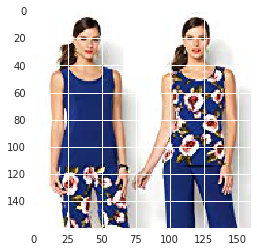

<--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><-->

Recommended Product 1 Information :

ASIN:	 B06Y5MBCV5
Brand: 	 Felina
Color: 	 Blue/Grey
Price:	 $6.25

Description Summary: 

 felina womens fine ribbed knit tank tops 2pack bluegrey small  



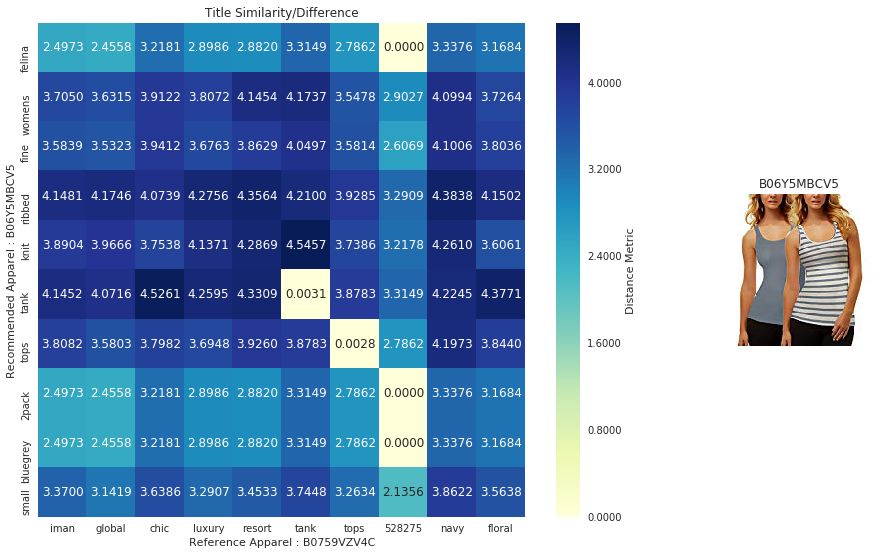





Recommended Product 2 Information :

ASIN:	 B006779L3W
Brand: 	 Fitness Etc.
Color: 	 Black
Price:	 $19.99

Description Summary: 

 longer length sheer yoga tank black medium  



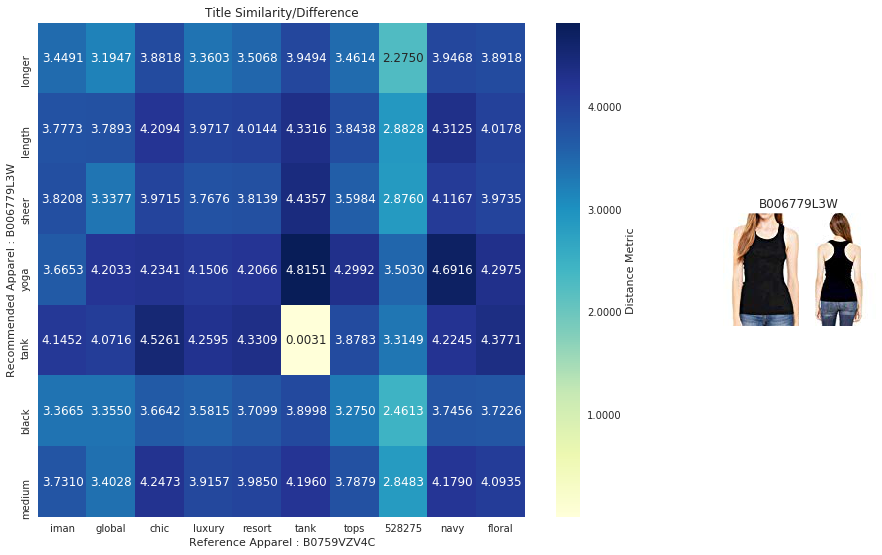





Recommended Product 3 Information :

ASIN:	 B073PFJZK2
Brand: 	 FMRSLHRVIB
Color: 	 WHITE
Price:	 $64.99

Description Summary: 

 pack 24 white blank shirt v neck short sleeve women top stretch l new  



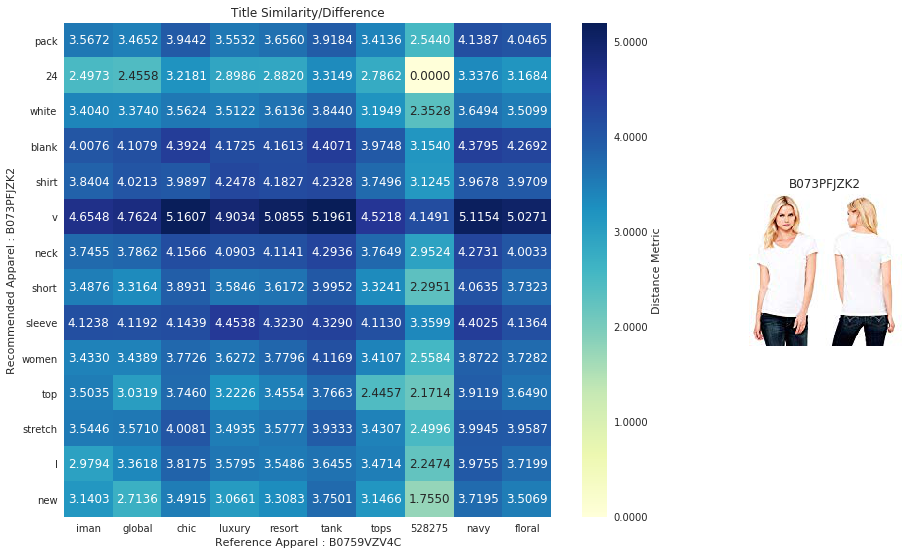





Recommended Product 4 Information :

ASIN:	 B06X42M91R
Brand: 	 DZT1968
Color: 	 White a
Price:	 $3.99

Description Summary: 

 dzt1968 women stripe bralette bralet bustier crop top tank tops bra vest pad white  



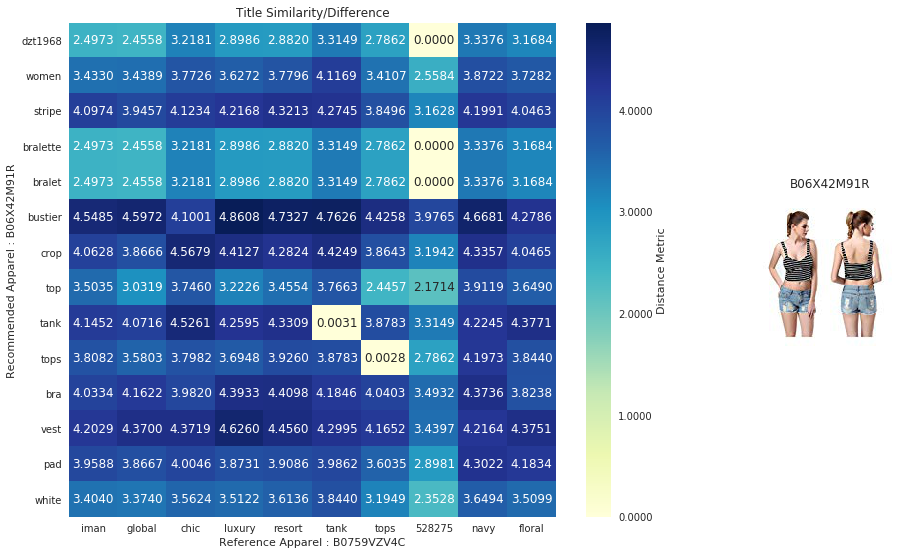





Recommended Product 5 Information :

ASIN:	 B073PDYXPX
Brand: 	 FMRSLHRVIB
Color: 	 WHITE
Price:	 $27.99

Description Summary: 

 6 pc wholesale white shirt v neck short sleeve women junior tops stretch l  



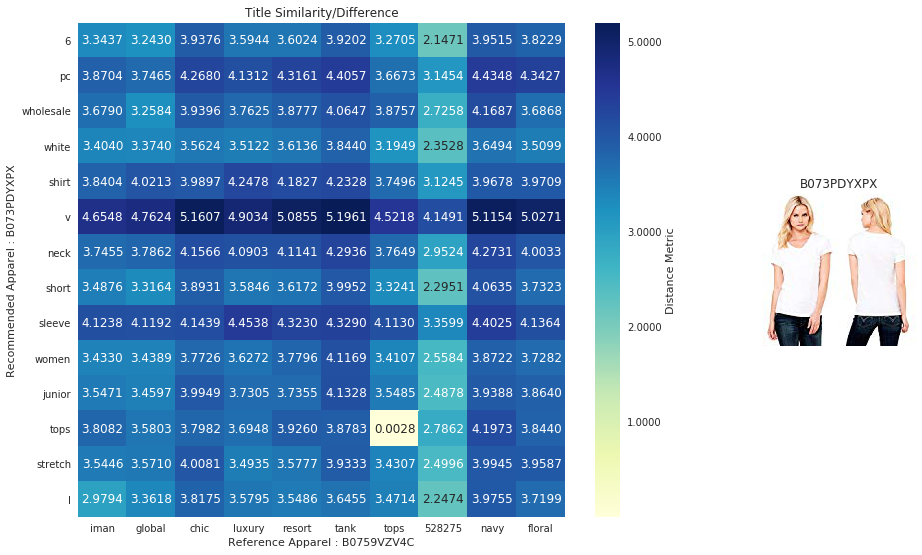





Recommended Product 6 Information :

ASIN:	 B01MUAOXSN
Brand: 	 Free to Live
Color: 	 Black, Navy, White
Price:	 $18.95

Description Summary: 

 3 pack womens racerback tank tops  



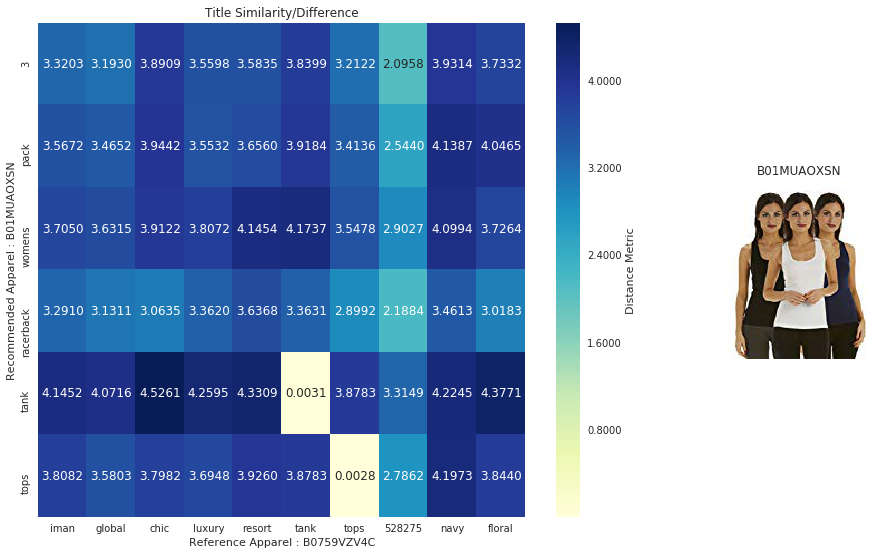





Recommended Product 7 Information :

ASIN:	 B011U33X54
Brand: 	 HP95(TM)
Color: 	 Yellow
Price:	 $11.79

Description Summary: 

 hp95tm womens bohemian style batwing sleeve chiffon beach loose shirt yellow  



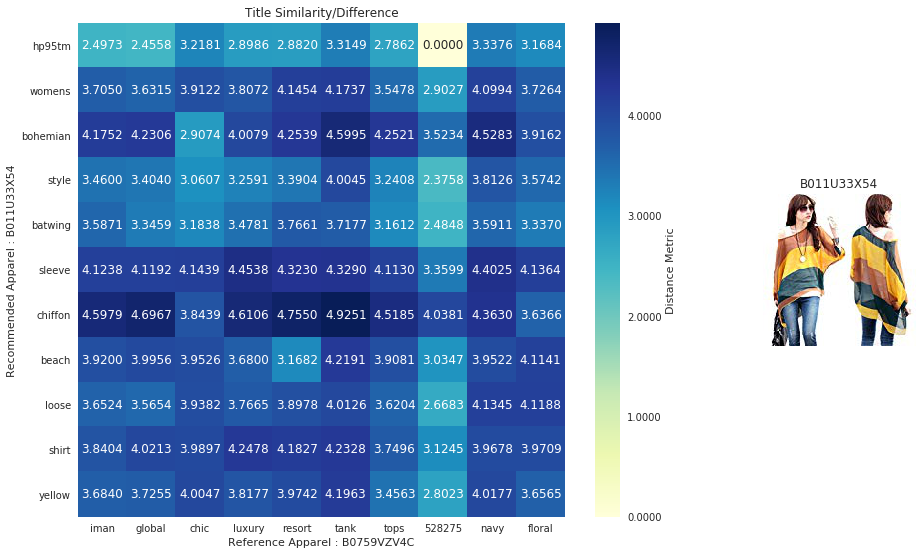





Recommended Product 8 Information :

ASIN:	 B071X8CJ2T
Brand: 	 VS Pink
Color: 	 Soft Begonia
Price:	 $39.50

Description Summary: 

 victorias secret pink new sequins bling vneck tee soft begonia medium  



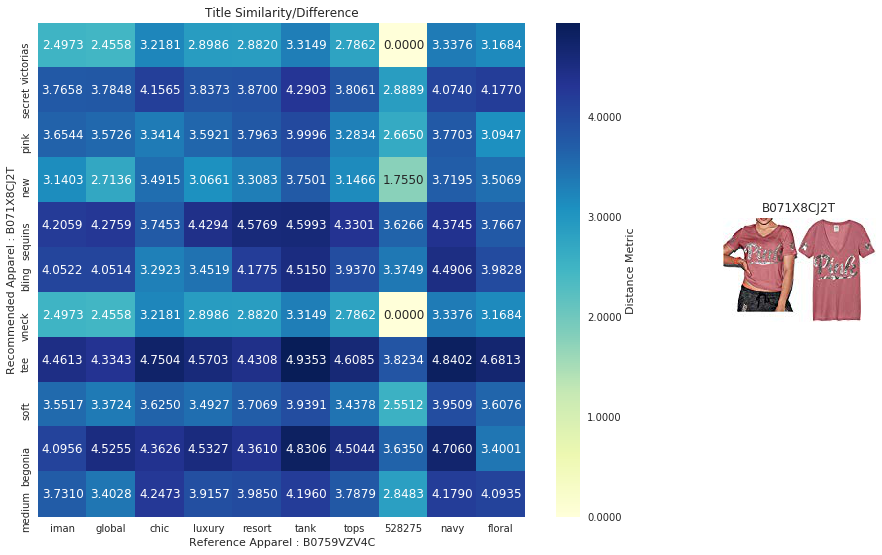




**************************************************
**************************************************
<--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><-->
Reference Image ... 



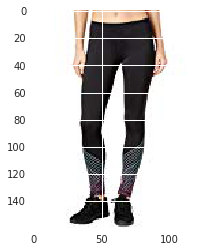

<--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><-->

Recommended Product 1 Information :

ASIN:	 B01AUJF0A0
Brand: 	 Hot Chillys
Color: 	 Static Dream
Price:	 $17.32

Description Summary: 

 hot chillys womens mtf sub print tight  static dream  



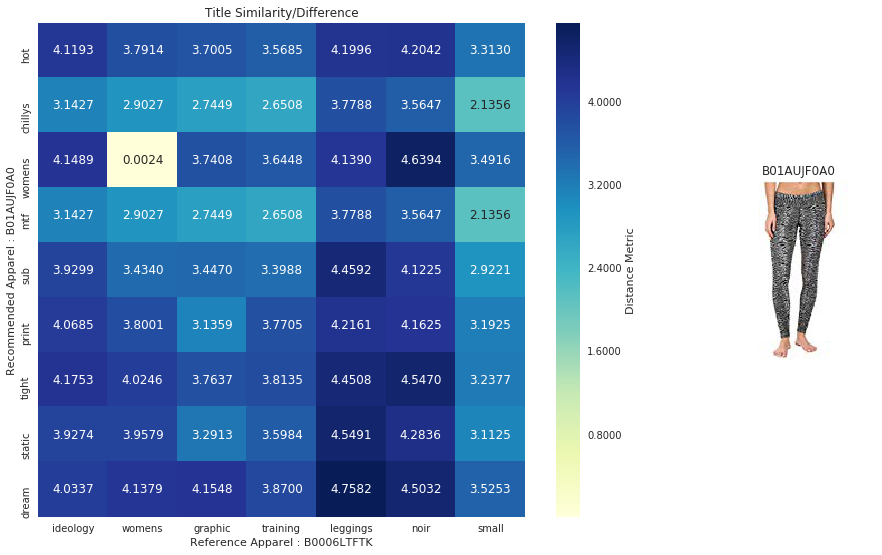





Recommended Product 2 Information :

ASIN:	 B01AW2DXQ8
Brand: 	 Hot Chillys
Color: 	 Viola/Black
Price:	 $39.99

Description Summary: 

 hot chillys womens mtf flex capri  violablack xl  



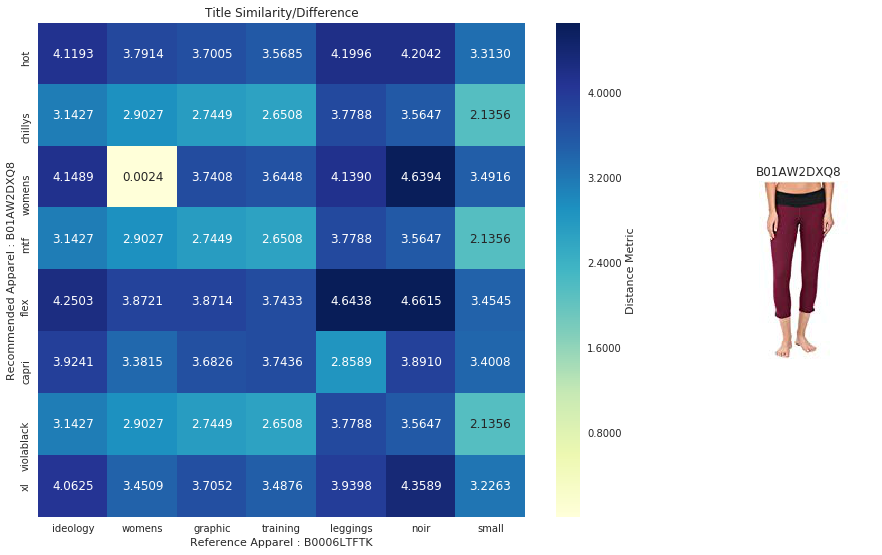





Recommended Product 3 Information :

ASIN:	 B01AW2EYLQ
Brand: 	 Hot Chillys
Color: 	 Black/Wild
Price:	 $45.99

Description Summary: 

 hot chillys womens mtf flx sub prt capri blackwild xl  



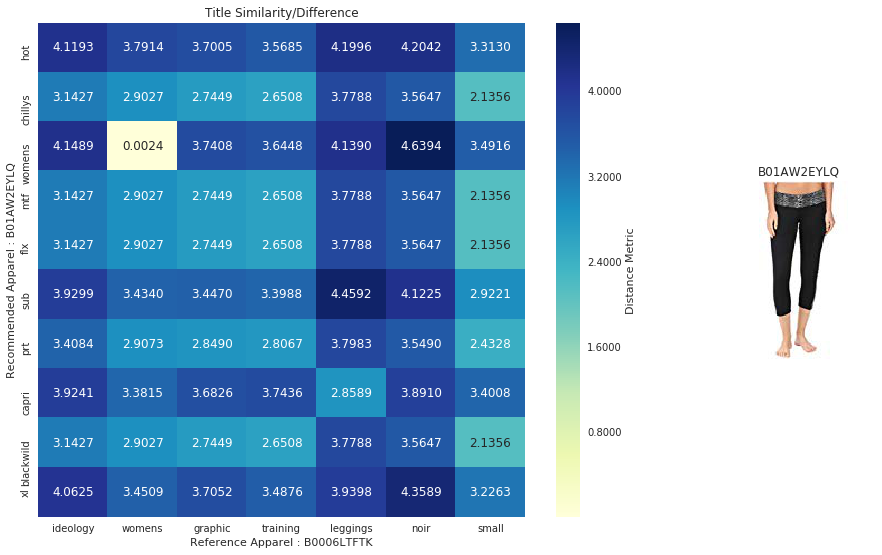





Recommended Product 4 Information :

ASIN:	 B016MM3QZA
Brand: 	 Innovateyfm
Color: 	 Black
Price:	 $12.18

Description Summary: 

 innovateyfm womens oneck floral lace crochet long sleeve pullover top blouse  



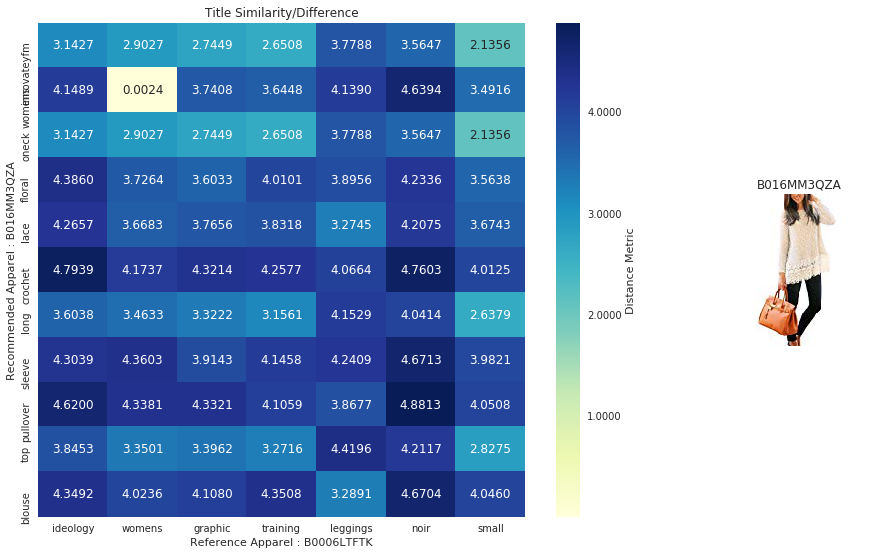





Recommended Product 5 Information :

ASIN:	 B0049B3RJ2
Brand: 	 David Lerner
Color: 	 Grey
Price:	 $90.00

Description Summary: 

 david lerner womens button henley top grey small  



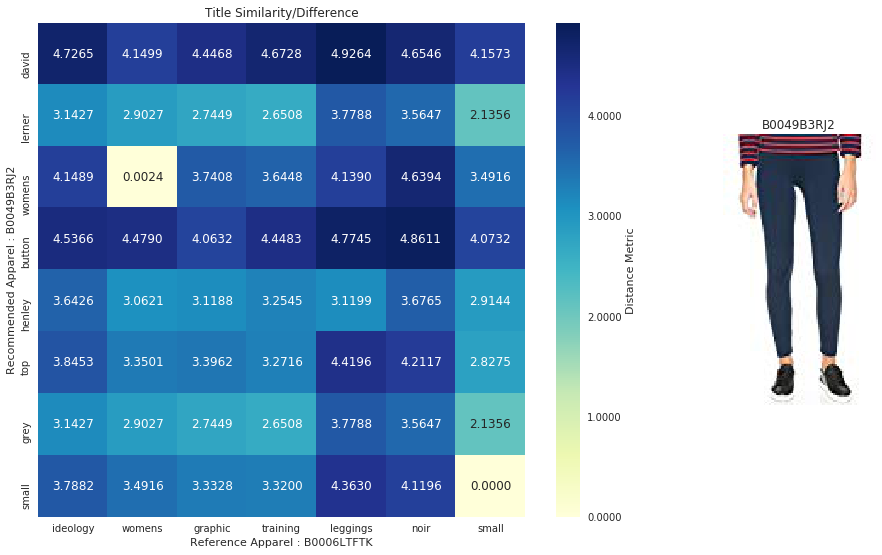





Recommended Product 6 Information :

ASIN:	 B01MSBXFQP
Brand: 	 Denim Supply ralph Lauren
Color: 	 Cream
Price:	 $42.86

Description Summary: 

 denim  supply ralph lauren womens crochet fringe vest beige  



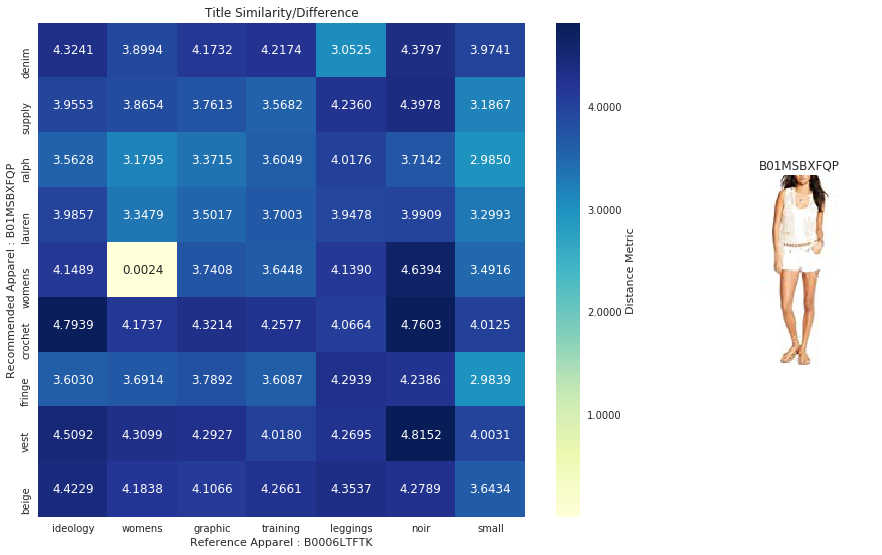





Recommended Product 7 Information :

ASIN:	 B072BNSWJC
Brand: 	 Cupio
Color: 	 Heather Gray
Price:	 $58.00

Description Summary: 

 cupio womens highlow top heather gray size medium  



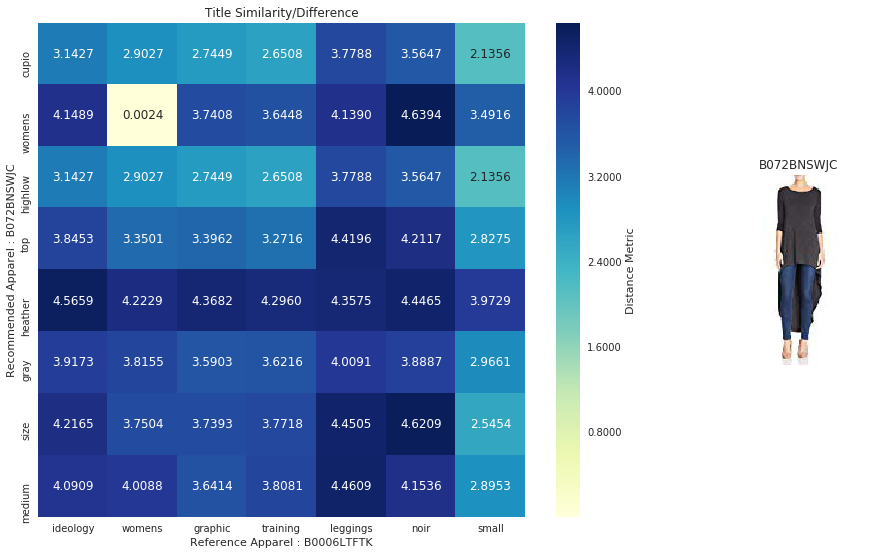





Recommended Product 8 Information :

ASIN:	 B01D9QN5PI
Brand: 	 Glamorous
Color: 	 Navy Red Stripe
Price:	 $78.97

Description Summary: 

 glamorous womens womans top striped print size blue  



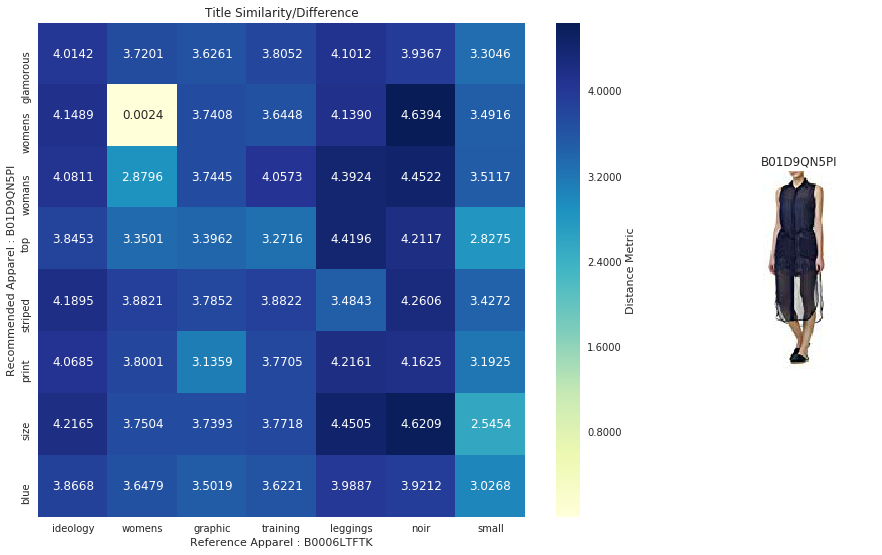




**************************************************
**************************************************
<--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><-->
Reference Image ... 



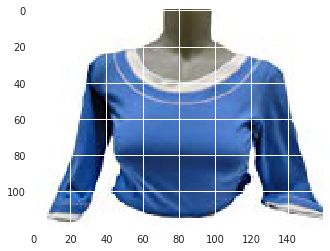

<--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><-->

Recommended Product 1 Information :

ASIN:	 B0097LQOOY
Brand: 	 Anna-Kaci
Color: 	 Blue
Price:	 $17.45

Description Summary: 

 annakaci sm fit blue casual pocket denim button shirt w long black sleeves  



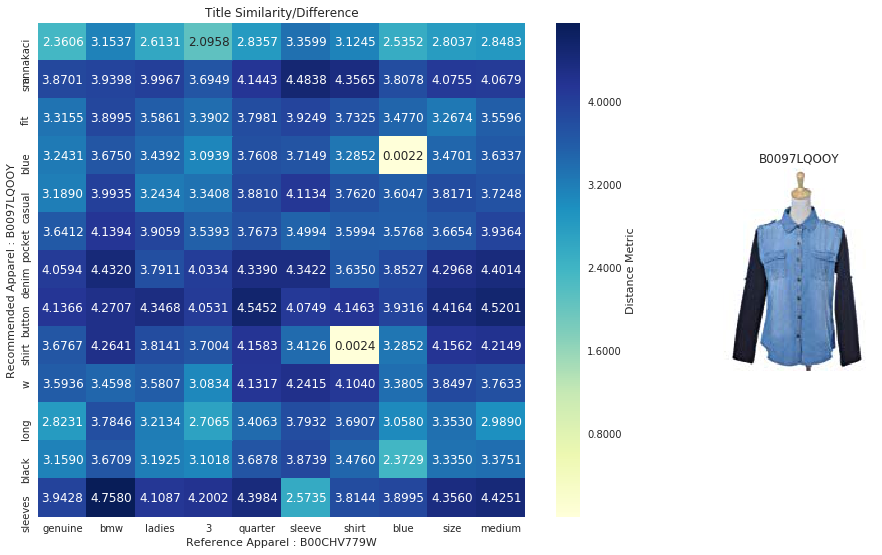





Recommended Product 2 Information :

ASIN:	 B07259CXMJ
Brand: 	 Talbots
Color: 	 Yellow
Price:	 $24.95

Description Summary: 

 talbots pima cotton v neck short sleeve tee shirt top yellow size x 1012  



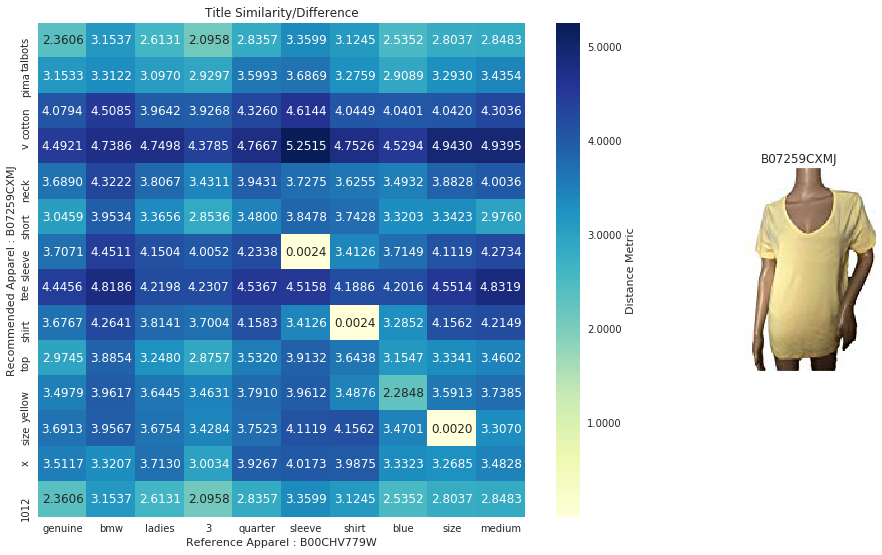





Recommended Product 3 Information :

ASIN:	 B06ZZ5W25N
Brand: 	 Ali & Kris
Color: 	 Multi Paisley
Price:	 $10.24

Description Summary: 

 ali  kris womens sheer long sleeve blouse large multi paisley  



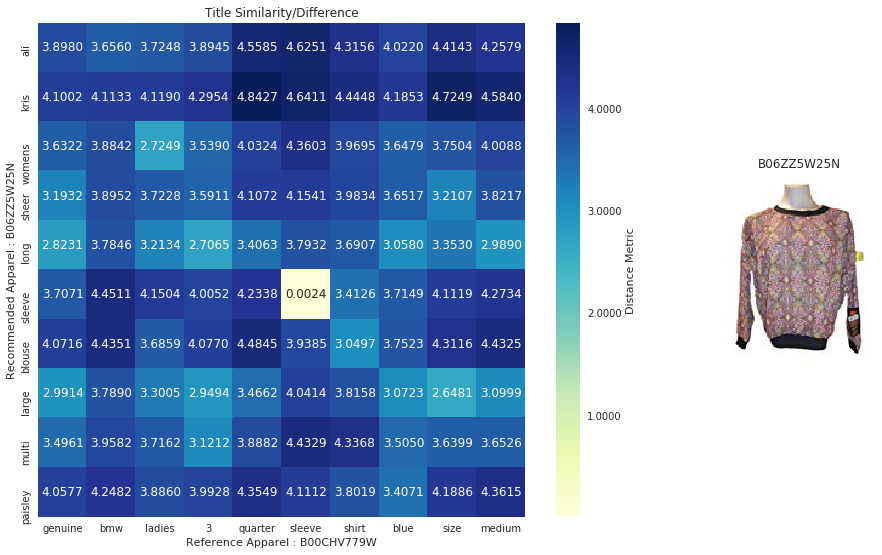





Recommended Product 4 Information :

ASIN:	 B06XH2N9SG
Brand: 	 Retro-ology
Color: 	 White
Price:	 $14.36

Description Summary: 

 retroology womens long sleeve top white small  



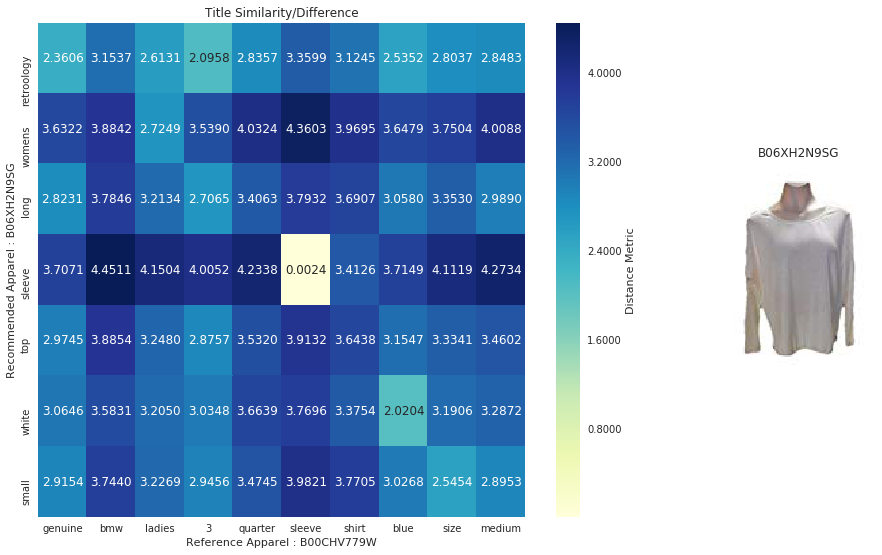





Recommended Product 5 Information :

ASIN:	 B074QKW262
Brand: 	 VS Pink
Color: 	 Teal
Price:	 $39.99

Description Summary: 

 victorias secret pink ultimate long sleeve shirt large teal  



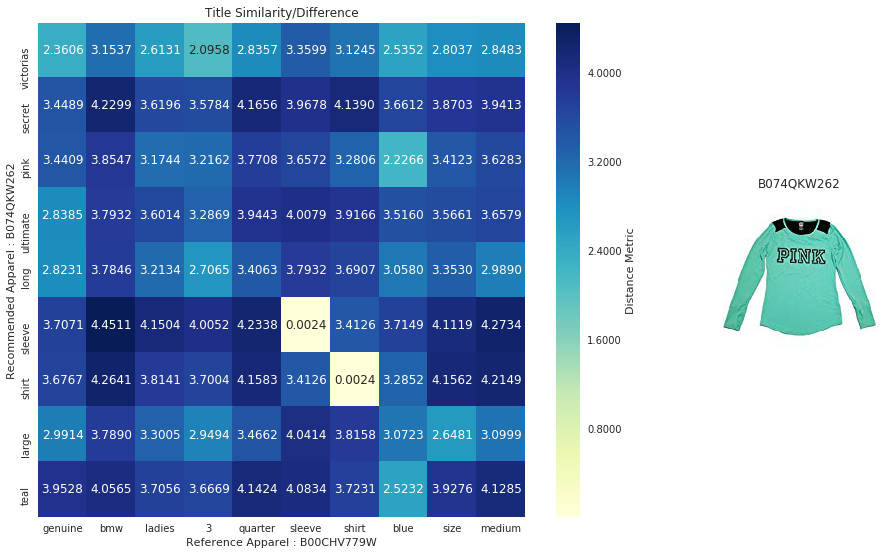





Recommended Product 6 Information :

ASIN:	 B006F8W9B4
Brand: 	 BMW
Color: 	 Blue
Price:	 $78.45

Description Summary: 

 bmw ladies longsleeve  light blue  small  



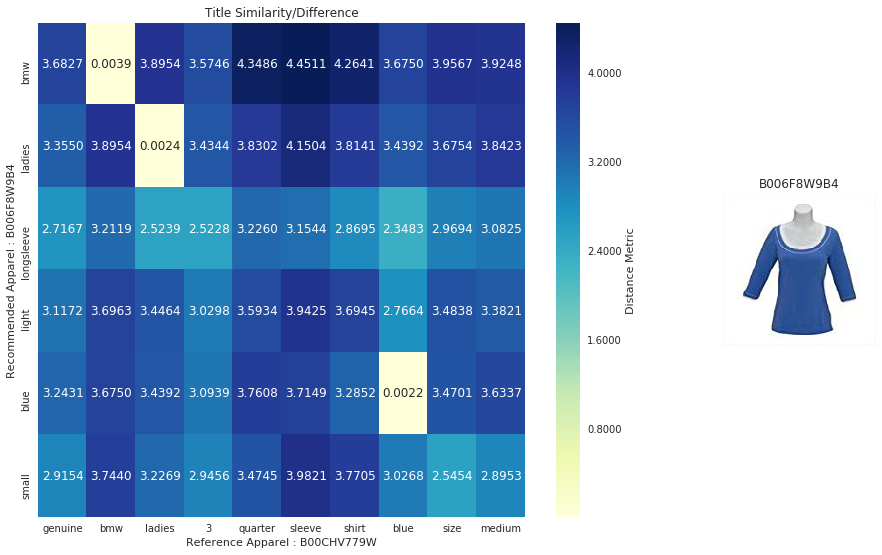





Recommended Product 7 Information :

ASIN:	 B003BSO7QG
Brand: 	 Van Heusen
Color: 	 English Blue
Price:	 $26.21

Description Summary: 

 van heusen ladies long sleeve pinpoint oxford english blue  large  



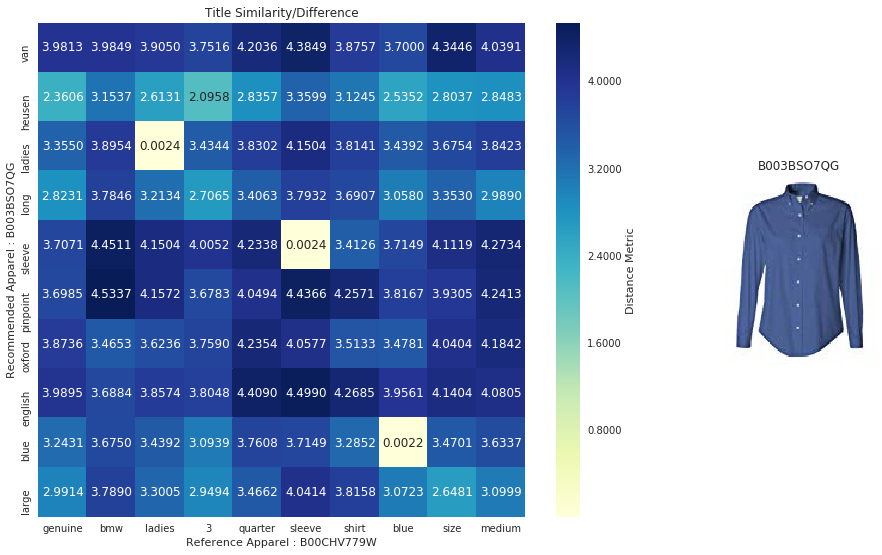





Recommended Product 8 Information :

ASIN:	 B071NLLVN7
Brand: 	 Mossimo
Color: 	 Light Wash
Price:	 $20.99

Description Summary: 

 mossimo womens soft denim button shirt xxl light wash  



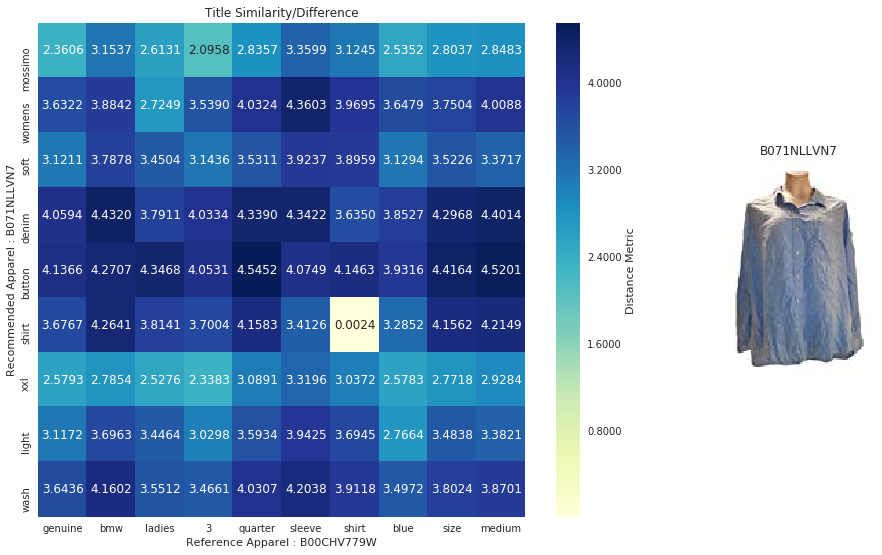




**************************************************
**************************************************
<--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><-->
Reference Image ... 



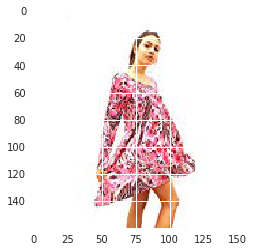

<--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><-->

Recommended Product 1 Information :

ASIN:	 B01M4OC17B
Brand: 	 Nene Leakes
Color: 	 Black White
Price:	 $29.00

Description Summary: 

 nene leakes lightweight draped flutter sleeve button top small  



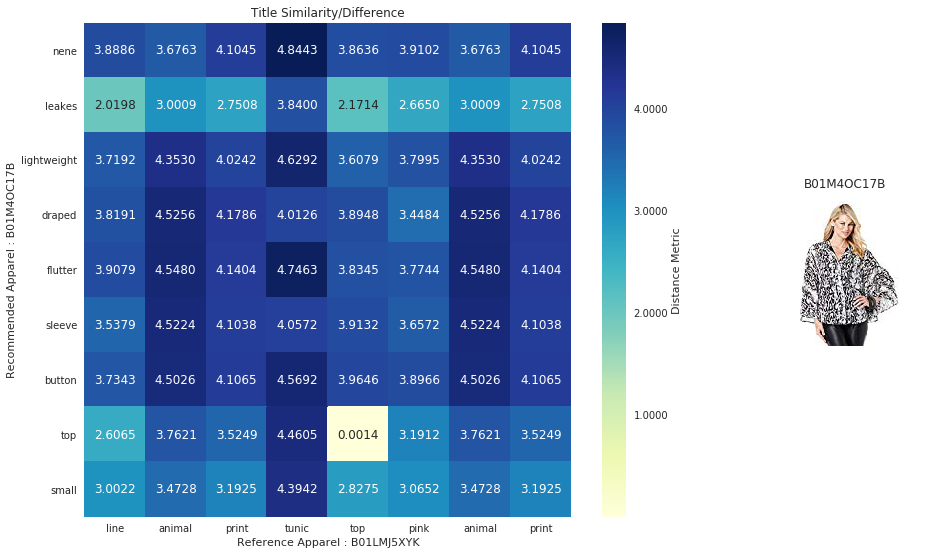





Recommended Product 2 Information :

ASIN:	 B06XCQYKN7
Brand: 	 UNION FASHION LTD
Color: 	 White/Navy
Price:	 $24.31

Description Summary: 

 fashion union womens windowpane shirt dress whitenavy stripe xlarge  



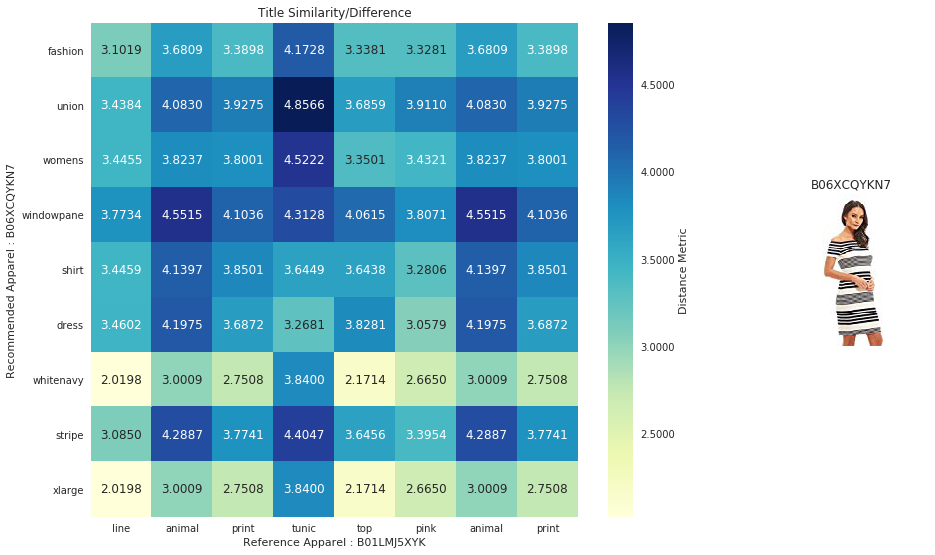





Recommended Product 3 Information :

ASIN:	 B010D310NO
Brand: 	 KATUO
Color: 	 White
Price:	 $16.90

Description Summary: 

 katuo womens see lace shirt deep vneck plus size white  



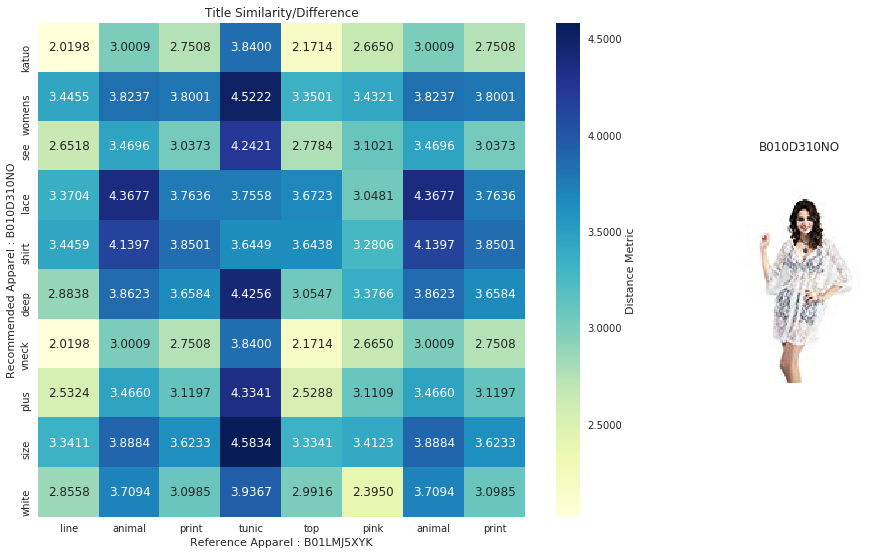





Recommended Product 4 Information :

ASIN:	 B01IV2EEAK
Brand: 	 KEEPFUNNY
Color: 	 Royal Blue
Price:	 $5.38

Description Summary: 

 keepfunny womens printed chiffon button kimono cardigan coat blouse cover free size royal blue  



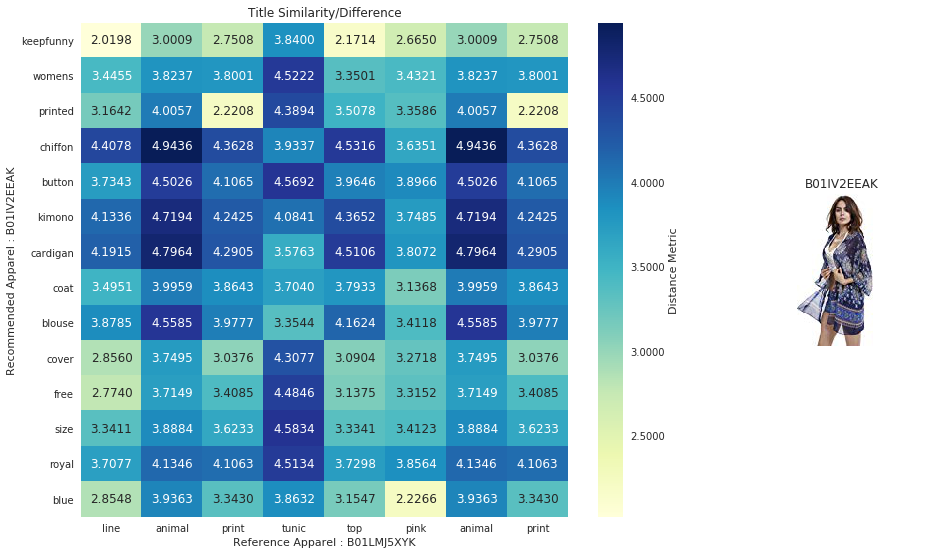





Recommended Product 5 Information :

ASIN:	 B074PQW2W3
Brand: 	 DLGLOBAL
Color: 	 Black
Price:	 $25.59

Description Summary: 

 women vintage floral embroidery sheer mesh dress long sleeve side split loose tunic blouse  



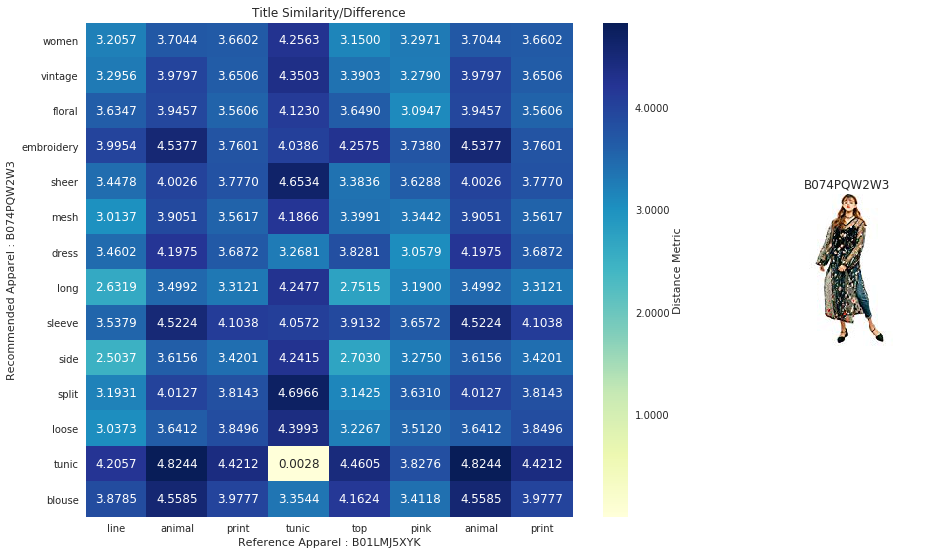





Recommended Product 6 Information :

ASIN:	 B06Y637BNJ
Brand: 	 Romacci
Color: 	 Standard
Price:	 $9.69

Description Summary: 

 romacci women knitted long tank top ribbed fringe sleeveless tassel casual mini dress brown  



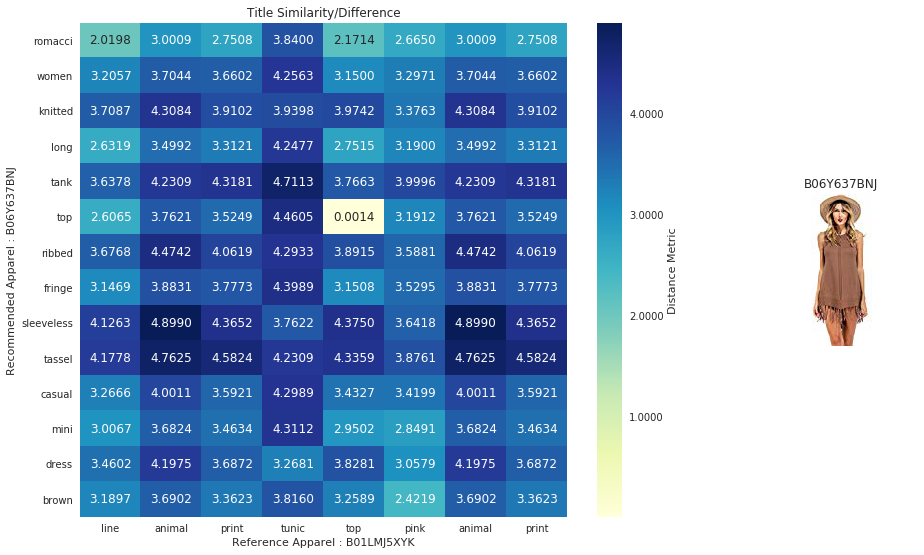





Recommended Product 7 Information :

ASIN:	 B074WL13DQ
Brand: 	 Liz Claiborne New York
Color: 	 Black
Price:	 $27.98

Description Summary: 

 liz claiborne ny 34 slv striped tee keyhole a262180 black l  



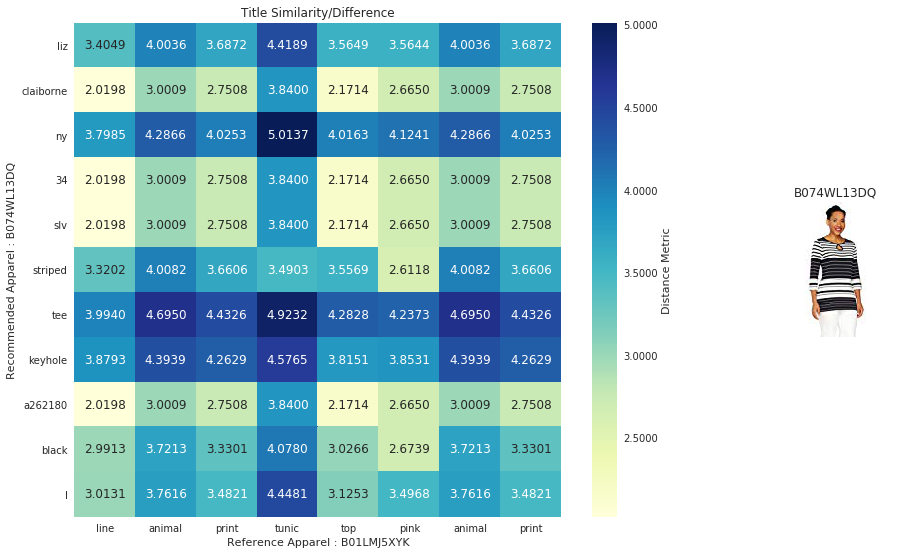





Recommended Product 8 Information :

ASIN:	 B01LX0BW3U
Brand: 	 Mossimo
Color: 	 Light Pink
Price:	 $15.05

Description Summary: 

 mossimo womens vneck pullover xlarge light pink  



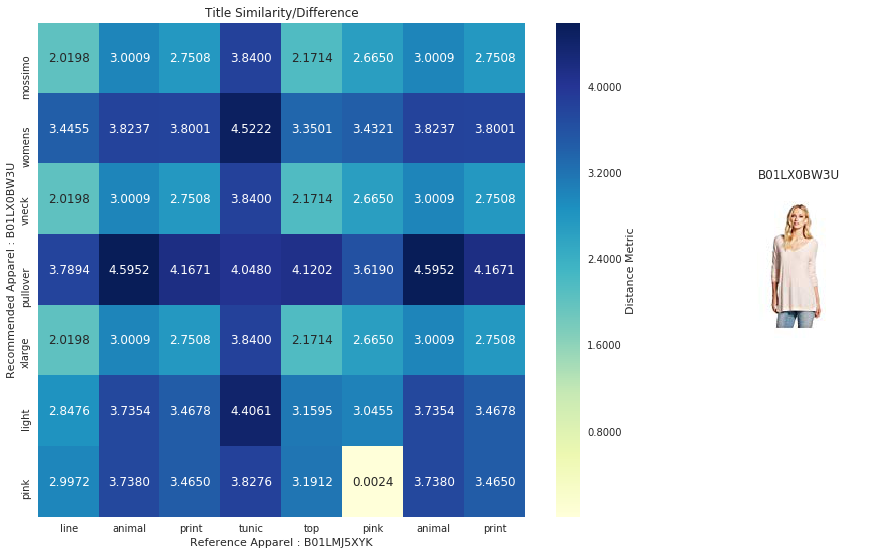




**************************************************
**************************************************
<--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><-->
Reference Image ... 



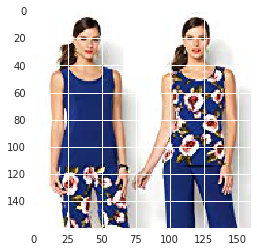

<--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><-->

Recommended Product 1 Information :

ASIN:	 B01N4V02YR
Brand: 	 Iman
Color: 	 Ruby Red
Price:	 $24.99

Description Summary: 

 iman global chic simply glamorous top large red  



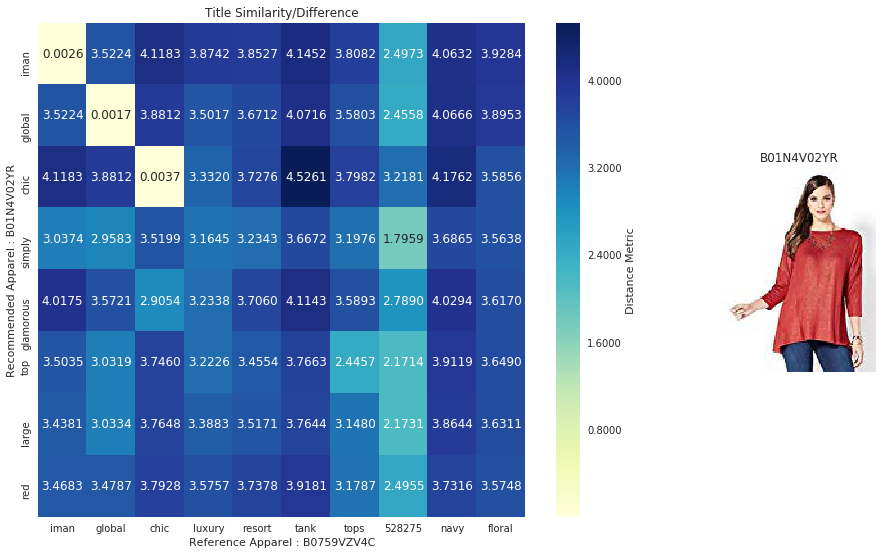





Recommended Product 2 Information :

ASIN:	 B01MAZENNL
Brand: 	 Iman
Color: 	 Ruby Red
Price:	 $77.77

Description Summary: 

 iman global chic simply glamorous top sparkling jewelry set medium red  



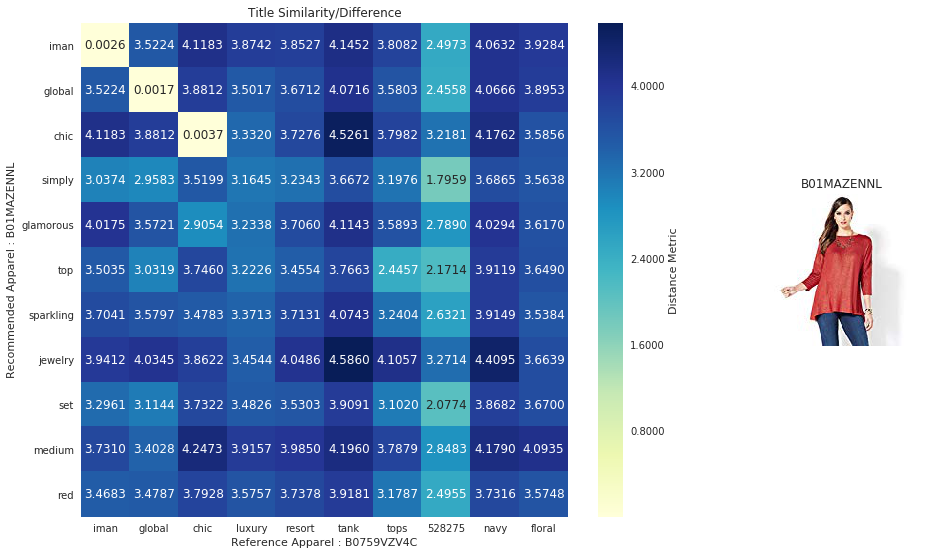





Recommended Product 3 Information :

ASIN:	 B074Q331SN
Brand: 	 City Chic
Color: 	 Ivory
Price:	 $38.92

Description Summary: 

 city chic womens trendy plus size laceback blouse xxl24w ivory  



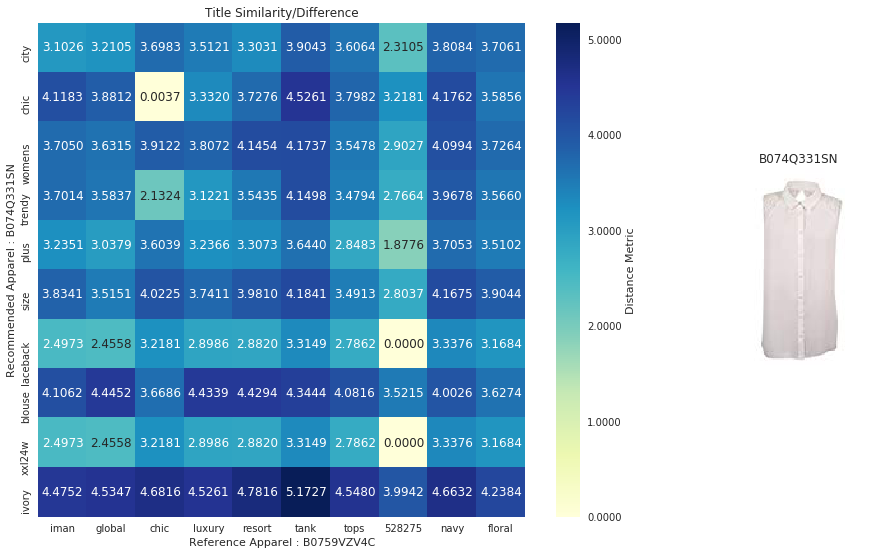





Recommended Product 4 Information :

ASIN:	 B074LTBXR5
Brand: 	 Sharif
Color: 	 Pink
Price:	 $21.56

Description Summary: 

 sharif floral print top beading luxe slv 319237 pink  



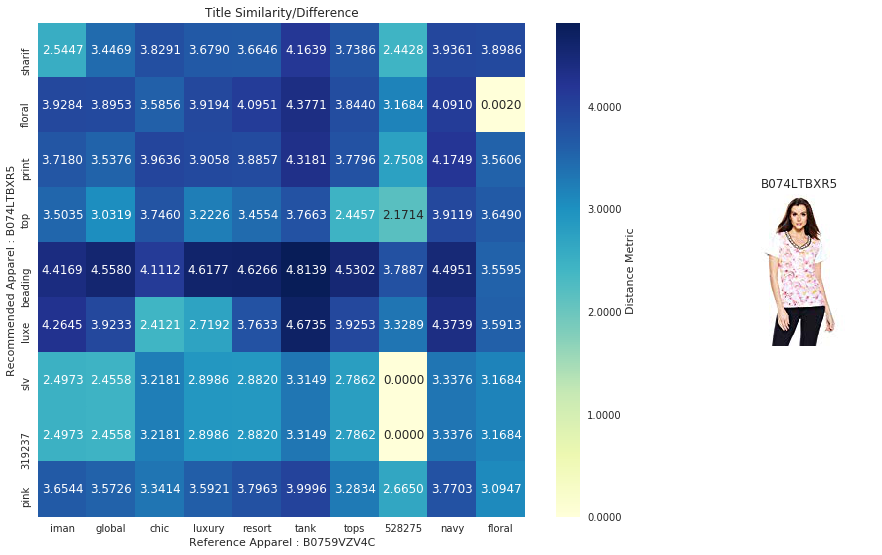





Recommended Product 5 Information :

ASIN:	 B01MFBK5YK
Brand: 	 City Chic
Color: 	 Mid Denim
Price:	 $43.45

Description Summary: 

 designer plus size shirt miss military  mid denim  18   city chic  



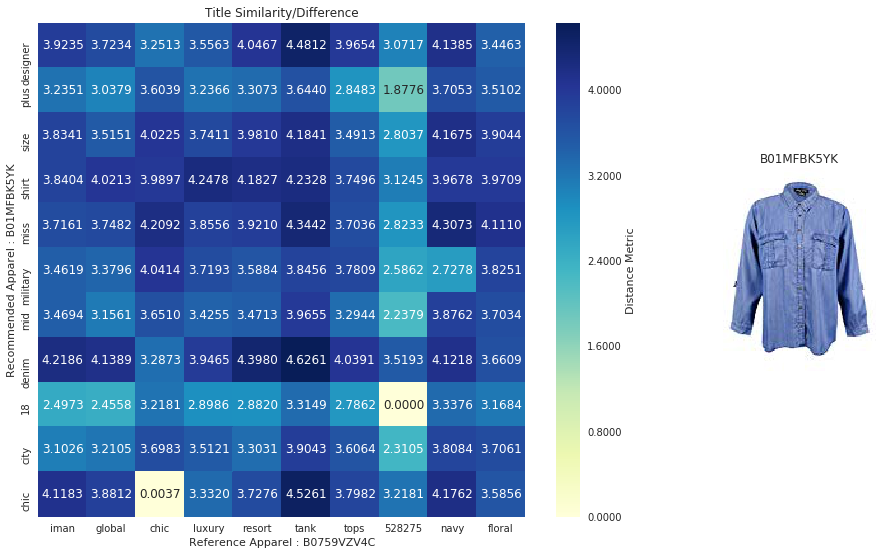





Recommended Product 6 Information :

ASIN:	 B0749SKMHN
Brand: 	 Marina Rinaldi by Max Mara
Color: 	 Navy/Grey
Price:	 $254.15

Description Summary: 

 marina rinaldi womens febo floral sheer sleeve blouse 18w  27 navy  



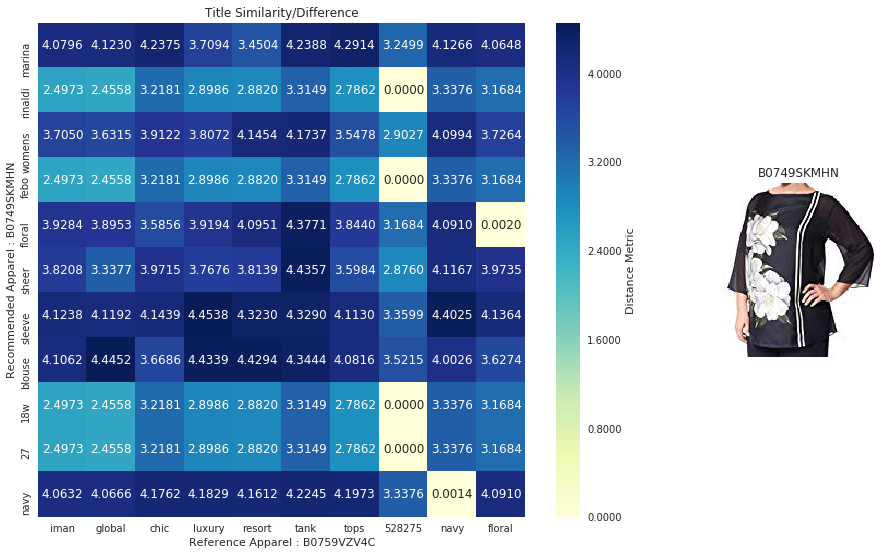





Recommended Product 7 Information :

ASIN:	 B0756SDB5J
Brand: 	 Liz Claiborne
Color: 	 Luxury Blue Multi
Price:	 $17.99

Description Summary: 

 liz claiborne splitneck tank top size l new luxury blue multi  



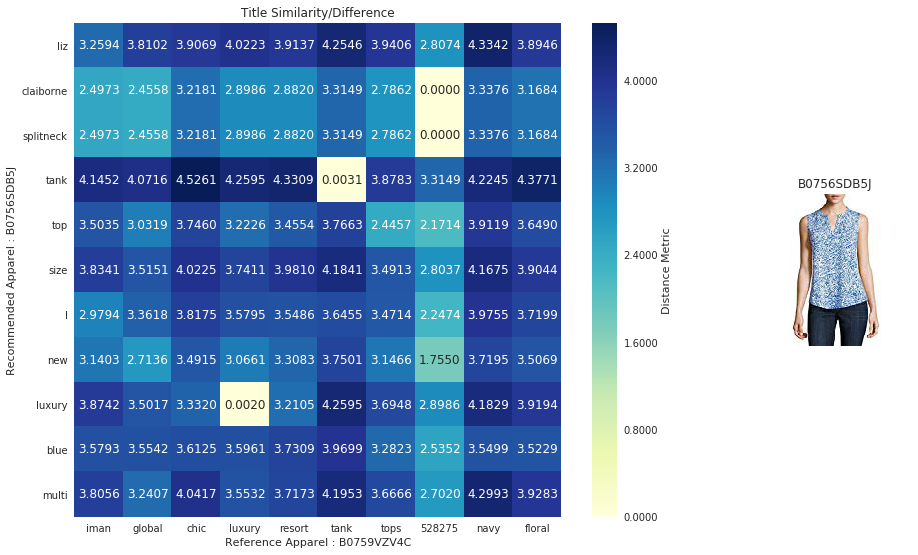





Recommended Product 8 Information :

ASIN:	 B01M3V2T6O
Brand: 	 City Chic
Color: 	 Metallic
Price:	 $19.99

Description Summary: 

 designer plus size tank cut racer  ivory  20  l  city chic  



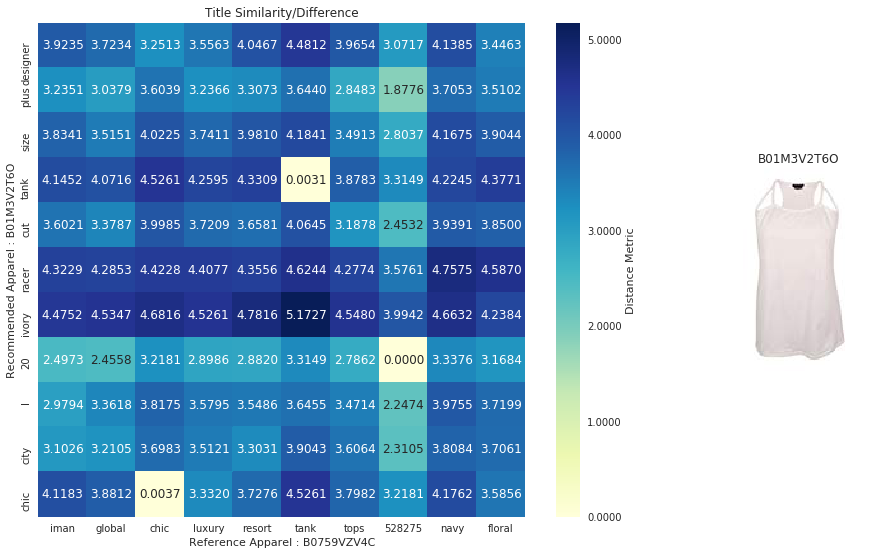




**************************************************
**************************************************
<--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><-->
Reference Image ... 



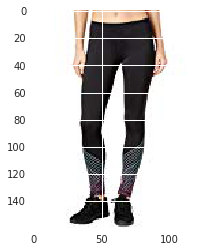

<--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><-->

Recommended Product 1 Information :

ASIN:	 B06XGKG7HP
Brand: 	 R KON
Color: 	 Yellow
Price:	 $5.25

Description Summary: 

 sleeveless strappy plain swing summer top cami fashion vest yellow us 46  



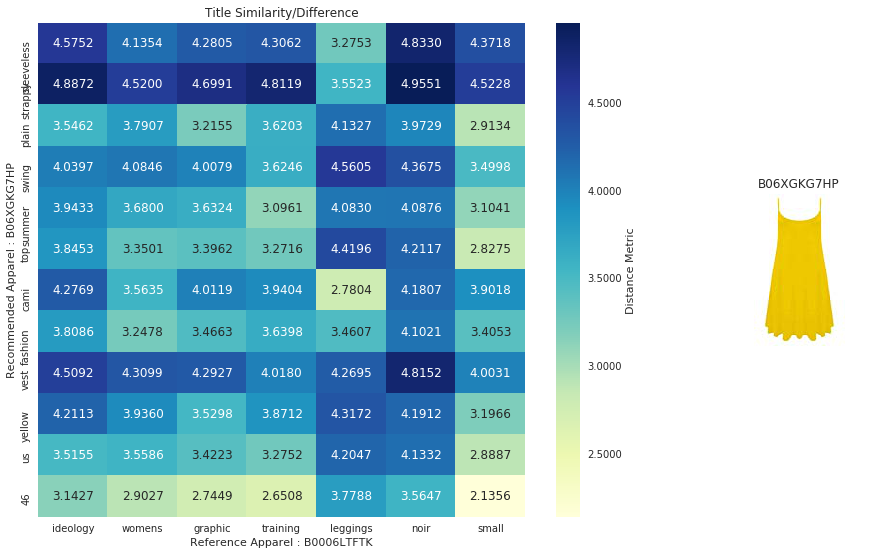





Recommended Product 2 Information :

ASIN:	 B01MFDNJZ8
Brand: 	 Ideology
Color: 	 Noir Spacedye
Price:	 $8.02

Description Summary: 

 ideology raglan spaceddyed longsleeve top size xs  



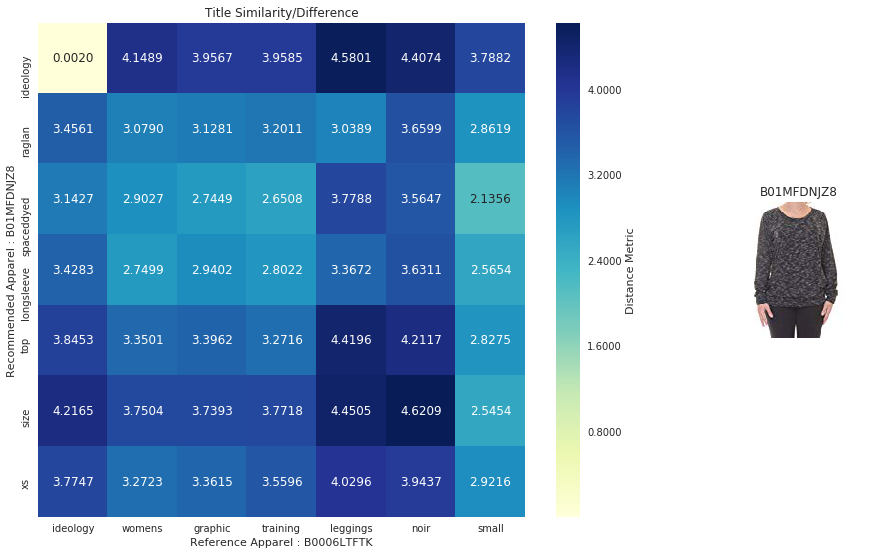





Recommended Product 3 Information :

ASIN:	 B0733N835L
Brand: 	 Ideology
Color: 	 Blue
Price:	 $26.95

Description Summary: 

 ideology womens run ombre racerback tank top blue xlarge  



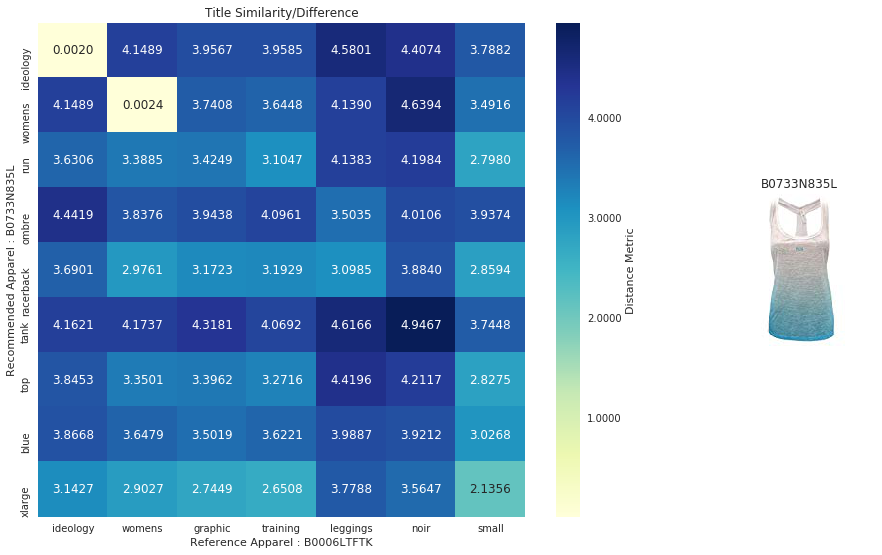





Recommended Product 4 Information :

ASIN:	 B06XKBKYQC
Brand: 	 Denim & Supply
Color: 	 Gray
Price:	 $29.99

Description Summary: 

 denim  supply drapey graphic tshirt size l  



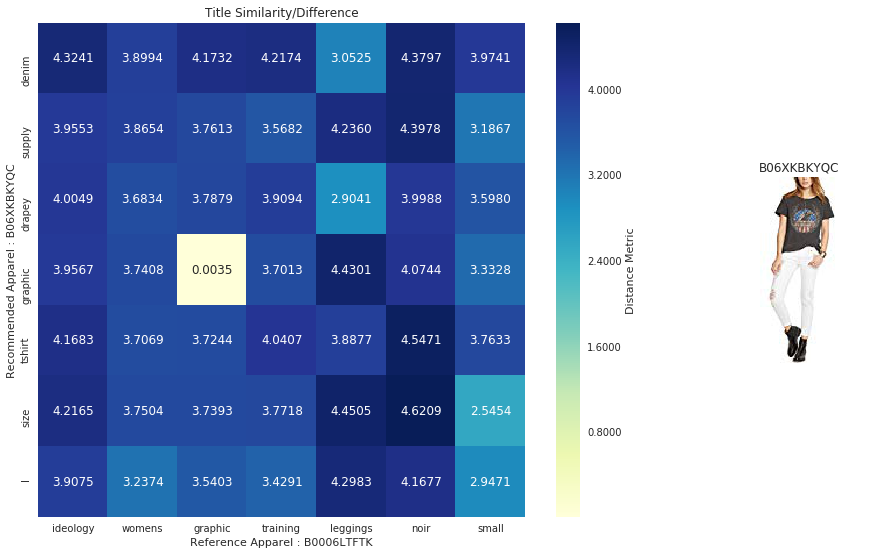





Recommended Product 5 Information :

ASIN:	 B073YDZTJL
Brand: 	 Material Girl
Color: 	 Noir
Price:	 $13.75

Description Summary: 

 material girl noir black laceinset crop tank top noir  



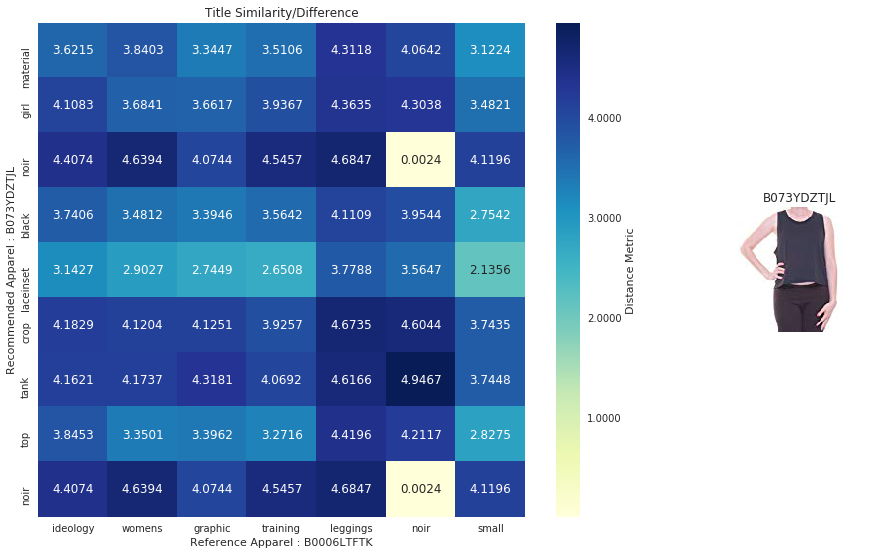





Recommended Product 6 Information :

ASIN:	 B01MSBXFQP
Brand: 	 Denim Supply ralph Lauren
Color: 	 Cream
Price:	 $42.86

Description Summary: 

 denim  supply ralph lauren womens crochet fringe vest beige  



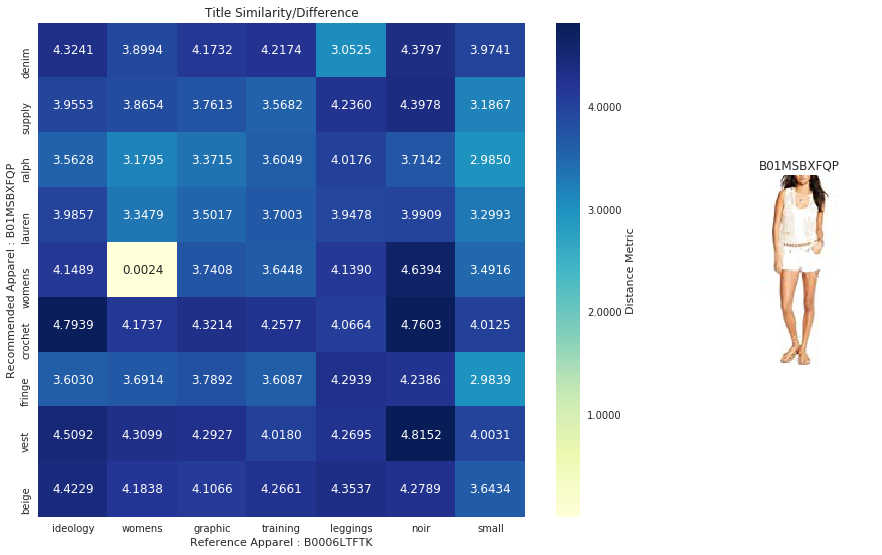





Recommended Product 7 Information :

ASIN:	 B0132X264E
Brand: 	 TOOGOO(R)
Color: 	 Black
Price:	 $9.57

Description Summary: 

 toogoornew spring women crochet blouse lace shirt women clothing basic shirt vintage blouses  shirtsblackxxxl  



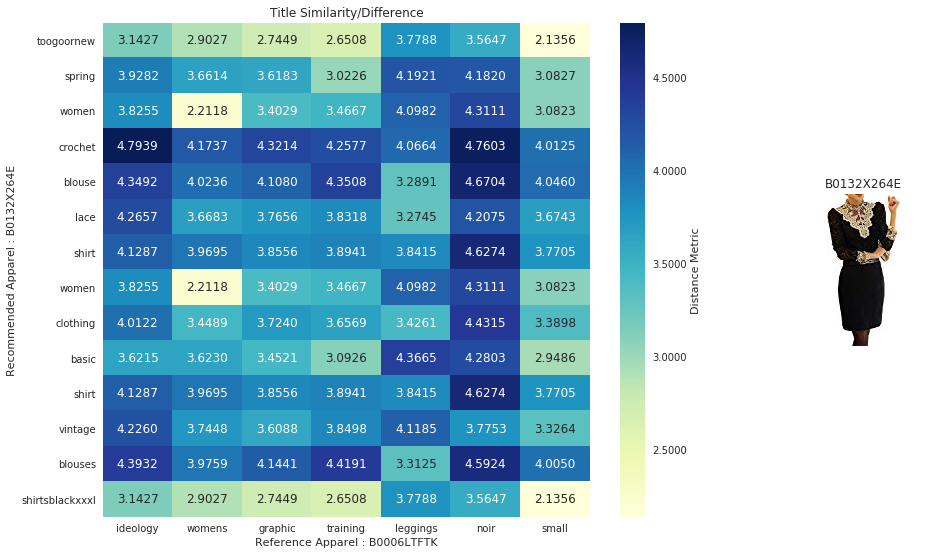





Recommended Product 8 Information :

ASIN:	 B073NYKGRL
Brand: 	 TOOGOO(R)
Color: 	 White
Price:	 $8.43

Description Summary: 

 toogoor summer style women chiffon sexy tops neck sleeveless fashion solid fitness casual vest topswhitexlus10uk14  



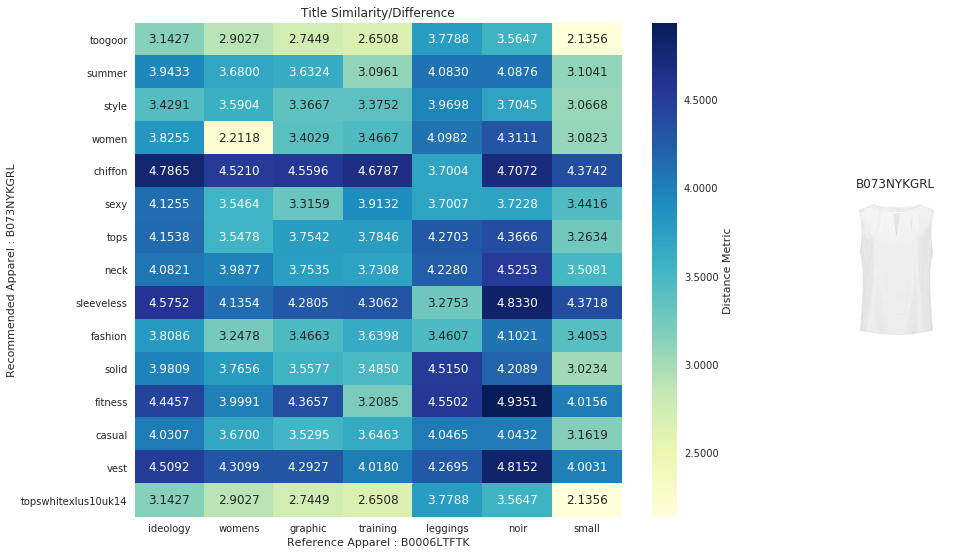




**************************************************
**************************************************
<--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><-->
Reference Image ... 



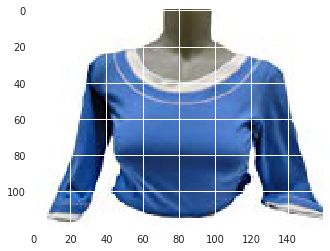

<--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><-->

Recommended Product 1 Information :

ASIN:	 B01MYM47TA
Brand: 	 Esprit
Color: 	 044 Light Grey
Price:	 $86.90

Description Summary: 

 esprit womens womens grey long sleeve top print size xs grey  



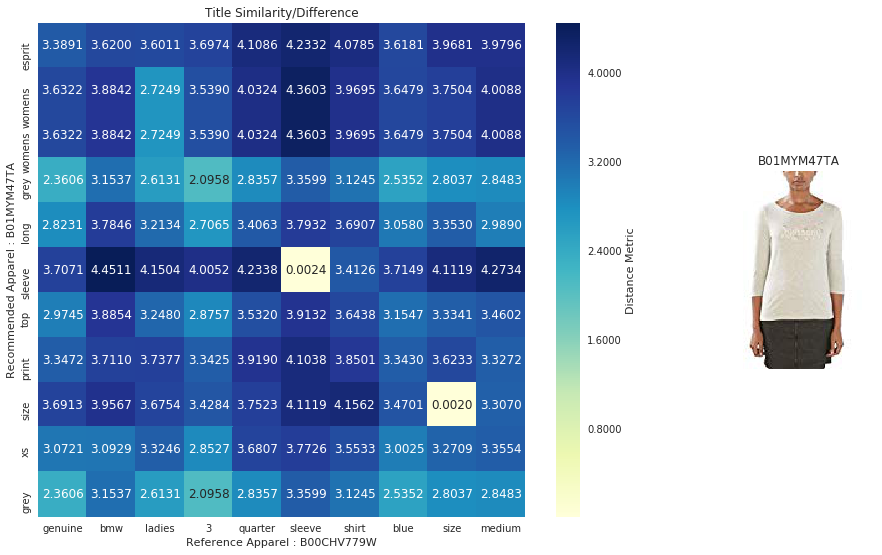





Recommended Product 2 Information :

ASIN:	 B018EB3Q34
Brand: 	 Juntong
Color: 	 Black 1
Price:	 $13.59

Description Summary: 

 sunshy womens casual long sleeve plus size top tshirts black xxl  



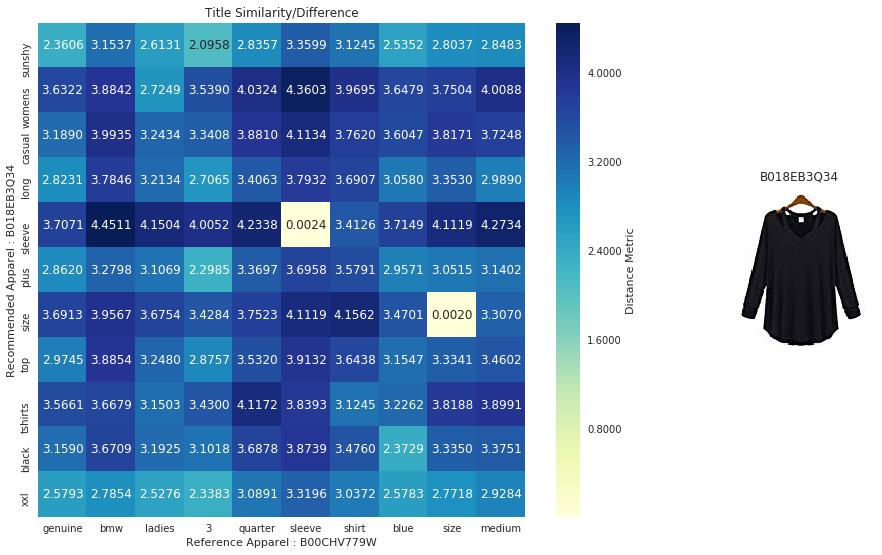





Recommended Product 3 Information :

ASIN:	 B07259CXMJ
Brand: 	 Talbots
Color: 	 Yellow
Price:	 $24.95

Description Summary: 

 talbots pima cotton v neck short sleeve tee shirt top yellow size x 1012  



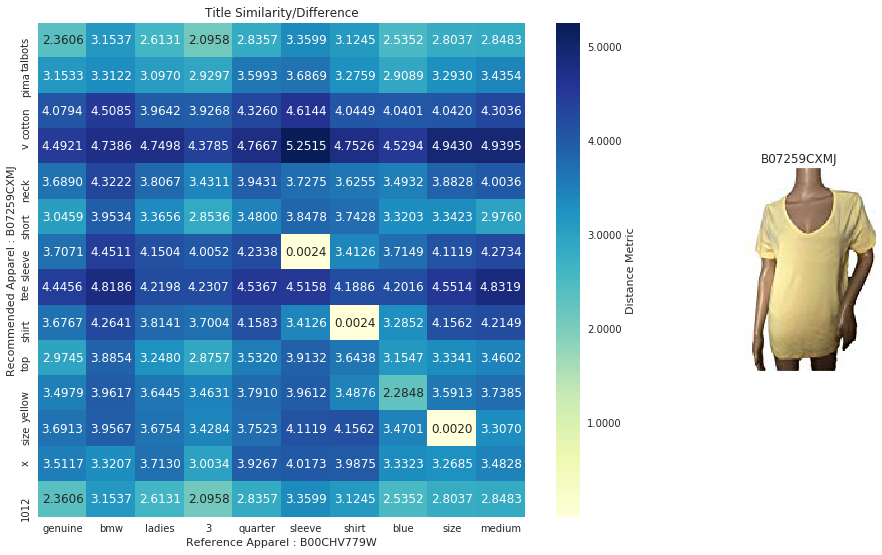





Recommended Product 4 Information :

ASIN:	 B015LLSRX4
Brand: 	 NY Collection
Color: 	 Red
Price:	 $29.70

Description Summary: 

 ny collection plus size long sleeve sequin top 2x red  



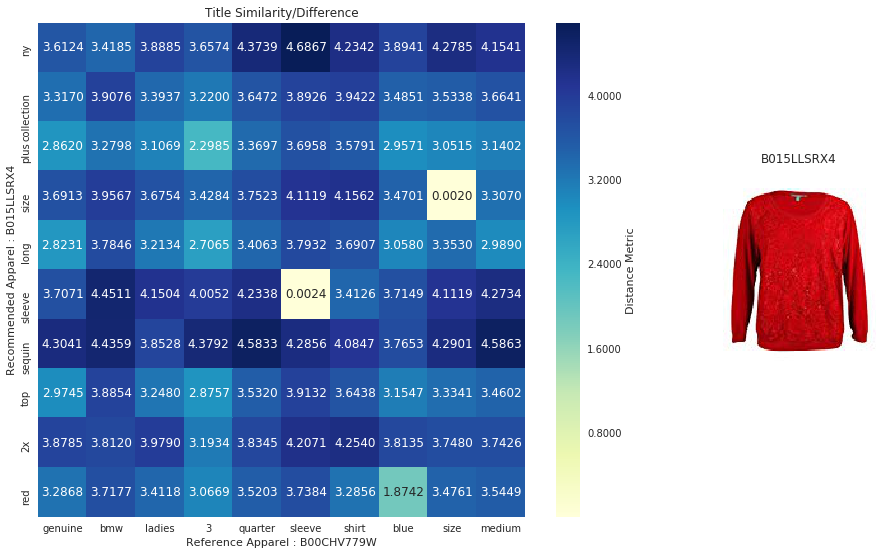





Recommended Product 5 Information :

ASIN:	 B06XH2N9SG
Brand: 	 Retro-ology
Color: 	 White
Price:	 $14.36

Description Summary: 

 retroology womens long sleeve top white small  



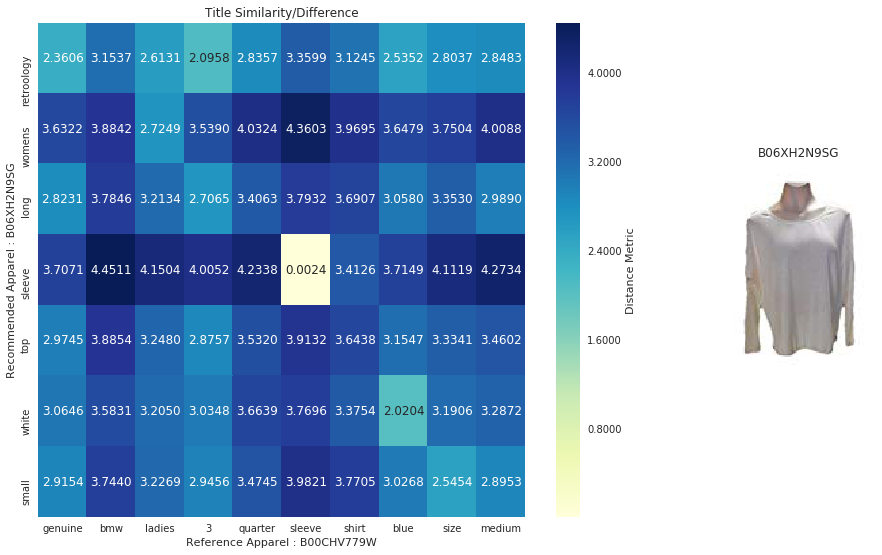





Recommended Product 6 Information :

ASIN:	 B0184ROP6A
Brand: 	 Elizabeth McKay
Color: 	 Red
Price:	 $32.99

Description Summary: 

 elizabeth mckay womens short sleeve button tee medium red  



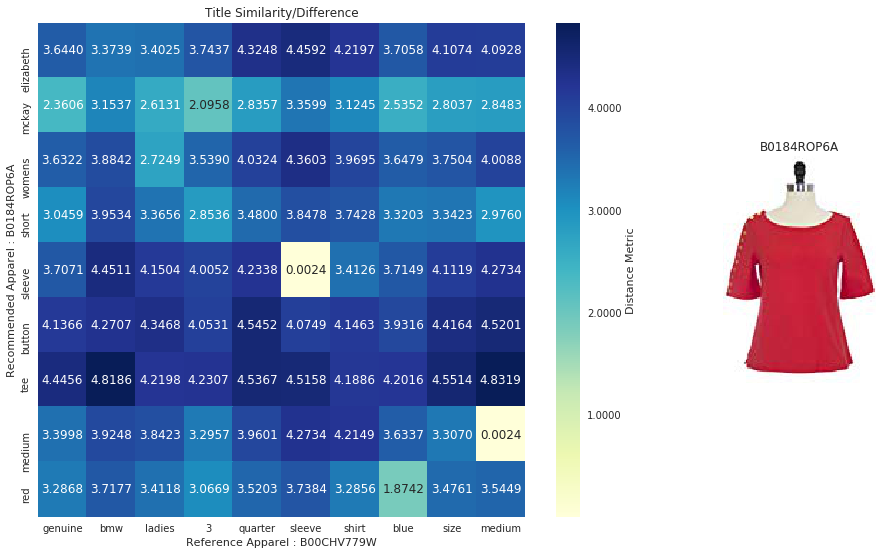





Recommended Product 7 Information :

ASIN:	 B01JN905DA
Brand: 	 BODEN
Color: 	 Green
Price:	 $48.97

Description Summary: 

 boden womens printed sheer vintage blouse us sz 18 green  



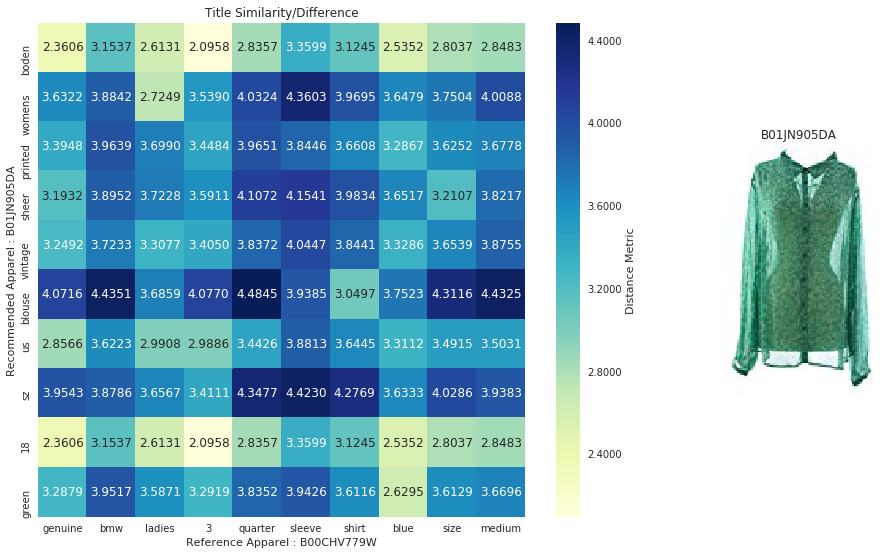





Recommended Product 8 Information :

ASIN:	 B006F8W9B4
Brand: 	 BMW
Color: 	 Blue
Price:	 $78.45

Description Summary: 

 bmw ladies longsleeve  light blue  small  



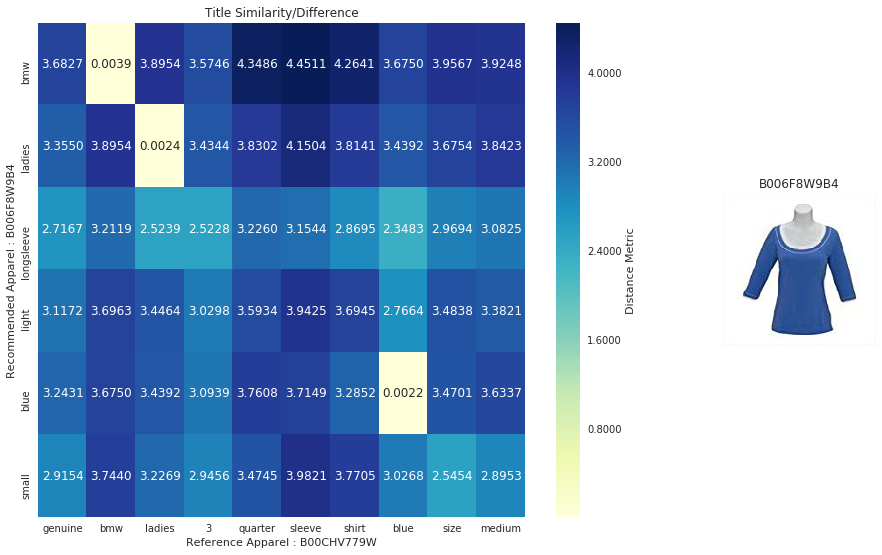




**************************************************
**************************************************
<--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><-->
Reference Image ... 



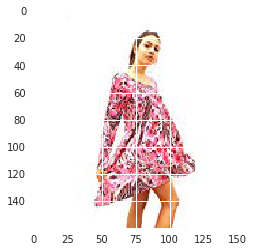

<--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><-->

Recommended Product 1 Information :

ASIN:	 B01N4QQMBJ
Brand: 	 BASICOJ
Color: 	 Gray
Price:	 $17.99

Description Summary: 

 basicoj womens turtle neck long sleeve leopard animal print top  



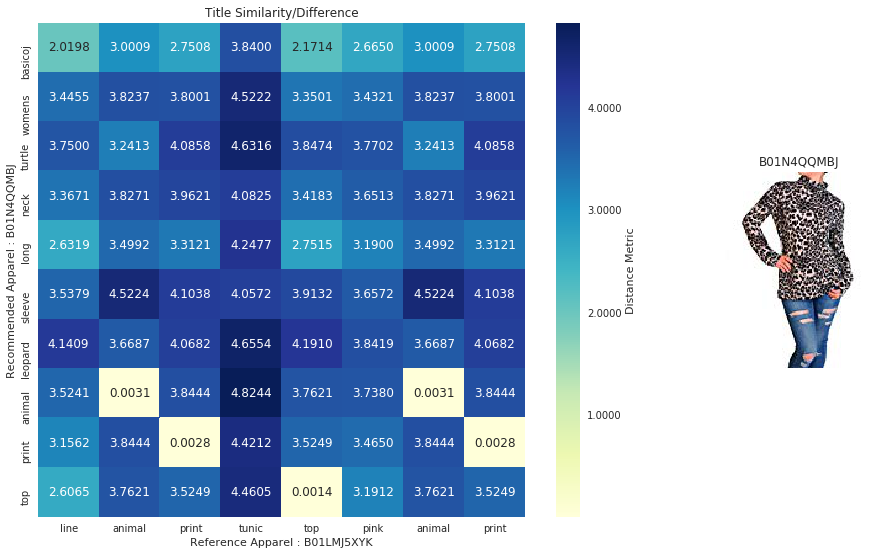





Recommended Product 2 Information :

ASIN:	 B074QV7PCM
Brand: 	 Brazen
Color: 	 Gray
Price:	 $18.99

Description Summary: 

 brazen womens one animal print embellished blouse gray one size  



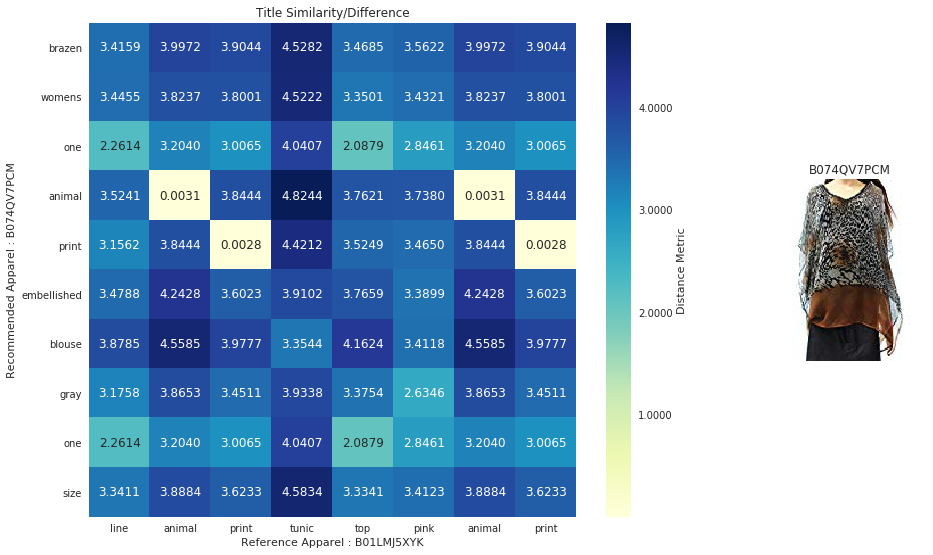





Recommended Product 3 Information :

ASIN:	 B008064F0W
Brand: 	 Verty
Color: 	 Pink
Price:	 $16.49

Description Summary: 

 pink yellow  black animal print aline pleated sleeveless top  



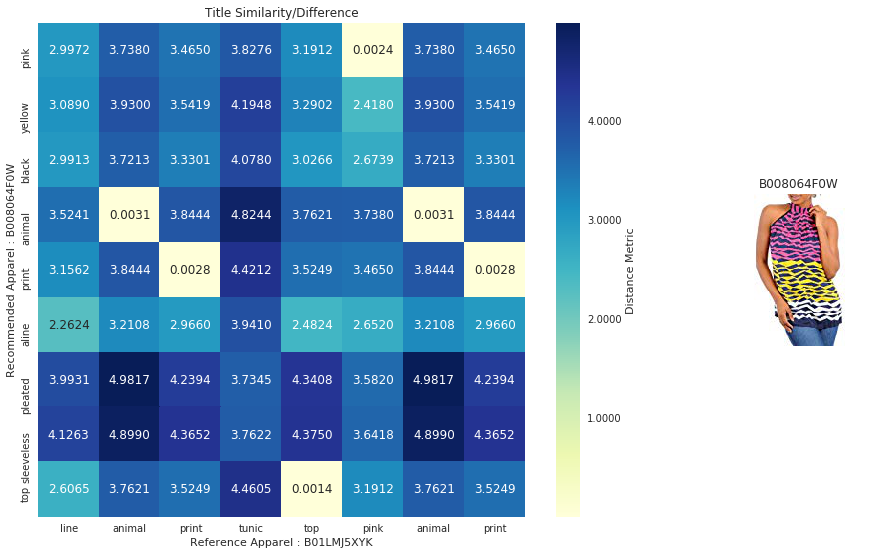





Recommended Product 4 Information :

ASIN:	 B00GX3NO74
Brand: 	 Demarkt
Color: 	 Leopard
Price:	 $10.77

Description Summary: 

 demarkt womens sexy animal leopard print long sleeve blouse  



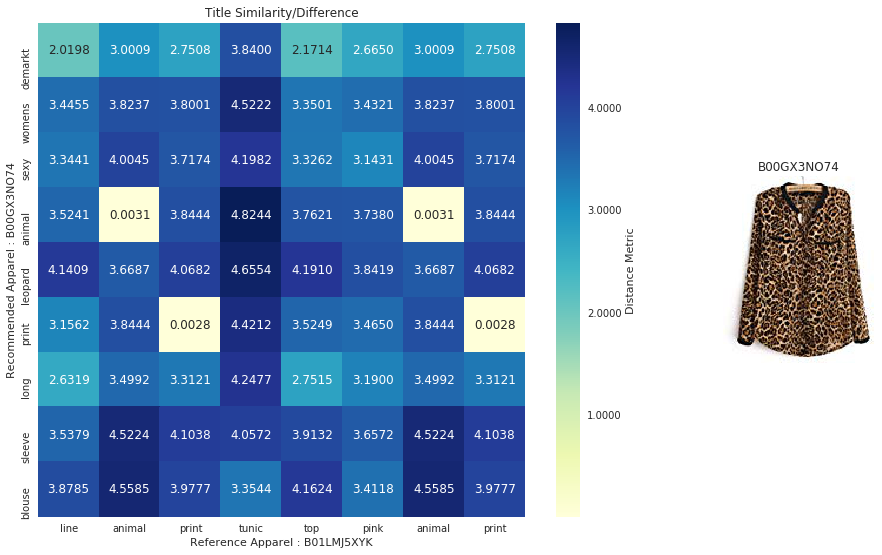





Recommended Product 5 Information :

ASIN:	 B0756L6MTG
Brand: 	 Salvatore Ferragamo
Color: 	 Black/Lavender
Price:	 $149.00

Description Summary: 

 salvatore ferragamo animal print tshirt l  



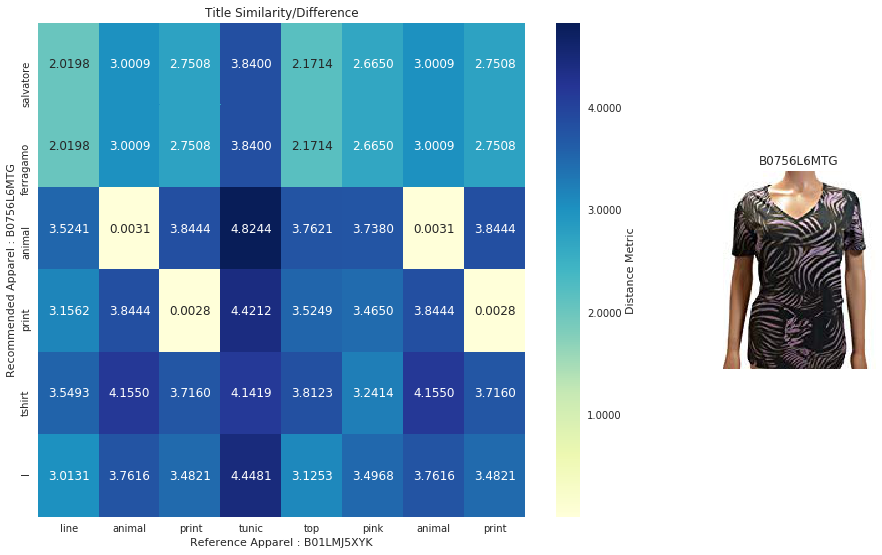





Recommended Product 6 Information :

ASIN:	 B01F2UDTFA
Brand: 	 White Stag
Color: 	 Beige Animal
Price:	 $16.99

Description Summary: 

 white stag womens smock bottom print top beige animal small 46 7  



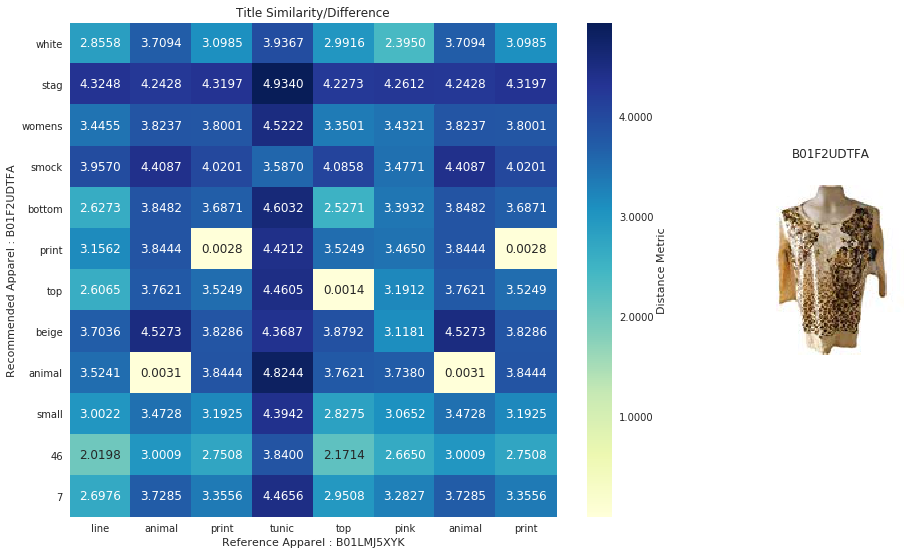





Recommended Product 7 Information :

ASIN:	 B01FRD1JMC
Brand: 	 style&co
Color: 	 Blk/Mgh
Price:	 $36.00

Description Summary: 

 styleco women animal print sweatshirt plus size 0x blkmgh  



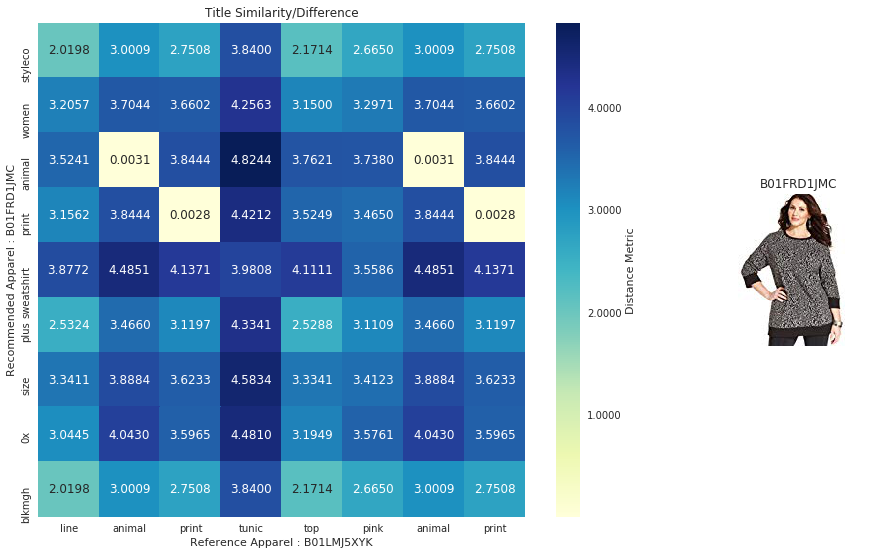





Recommended Product 8 Information :

ASIN:	 B0752V3Z7N
Brand: 	 Two by Vince Camuto
Color: 	 Gray
Price:	 $37.03

Description Summary: 

 two vince camuto womens medium animal print blouse gray  



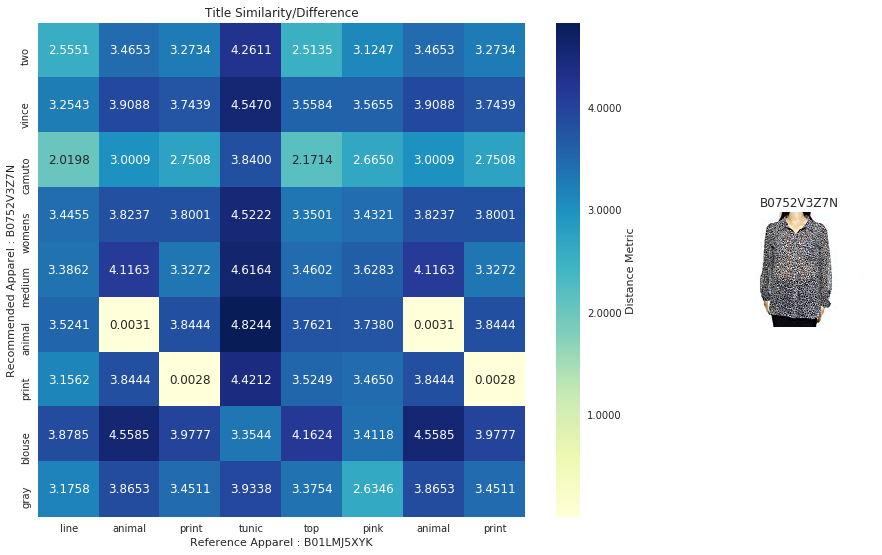




**************************************************
**************************************************
<--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><-->
Reference Image ... 



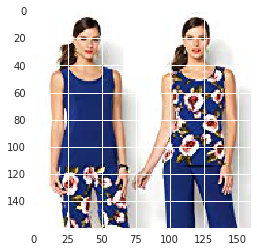

<--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><-->

Recommended Product 1 Information :

ASIN:	 B01N4V02YR
Brand: 	 Iman
Color: 	 Ruby Red
Price:	 $24.99

Description Summary: 

 iman global chic simply glamorous top large red  



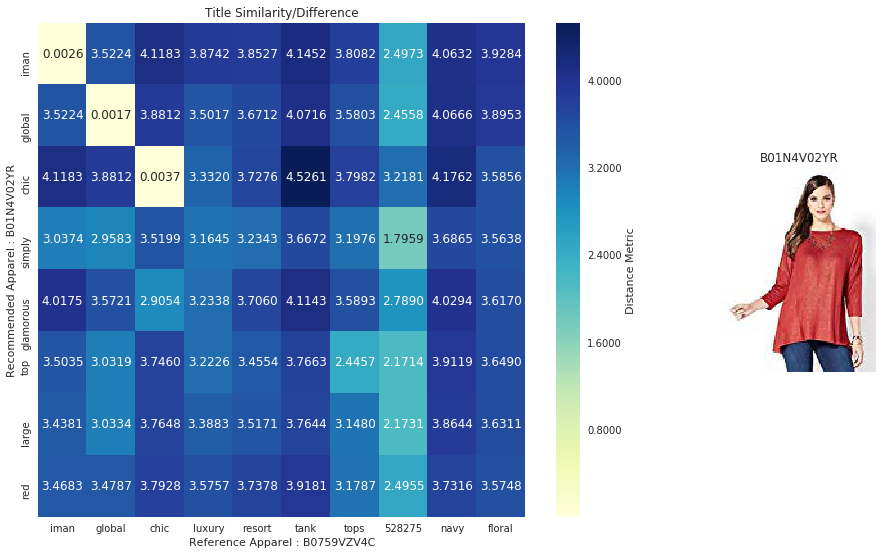





Recommended Product 2 Information :

ASIN:	 B01MAZENNL
Brand: 	 Iman
Color: 	 Ruby Red
Price:	 $77.77

Description Summary: 

 iman global chic simply glamorous top sparkling jewelry set medium red  



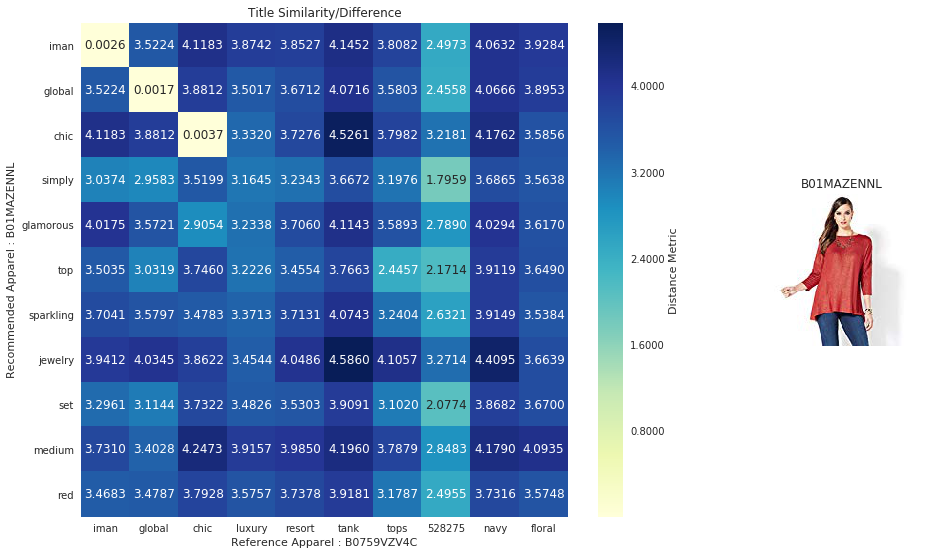





Recommended Product 3 Information :

ASIN:	 B074Q331SN
Brand: 	 City Chic
Color: 	 Ivory
Price:	 $38.92

Description Summary: 

 city chic womens trendy plus size laceback blouse xxl24w ivory  



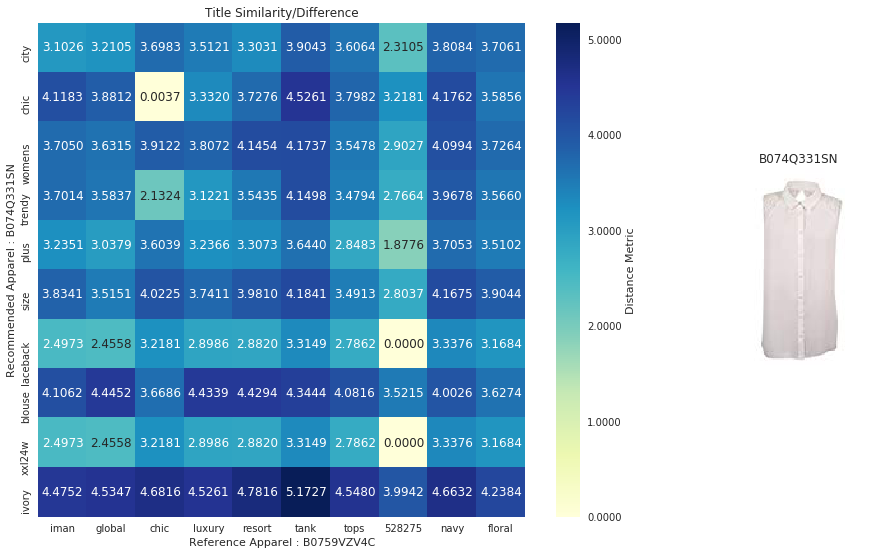





Recommended Product 4 Information :

ASIN:	 B074LTBXR5
Brand: 	 Sharif
Color: 	 Pink
Price:	 $21.56

Description Summary: 

 sharif floral print top beading luxe slv 319237 pink  



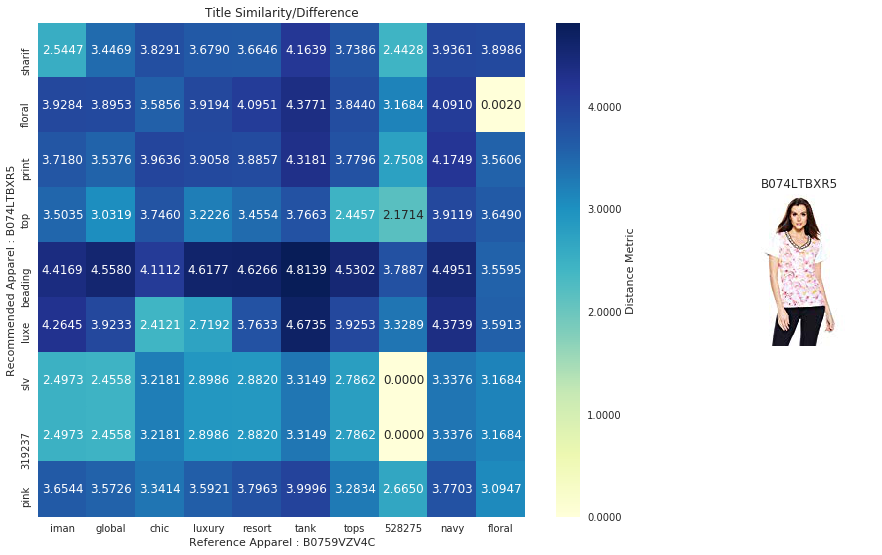





Recommended Product 5 Information :

ASIN:	 B01MFBK5YK
Brand: 	 City Chic
Color: 	 Mid Denim
Price:	 $43.45

Description Summary: 

 designer plus size shirt miss military  mid denim  18   city chic  



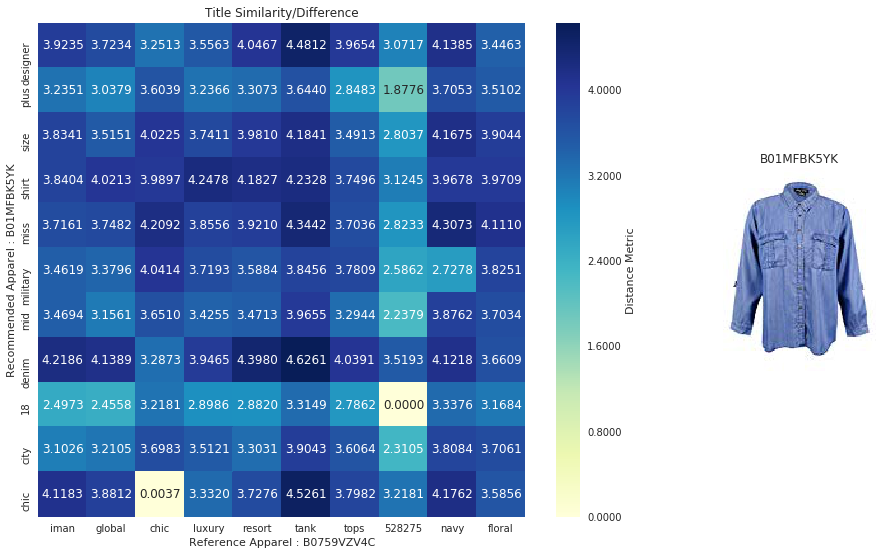





Recommended Product 6 Information :

ASIN:	 B013F7813W
Brand: 	 Sonoma Lavender
Color: 	 purple
Price:	 $22.00

Description Summary: 

 sonoma lavender luxury spa black white spa mask  



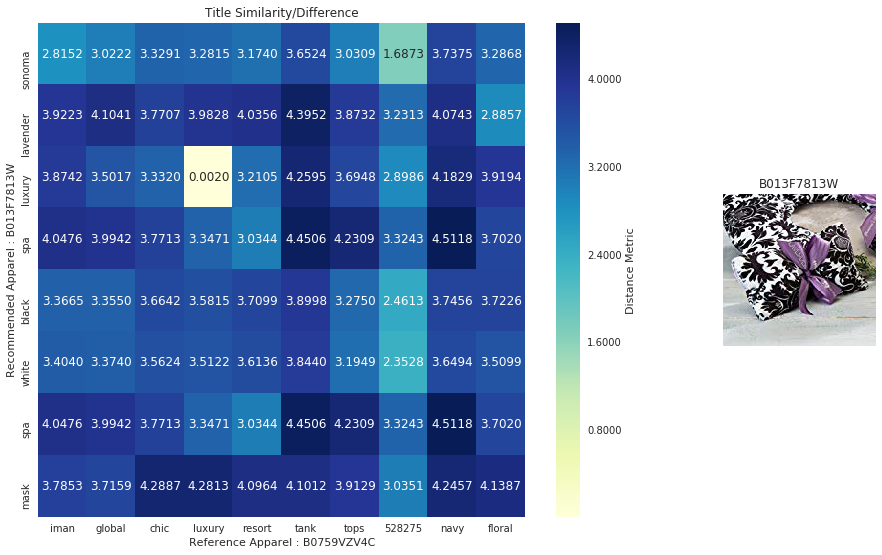





Recommended Product 7 Information :

ASIN:	 B013F77UDE
Brand: 	 Sonoma Lavender
Color: 	 Black, White
Price:	 $42.00

Description Summary: 

 sonoma lavender luxury spa black white damask heat wrap  



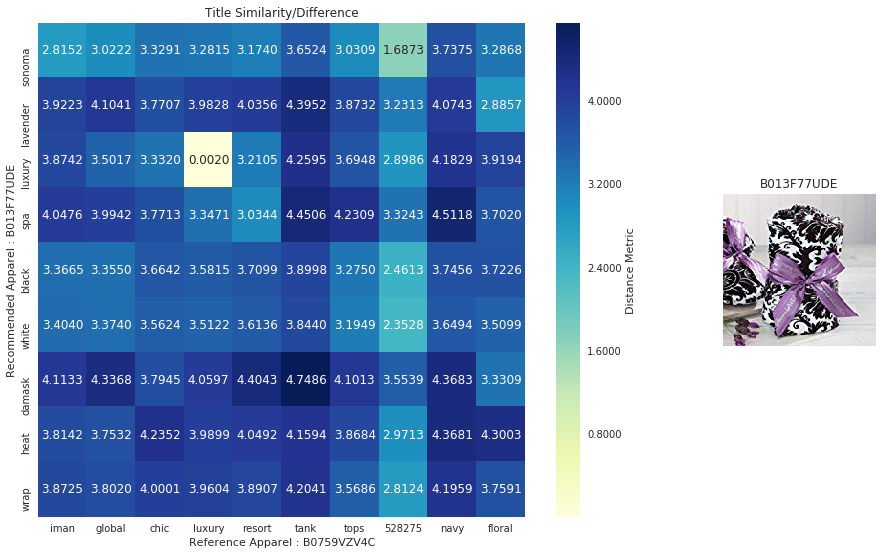





Recommended Product 8 Information :

ASIN:	 B00FB7Q4PC
Brand: 	 other
Color: 	 White
Price:	 $10.49

Description Summary: 

 brand noble luxury victorian tops women shirt ruffle flounce ladies blouse white  



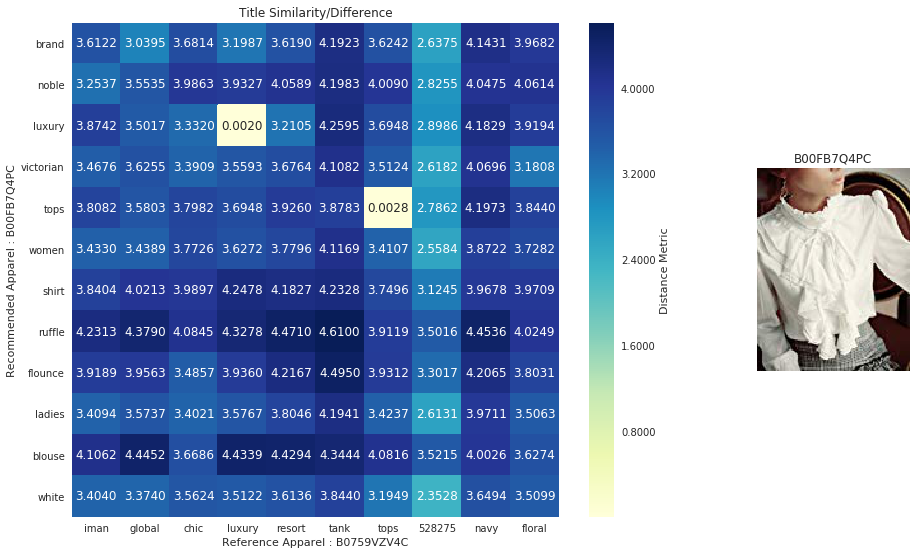




**************************************************
**************************************************
<--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><-->
Reference Image ... 



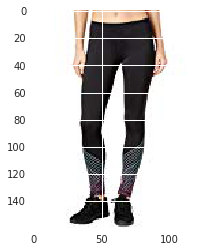

<--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><-->

Recommended Product 1 Information :

ASIN:	 B01NB0NKRO
Brand: 	 Ideology
Color: 	 White
Price:	 $10.00

Description Summary: 

 ideology graphic tshirt xl white  



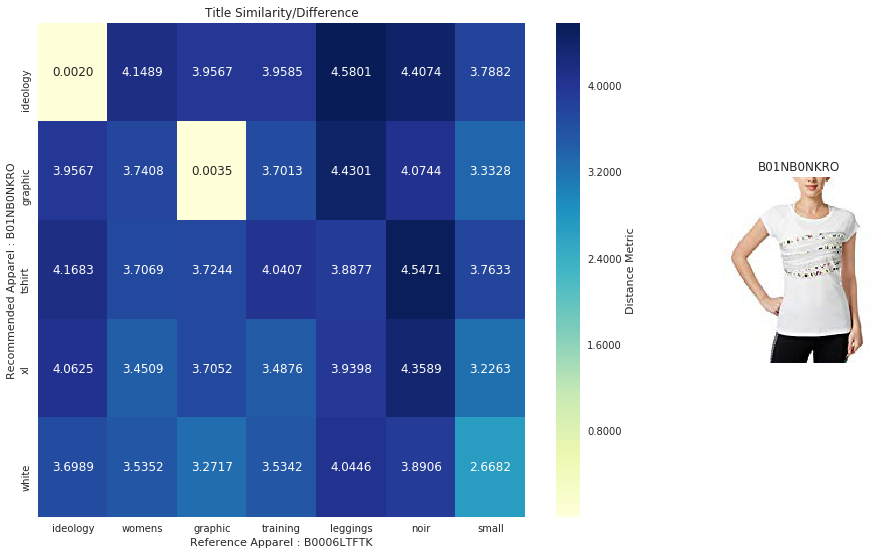





Recommended Product 2 Information :

ASIN:	 B01MFDNJZ8
Brand: 	 Ideology
Color: 	 Noir Spacedye
Price:	 $8.02

Description Summary: 

 ideology raglan spaceddyed longsleeve top size xs  



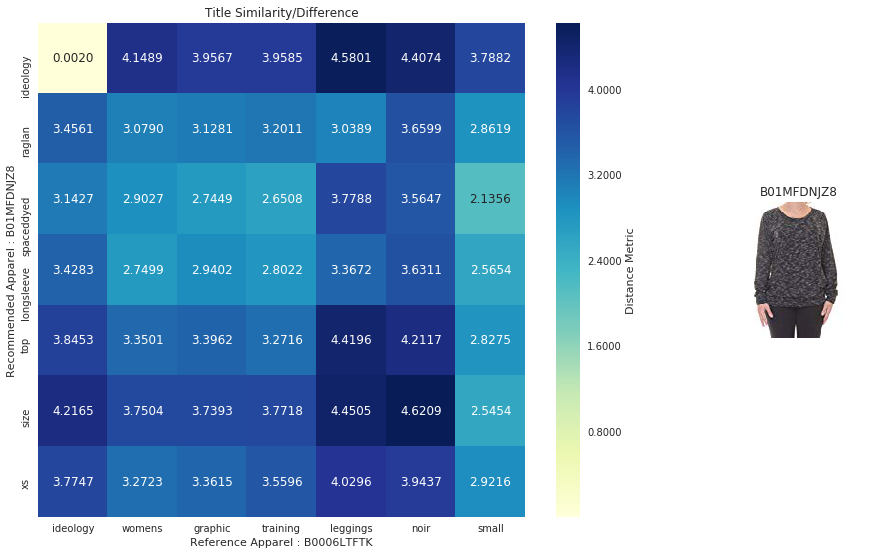





Recommended Product 3 Information :

ASIN:	 B07145W3G3
Brand: 	 Punk
Color: 	 Black
Price:	 $32.00

Description Summary: 

 punk gothic womens black shirt sexy backless cut tshirts blouse long sleeve  



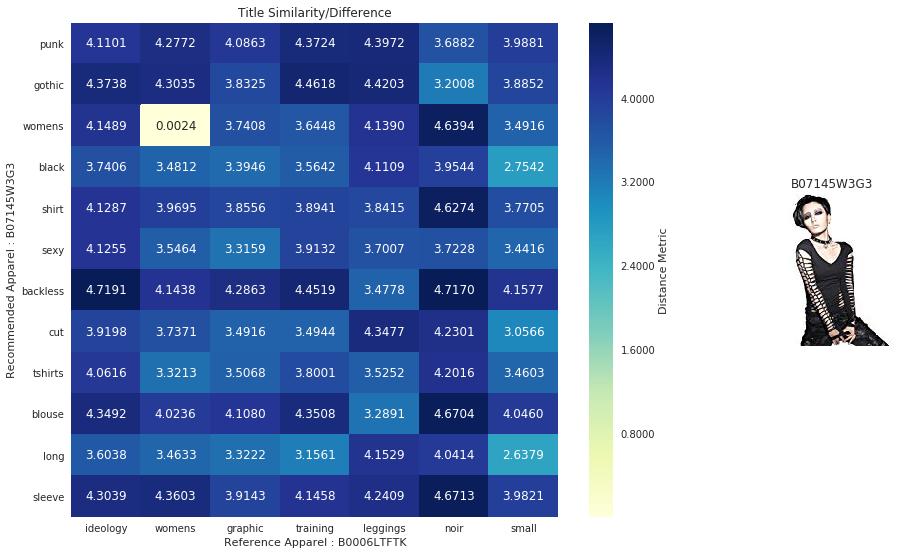





Recommended Product 4 Information :

ASIN:	 B06XKBKYQC
Brand: 	 Denim & Supply
Color: 	 Gray
Price:	 $29.99

Description Summary: 

 denim  supply drapey graphic tshirt size l  



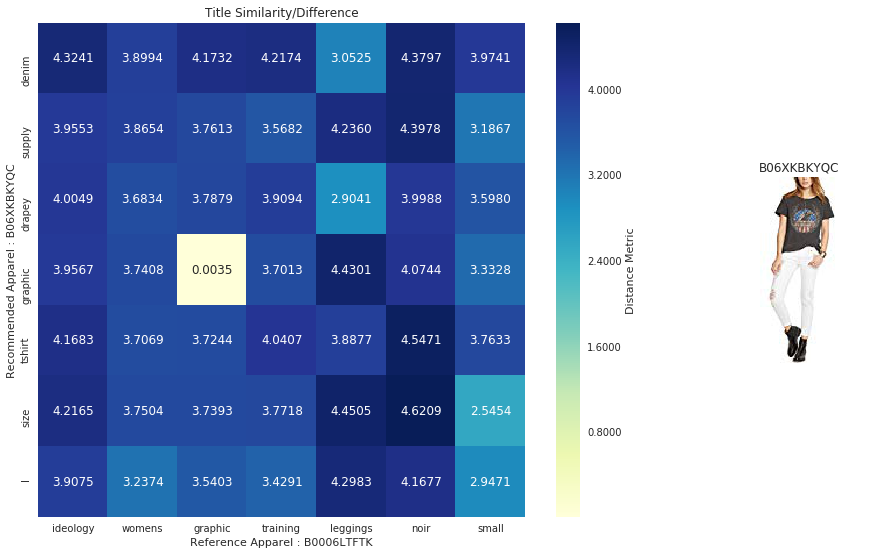





Recommended Product 5 Information :

ASIN:	 B073YDZTJL
Brand: 	 Material Girl
Color: 	 Noir
Price:	 $13.75

Description Summary: 

 material girl noir black laceinset crop tank top noir  



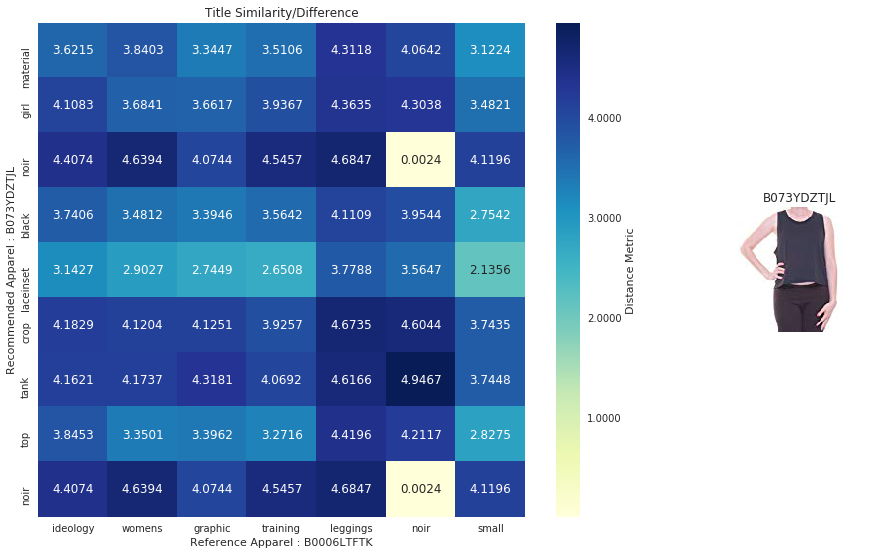





Recommended Product 6 Information :

ASIN:	 B07464B4M1
Brand: 	 TOKYO-T
Color: 	 Black
Price:	 $20.90

Description Summary: 

 tokyot skull tshirts women long sleeve halloween tunics loose leggings  



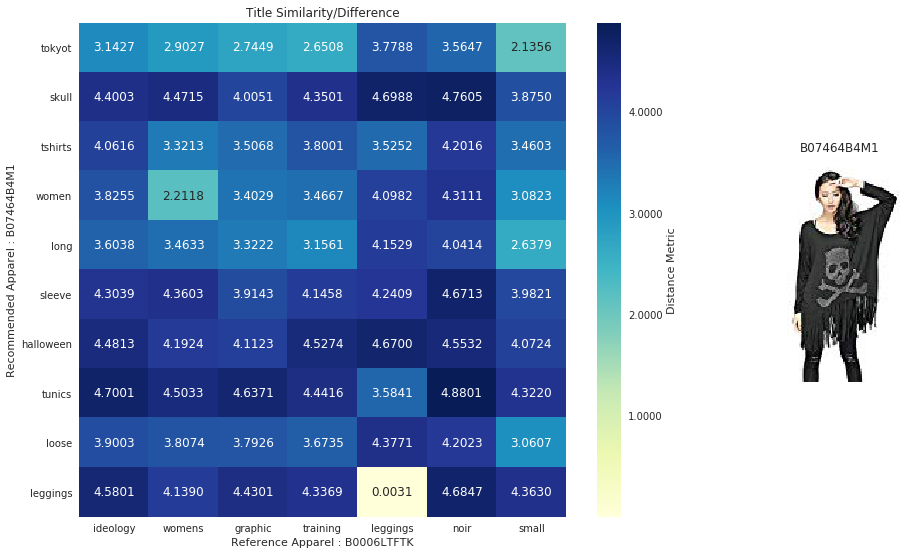





Recommended Product 7 Information :

ASIN:	 B071DP41VM
Brand: 	 LARACE
Color: 	 Black
Price:	 $15.99

Description Summary: 

 larace women solid sleeveless tunic leggings swing flare tank tops l black  



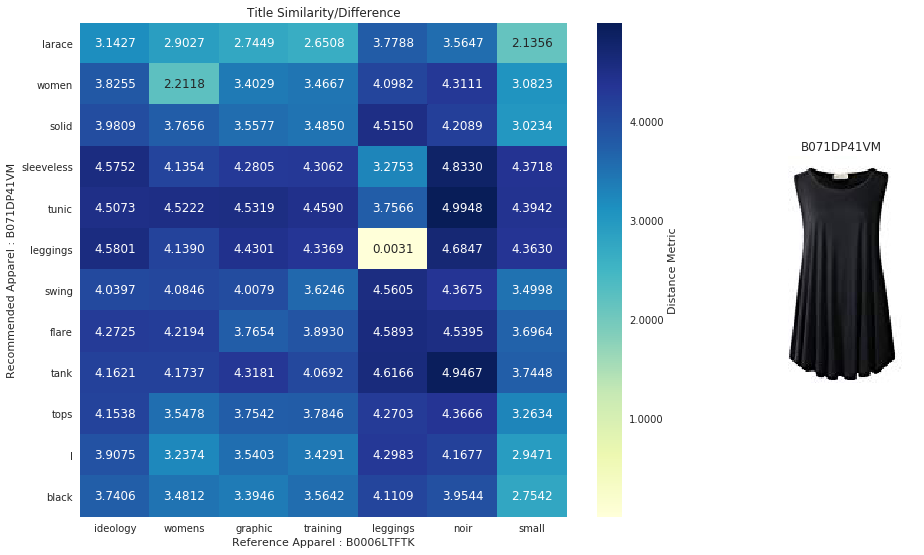





Recommended Product 8 Information :

ASIN:	 B073NYKGRL
Brand: 	 TOOGOO(R)
Color: 	 White
Price:	 $8.43

Description Summary: 

 toogoor summer style women chiffon sexy tops neck sleeveless fashion solid fitness casual vest topswhitexlus10uk14  



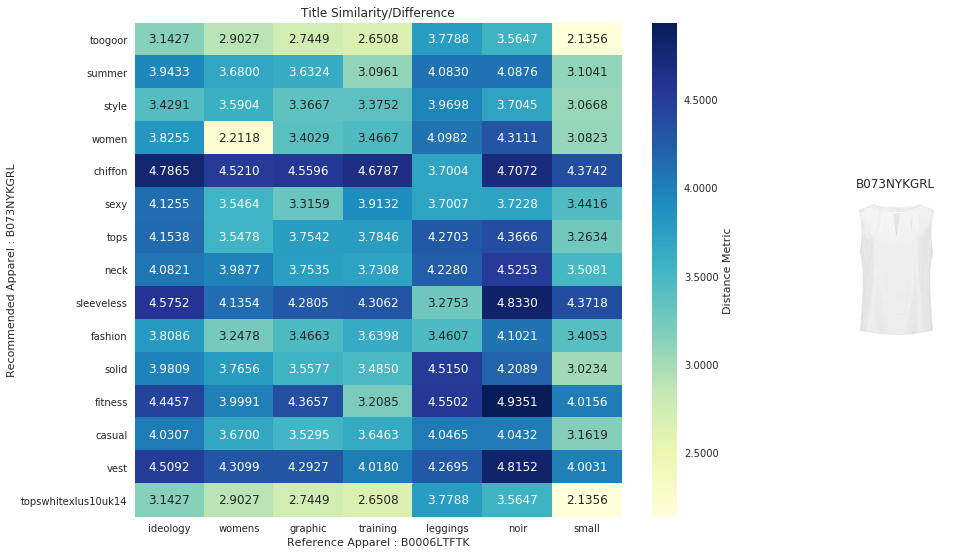




**************************************************
**************************************************
<--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><-->
Reference Image ... 



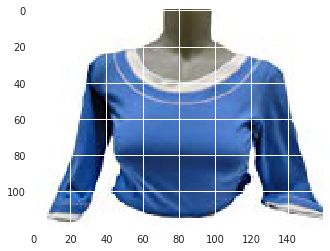

<--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><-->

Recommended Product 1 Information :

ASIN:	 B073RJTBVT
Brand: 	 Pleione
Color: 	 Black Solid
Price:	 $26.00

Description Summary: 

 pleione ladies short sleeve blouse size xxl color black solid  



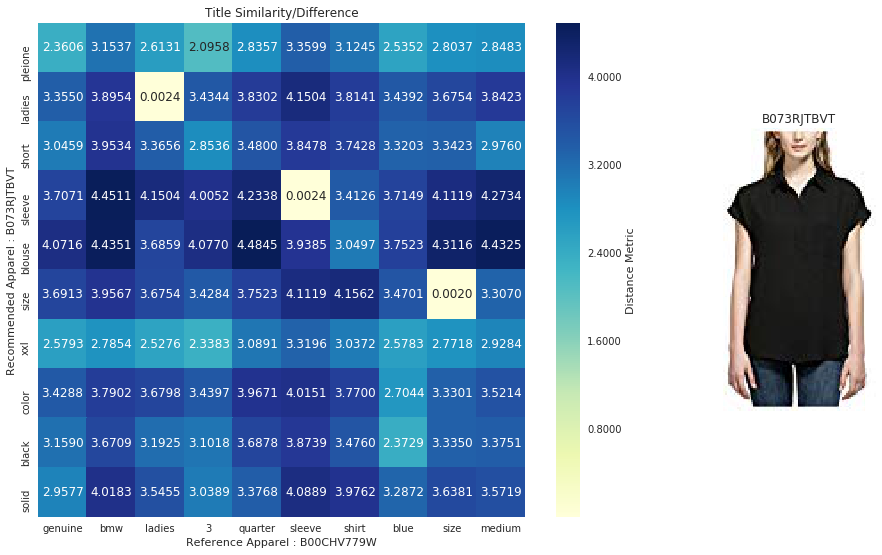





Recommended Product 2 Information :

ASIN:	 B006E1E3VQ
Brand: 	 BMW
Color: 	 White
Price:	 $65.50

Description Summary: 

 bmw genuine logo performance ladies blouse  xxl  



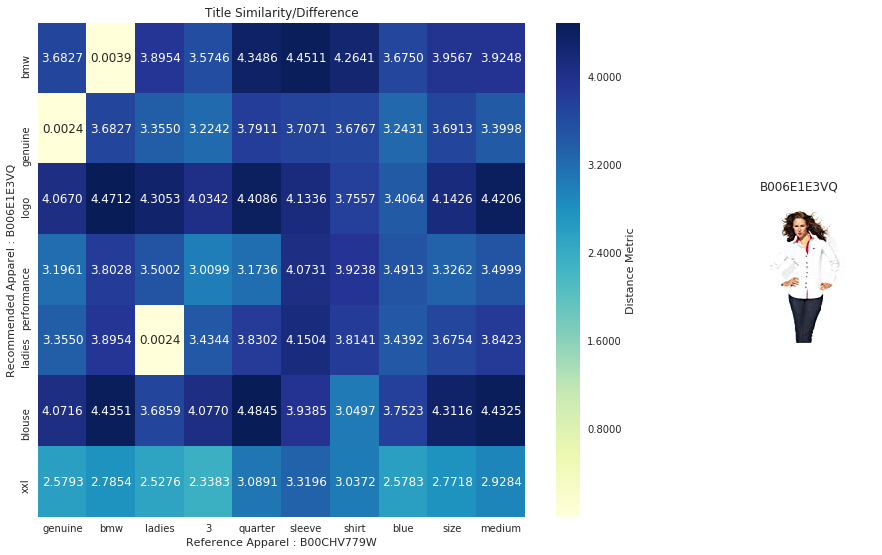





Recommended Product 3 Information :

ASIN:	 B003I82KOK
Brand: 	 Dickies
Color: 	 Light Blue
Price:	 $24.99

Description Summary: 

 dickies  1254 womens buttondown oxford shirt  short sleeve size 20 color light blue  



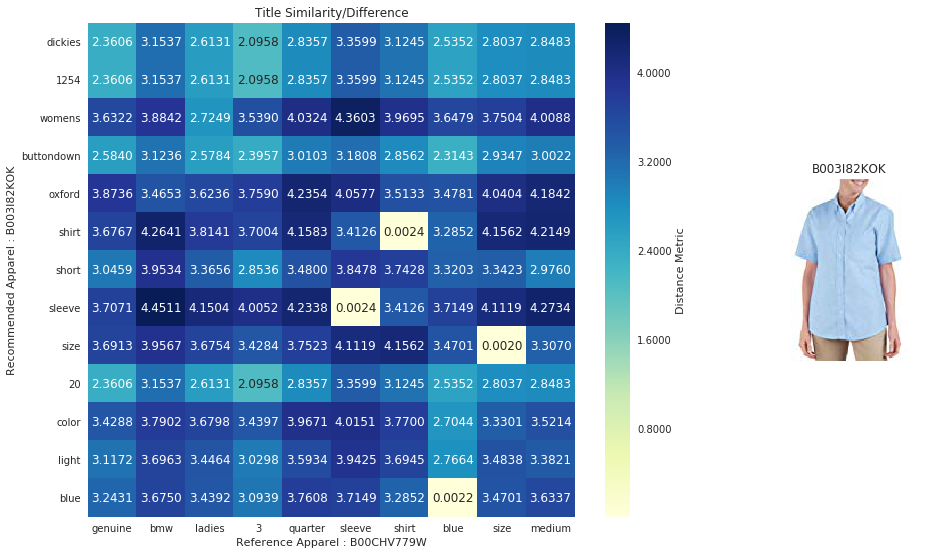





Recommended Product 4 Information :

ASIN:	 B00FLVWB0U
Brand: 	 BMW
Color: 	 white/dark blue
Price:	 $58.50

Description Summary: 

 bmw yachting polo shirt  ladies whitedark blue  medium  



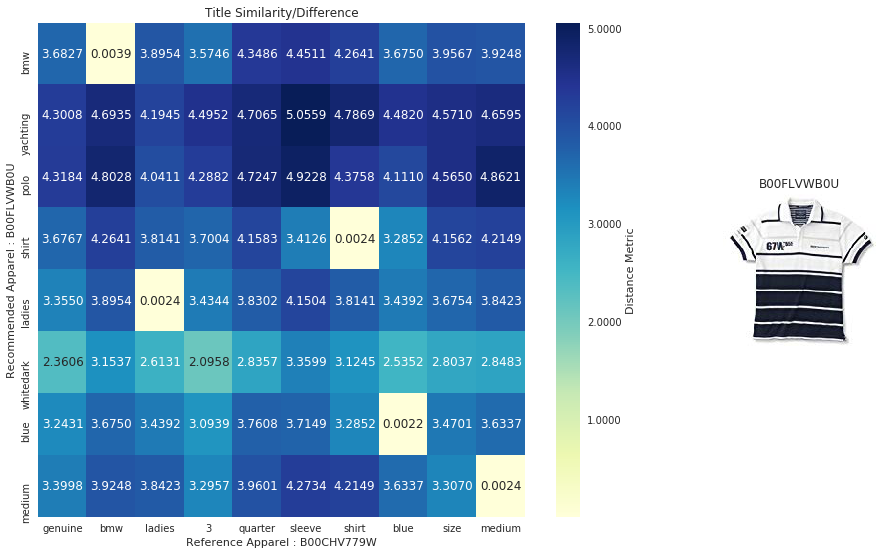





Recommended Product 5 Information :

ASIN:	 B06X6JF5PR
Brand: 	 Fylo
Color: 	 Purple Baroque Print
Price:	 $17.95

Description Summary: 

 fylo womens size medium long sleeve blouse purple baroque print  



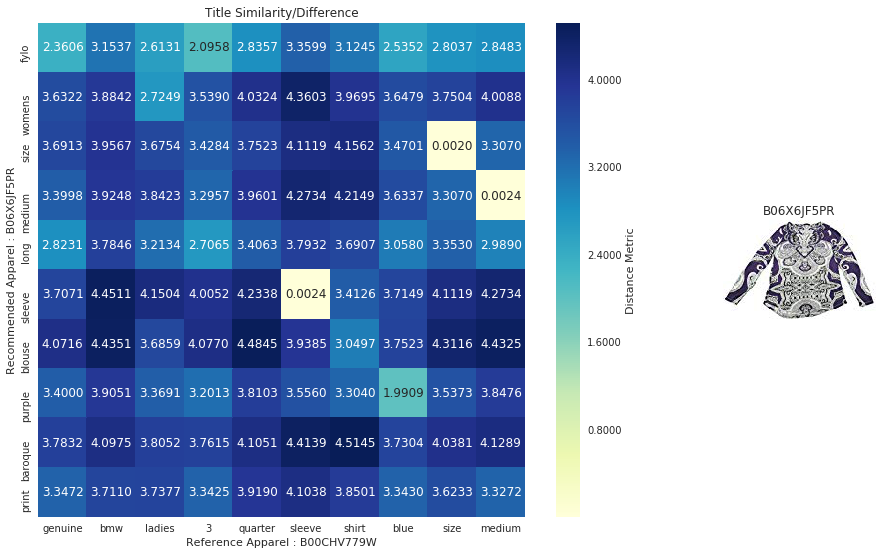





Recommended Product 6 Information :

ASIN:	 B0184ROP6A
Brand: 	 Elizabeth McKay
Color: 	 Red
Price:	 $32.99

Description Summary: 

 elizabeth mckay womens short sleeve button tee medium red  



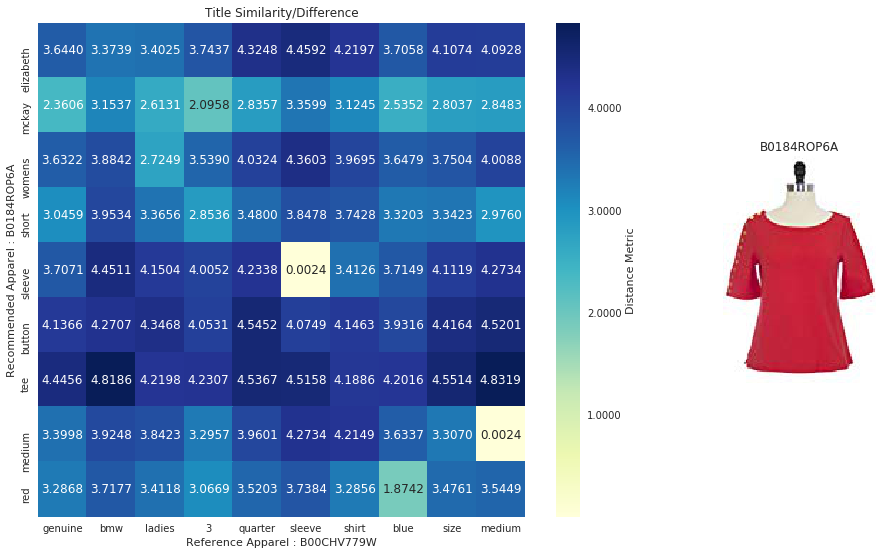





Recommended Product 7 Information :

ASIN:	 B00AA30188
Brand: 	 BMW
Color: 	 dark blue
Price:	 $29.00

Description Summary: 

 bmw ladies longsleeve shirt dark blue  small  



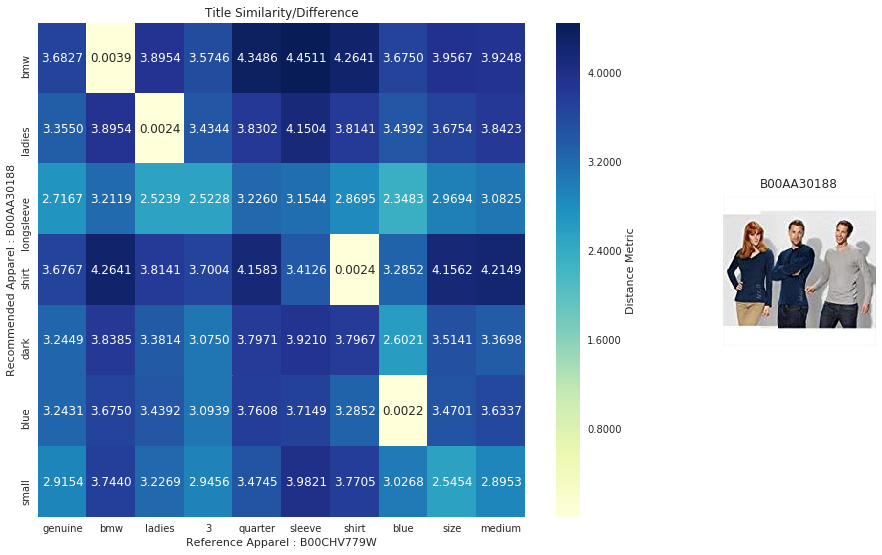





Recommended Product 8 Information :

ASIN:	 B006F8W9B4
Brand: 	 BMW
Color: 	 Blue
Price:	 $78.45

Description Summary: 

 bmw ladies longsleeve  light blue  small  



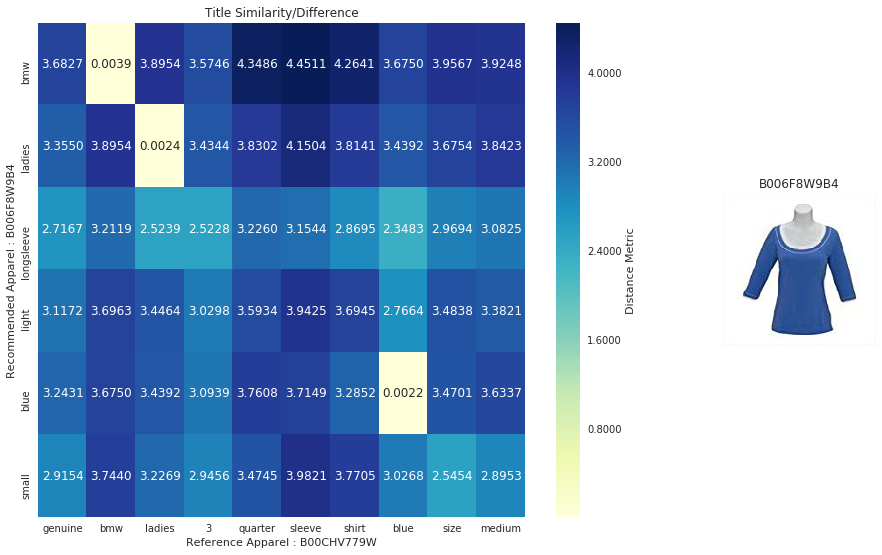




**************************************************
**************************************************
<--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><-->
Reference Image ... 



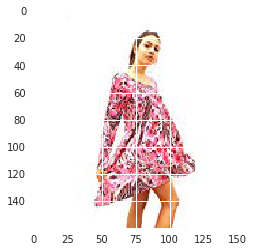

<--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><-->

Recommended Product 1 Information :

ASIN:	 B01N4QQMBJ
Brand: 	 BASICOJ
Color: 	 Gray
Price:	 $17.99

Description Summary: 

 basicoj womens turtle neck long sleeve leopard animal print top  



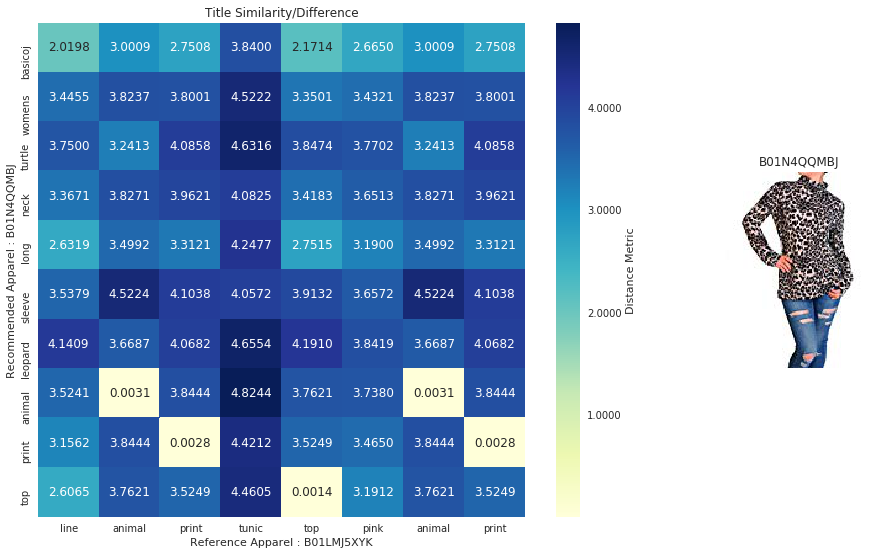





Recommended Product 2 Information :

ASIN:	 B06X6GX6WG
Brand: 	 Animal
Color: 	 Banana Yellow Marl
Price:	 $38.95

Description Summary: 

 animal oceania tshirt  yellow  



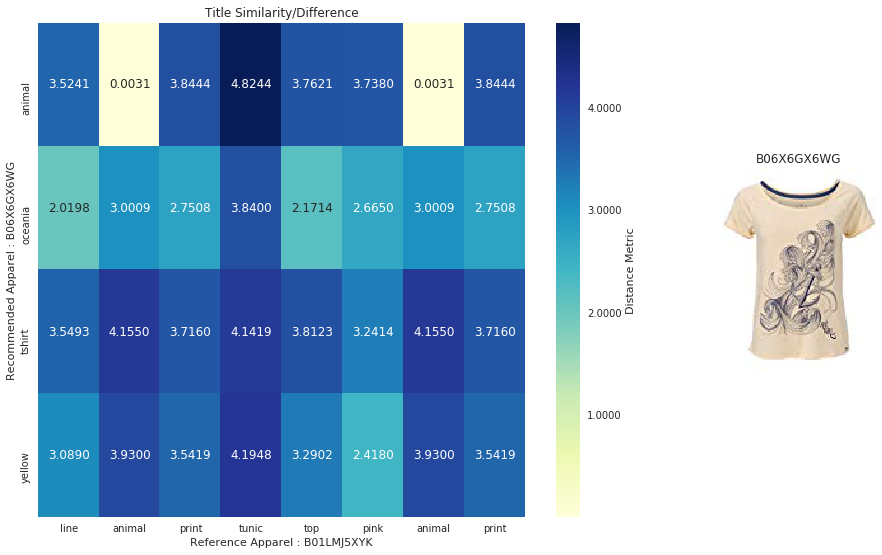





Recommended Product 3 Information :

ASIN:	 B074QV7PCM
Brand: 	 Brazen
Color: 	 Gray
Price:	 $18.99

Description Summary: 

 brazen womens one animal print embellished blouse gray one size  



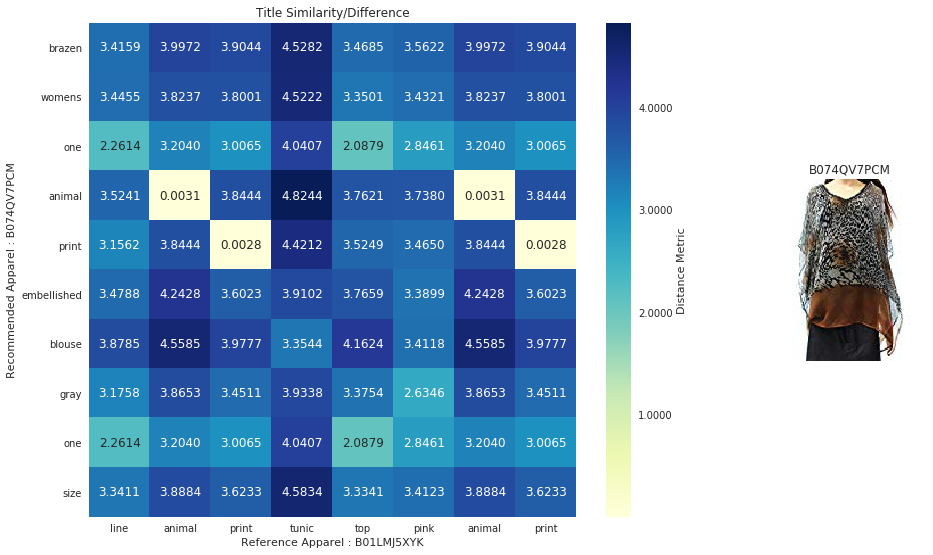





Recommended Product 4 Information :

ASIN:	 B071Z8L7Z3
Brand: 	 Bifast
Color: 	 Grey
Price:	 $14.99

Description Summary: 

 bifast womens daily neck batwing sleeve cotton animal print shirt greyxl  



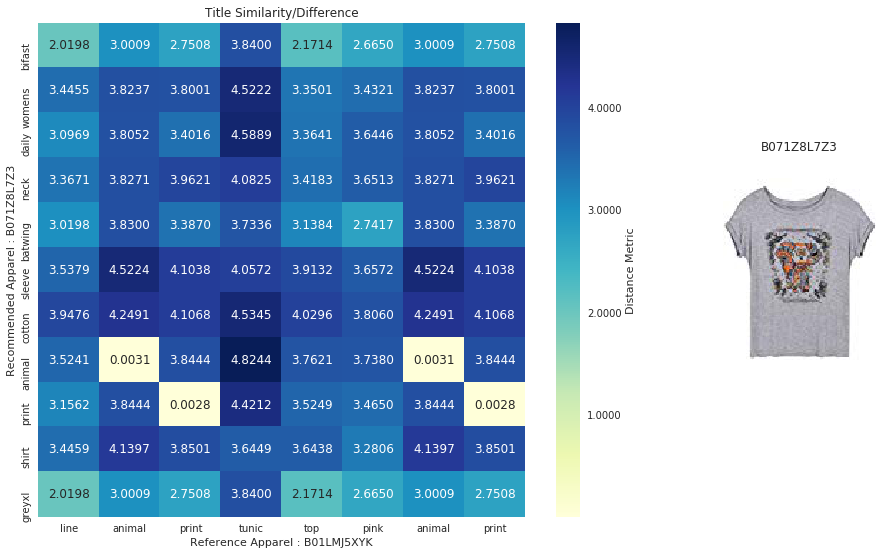





Recommended Product 5 Information :

ASIN:	 B01DSAAHAG
Brand: 	 Modamix Woman
Color: 	 Multi Color
Price:	 $39.99

Description Summary: 

 modamix womens plus short sleeve animal print blouse 1x zebra  



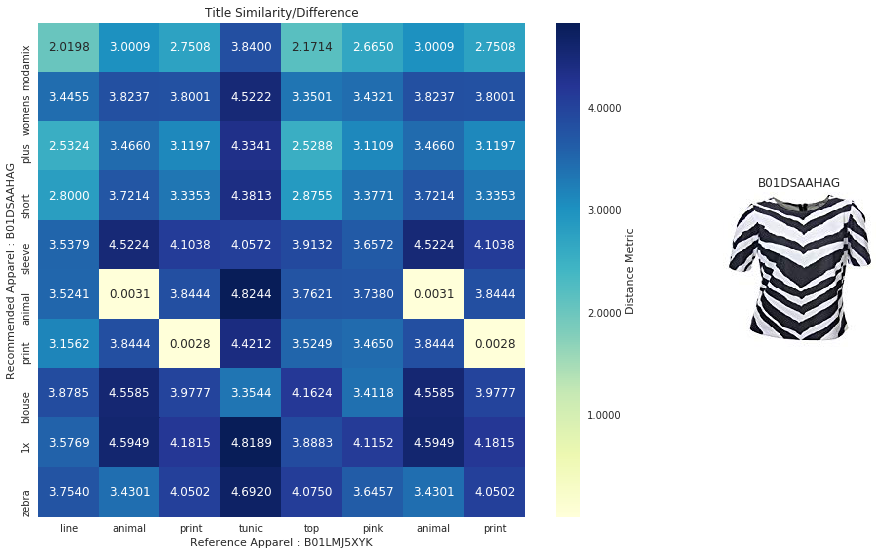





Recommended Product 6 Information :

ASIN:	 B01EXZQR4K
Brand: 	 eshion
Color: 	 One Color
Price:	 $8.99

Description Summary: 

 eshion womens summer casual tiger animal print tshirt tops  



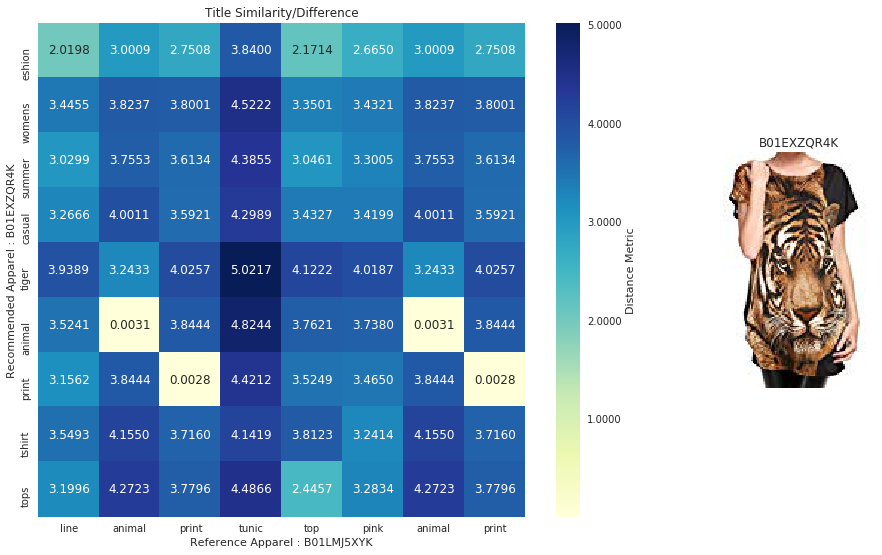





Recommended Product 7 Information :

ASIN:	 B00GX3NO74
Brand: 	 Demarkt
Color: 	 Leopard
Price:	 $10.77

Description Summary: 

 demarkt womens sexy animal leopard print long sleeve blouse  



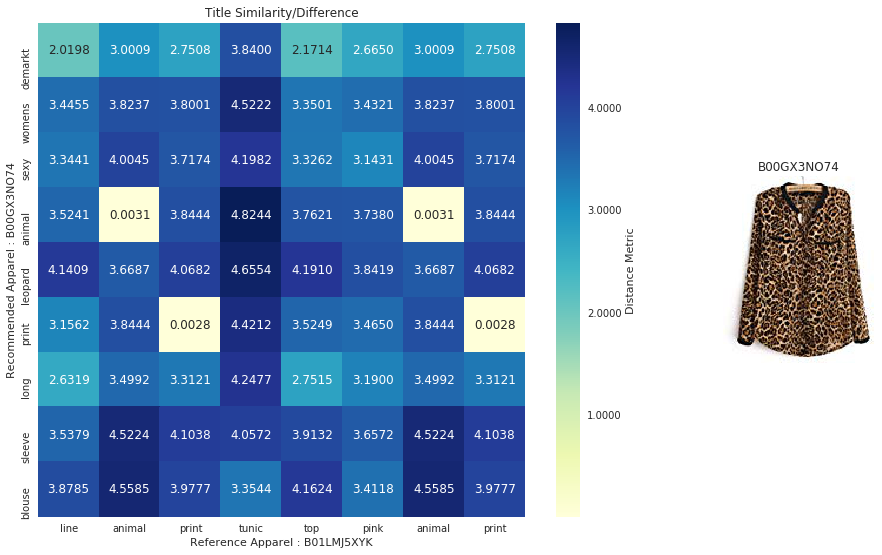





Recommended Product 8 Information :

ASIN:	 B0756L6MTG
Brand: 	 Salvatore Ferragamo
Color: 	 Black/Lavender
Price:	 $149.00

Description Summary: 

 salvatore ferragamo animal print tshirt l  



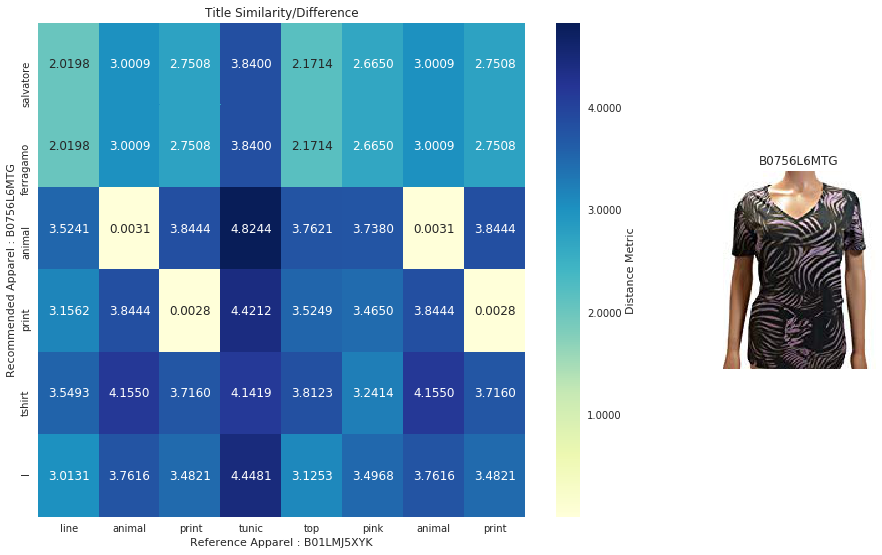




**************************************************
**************************************************
<--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><-->
Reference Image ... 



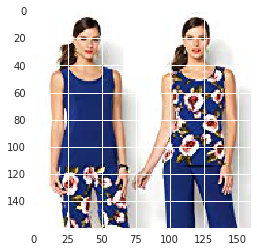

<--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><-->

Recommended Product 1 Information :

ASIN:	 B01N4V02YR
Brand: 	 Iman
Color: 	 Ruby Red
Price:	 $24.99

Description Summary: 

 iman global chic simply glamorous top large red  



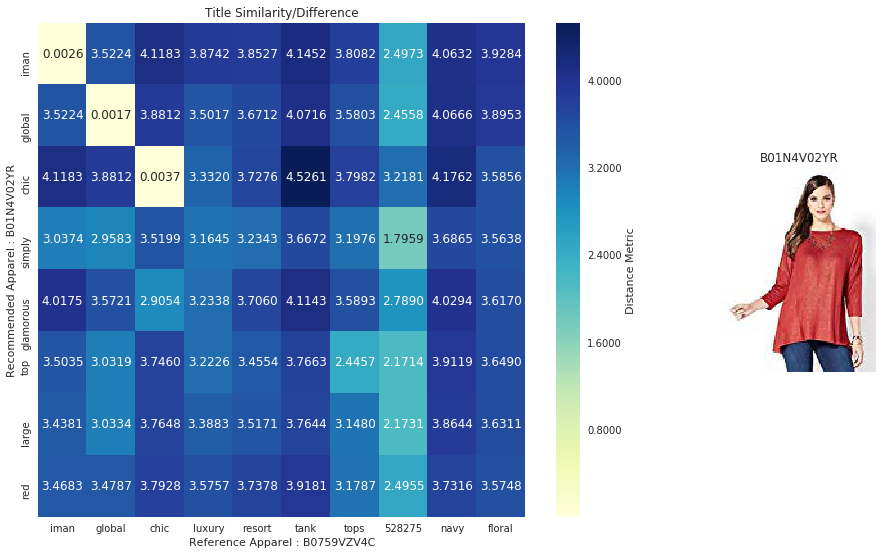





Recommended Product 2 Information :

ASIN:	 B01MAZENNL
Brand: 	 Iman
Color: 	 Ruby Red
Price:	 $77.77

Description Summary: 

 iman global chic simply glamorous top sparkling jewelry set medium red  



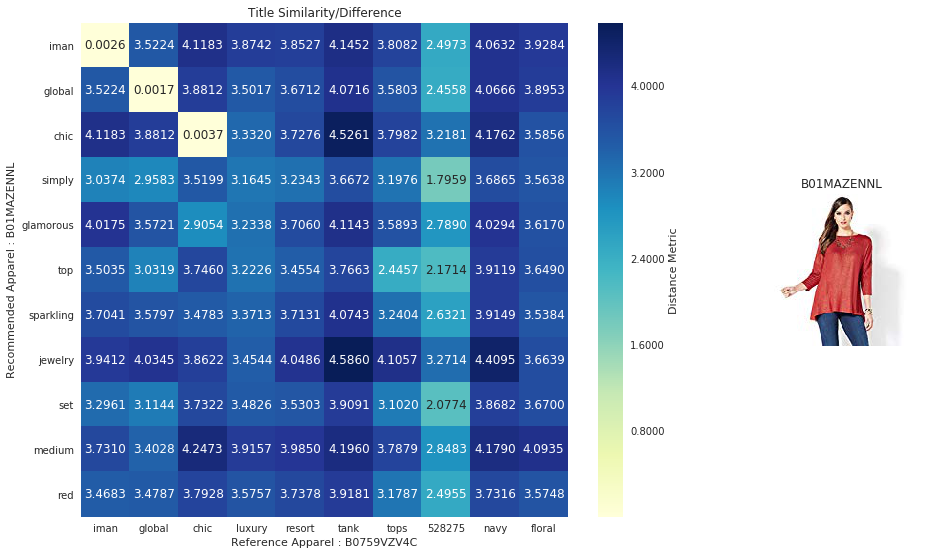





Recommended Product 3 Information :

ASIN:	 B074Q331SN
Brand: 	 City Chic
Color: 	 Ivory
Price:	 $38.92

Description Summary: 

 city chic womens trendy plus size laceback blouse xxl24w ivory  



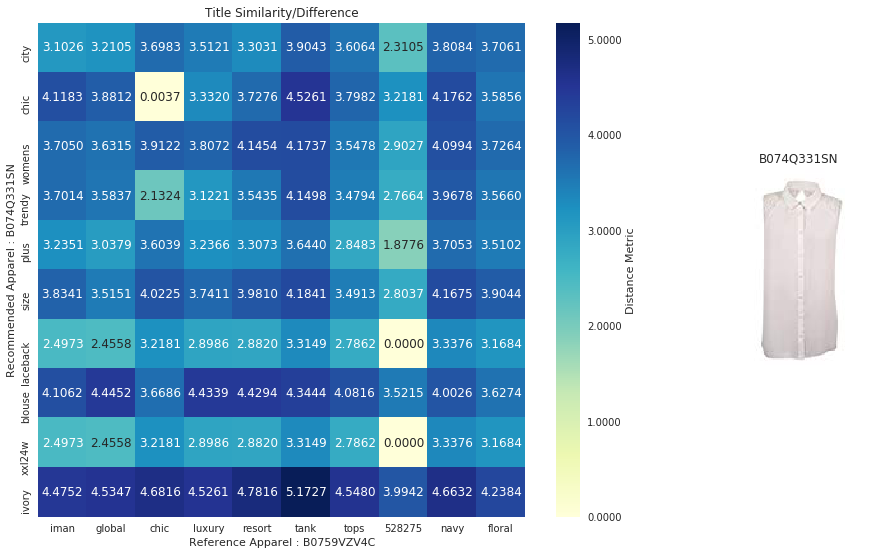





Recommended Product 4 Information :

ASIN:	 B074LTBXR5
Brand: 	 Sharif
Color: 	 Pink
Price:	 $21.56

Description Summary: 

 sharif floral print top beading luxe slv 319237 pink  



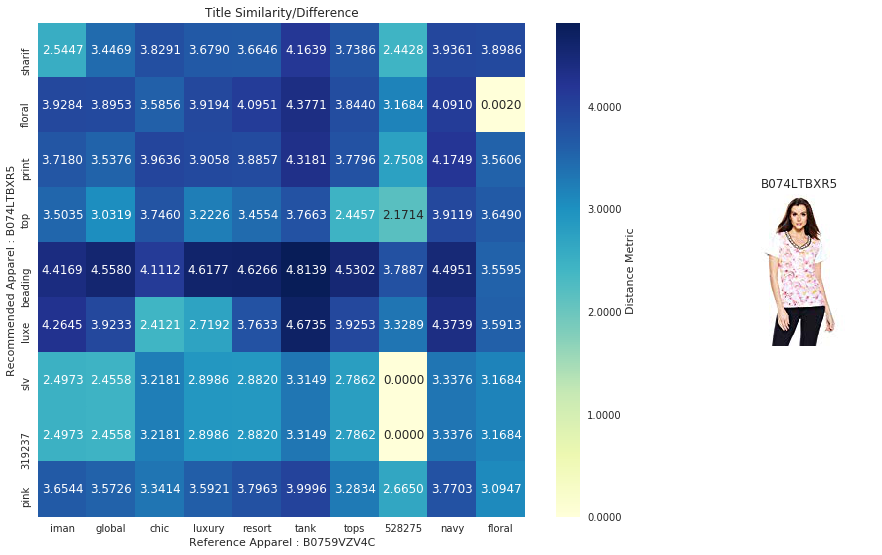





Recommended Product 5 Information :

ASIN:	 B01MFBK5YK
Brand: 	 City Chic
Color: 	 Mid Denim
Price:	 $43.45

Description Summary: 

 designer plus size shirt miss military  mid denim  18   city chic  



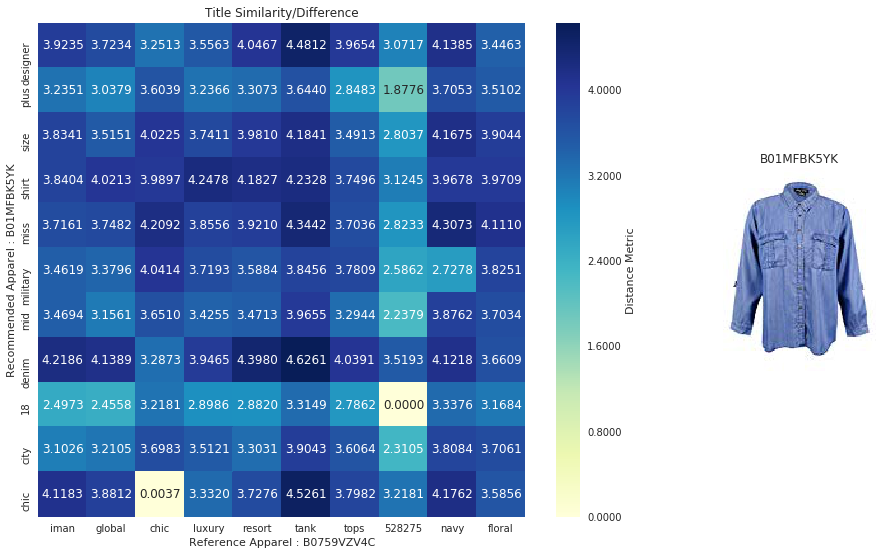





Recommended Product 6 Information :

ASIN:	 B013F7813W
Brand: 	 Sonoma Lavender
Color: 	 purple
Price:	 $22.00

Description Summary: 

 sonoma lavender luxury spa black white spa mask  



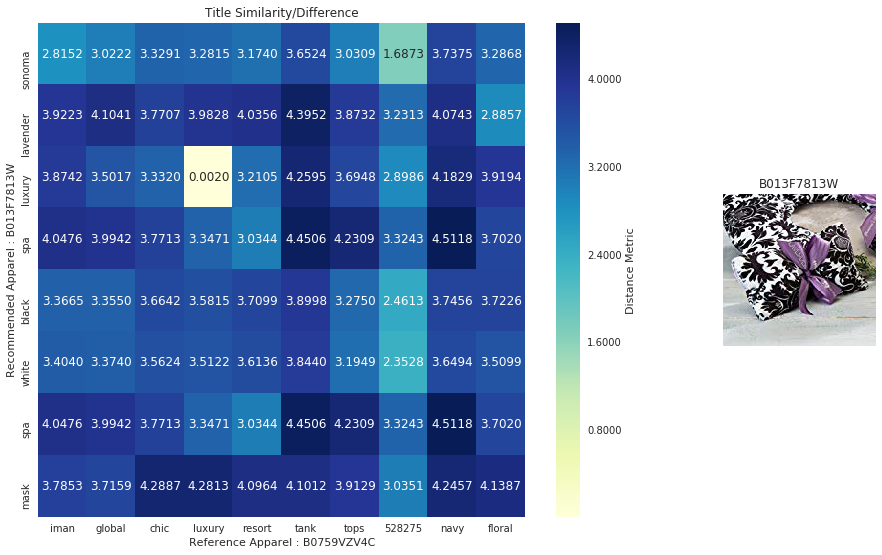





Recommended Product 7 Information :

ASIN:	 B013F77UDE
Brand: 	 Sonoma Lavender
Color: 	 Black, White
Price:	 $42.00

Description Summary: 

 sonoma lavender luxury spa black white damask heat wrap  



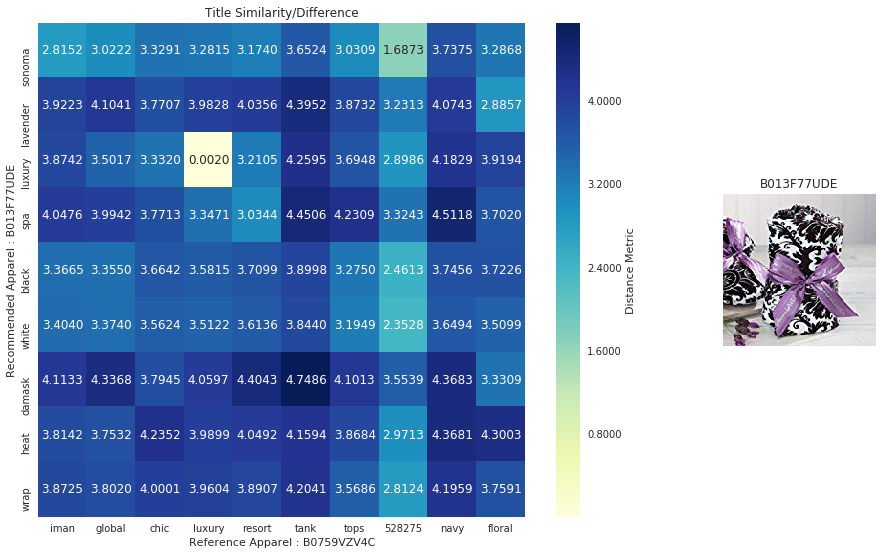





Recommended Product 8 Information :

ASIN:	 B00FB7Q4PC
Brand: 	 other
Color: 	 White
Price:	 $10.49

Description Summary: 

 brand noble luxury victorian tops women shirt ruffle flounce ladies blouse white  



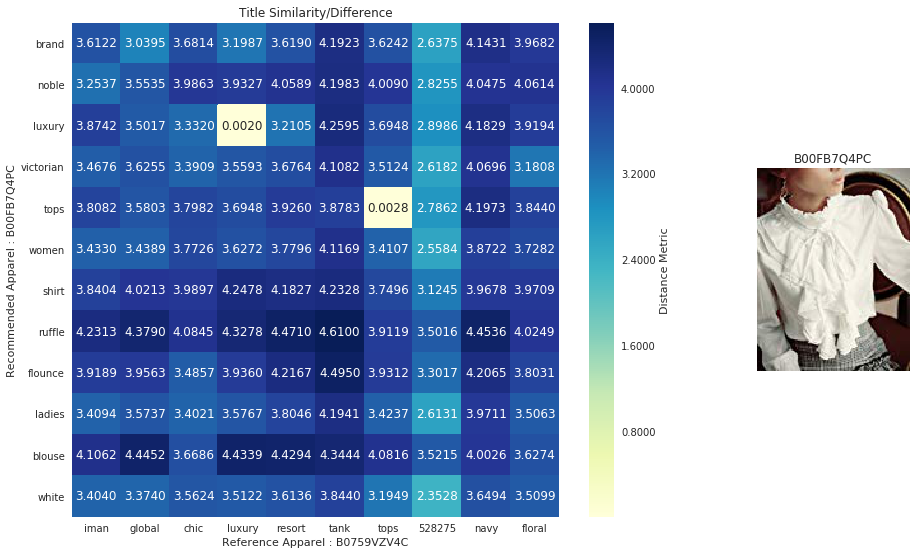




**************************************************
**************************************************
<--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><-->
Reference Image ... 



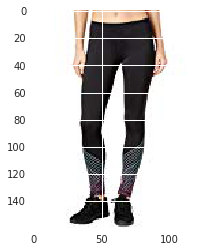

<--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><-->

Recommended Product 1 Information :

ASIN:	 B00XUWLRO8
Brand: 	 Arctic Leaf
Color: 	 Black
Price:	 $9.22

Description Summary: 

 sexy fashion punk streetwear cold shoulder tshirt blouse top black  



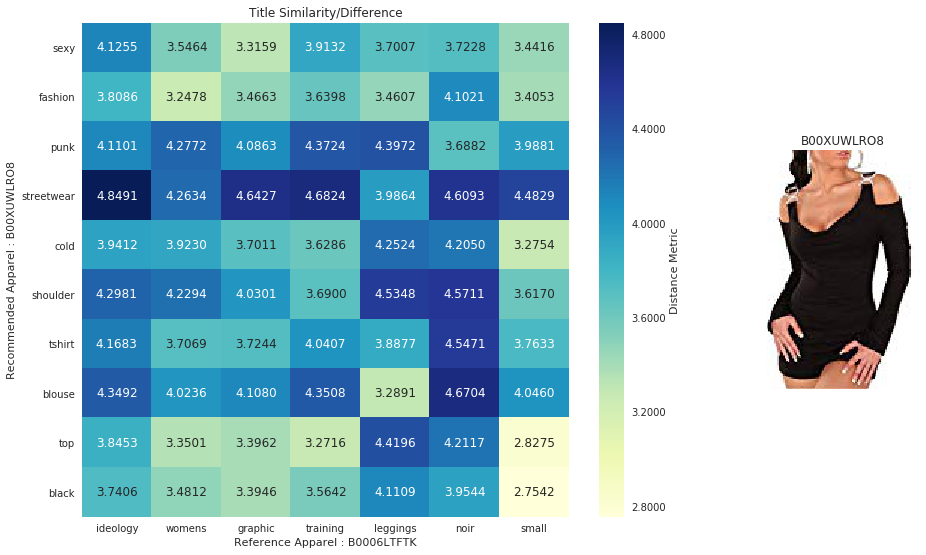





Recommended Product 2 Information :

ASIN:	 B071XD3VCH
Brand: 	 BLUSH NOIR
Color: 	 Pink Multi
Price:	 $24.99

Description Summary: 

 blush noir womens blush noir pleated top pink  



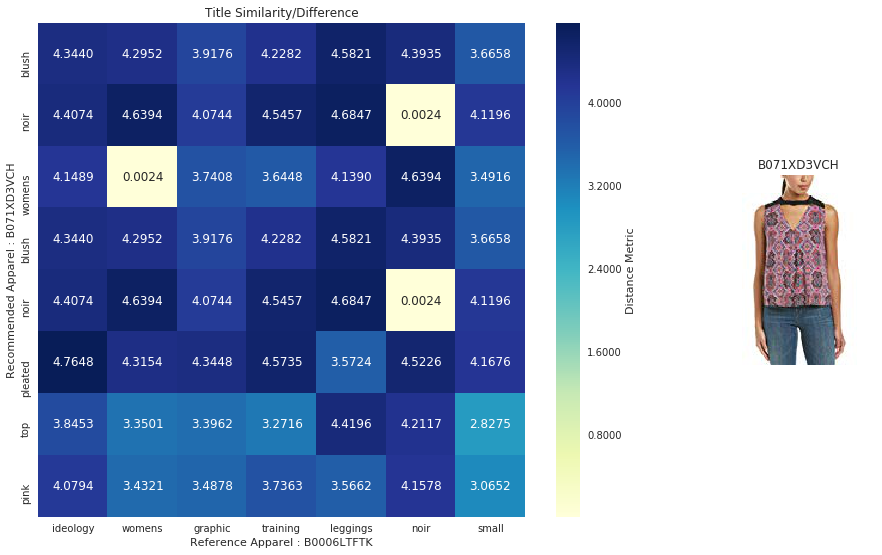





Recommended Product 3 Information :

ASIN:	 B01NB0NKRO
Brand: 	 Ideology
Color: 	 White
Price:	 $10.00

Description Summary: 

 ideology graphic tshirt xl white  



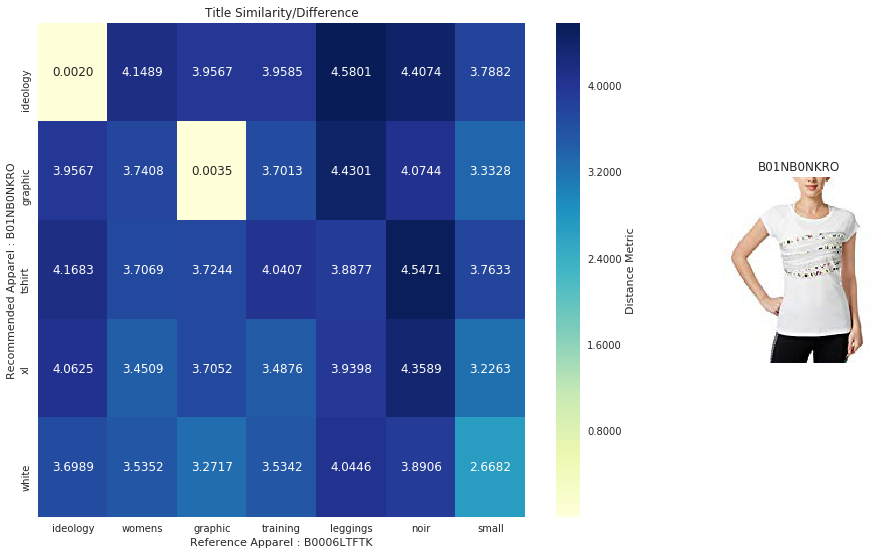





Recommended Product 4 Information :

ASIN:	 B06XKBKYQC
Brand: 	 Denim & Supply
Color: 	 Gray
Price:	 $29.99

Description Summary: 

 denim  supply drapey graphic tshirt size l  



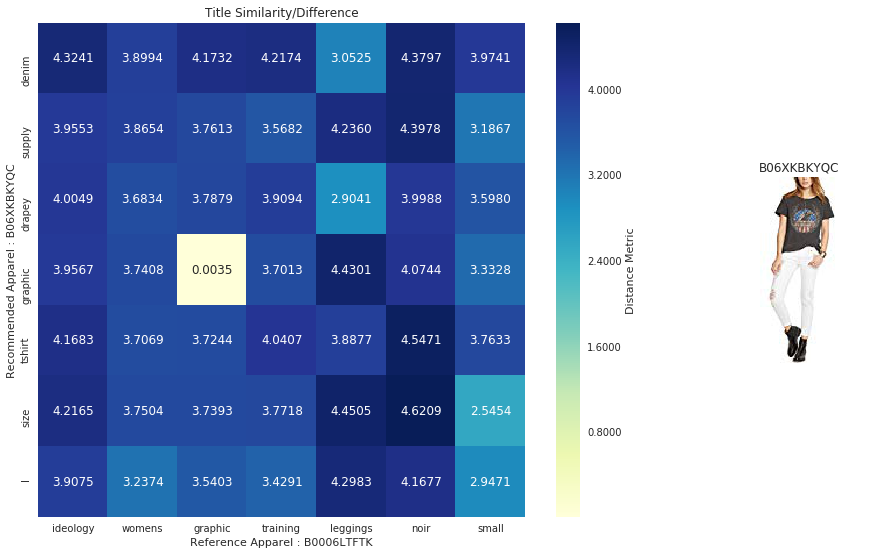





Recommended Product 5 Information :

ASIN:	 B073YDZTJL
Brand: 	 Material Girl
Color: 	 Noir
Price:	 $13.75

Description Summary: 

 material girl noir black laceinset crop tank top noir  



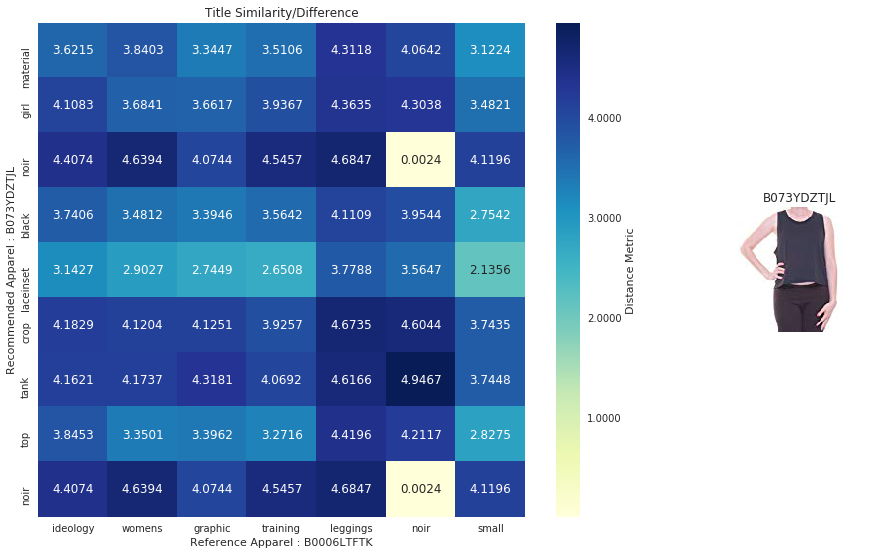





Recommended Product 6 Information :

ASIN:	 B0744QXTFQ
Brand: 	 Tripp NYC
Color: 	 Black
Price:	 $27.99

Description Summary: 

 tripp nyc gothic punk cyber goth corset rocker biker moto side lace crop halter top xl  



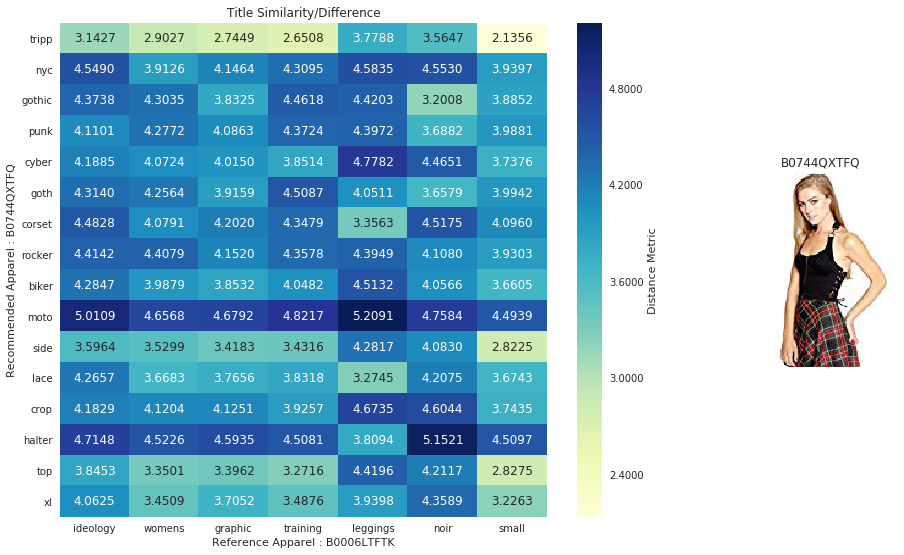





Recommended Product 7 Information :

ASIN:	 B07464B4M1
Brand: 	 TOKYO-T
Color: 	 Black
Price:	 $20.90

Description Summary: 

 tokyot skull tshirts women long sleeve halloween tunics loose leggings  



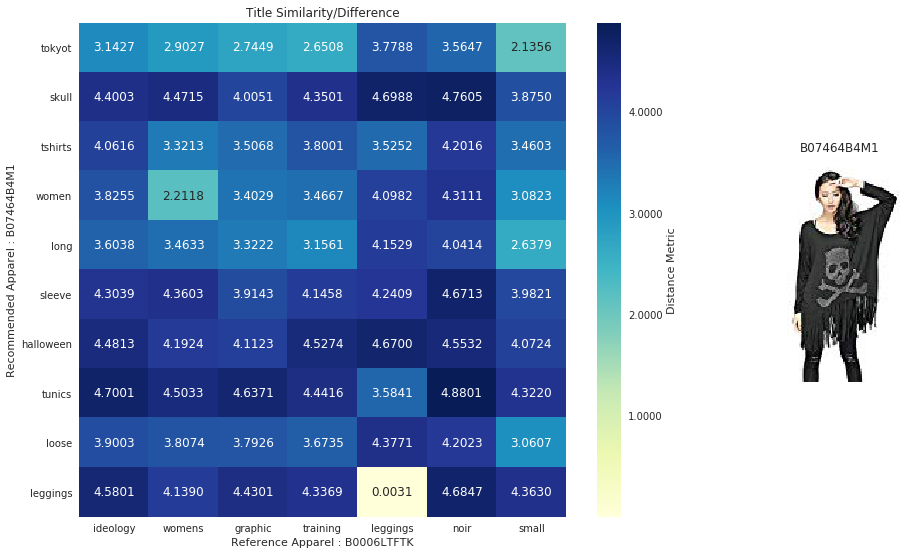





Recommended Product 8 Information :

ASIN:	 B071DP41VM
Brand: 	 LARACE
Color: 	 Black
Price:	 $15.99

Description Summary: 

 larace women solid sleeveless tunic leggings swing flare tank tops l black  



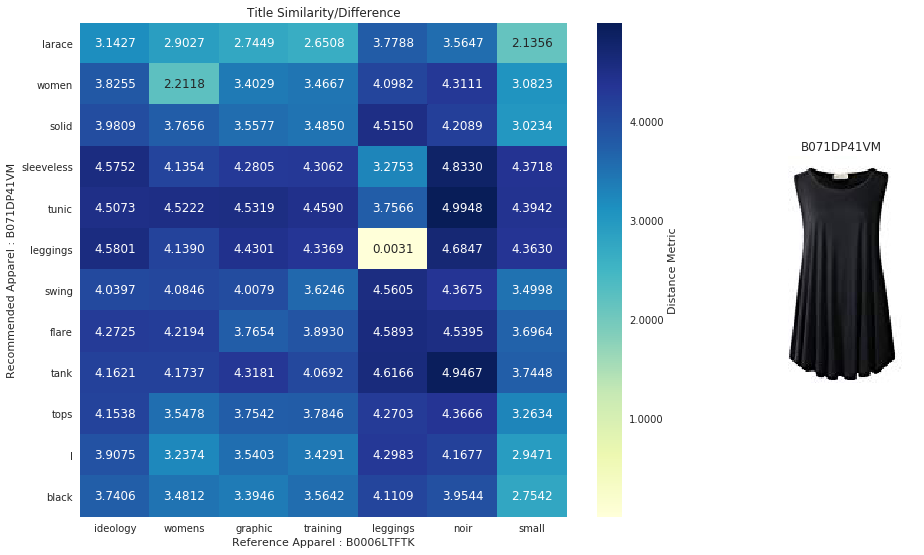




**************************************************
**************************************************
<--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><-->
Reference Image ... 



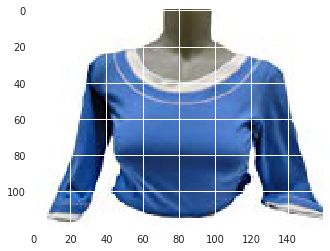

<--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><-->

Recommended Product 1 Information :

ASIN:	 B006E1E3VQ
Brand: 	 BMW
Color: 	 White
Price:	 $65.50

Description Summary: 

 bmw genuine logo performance ladies blouse  xxl  



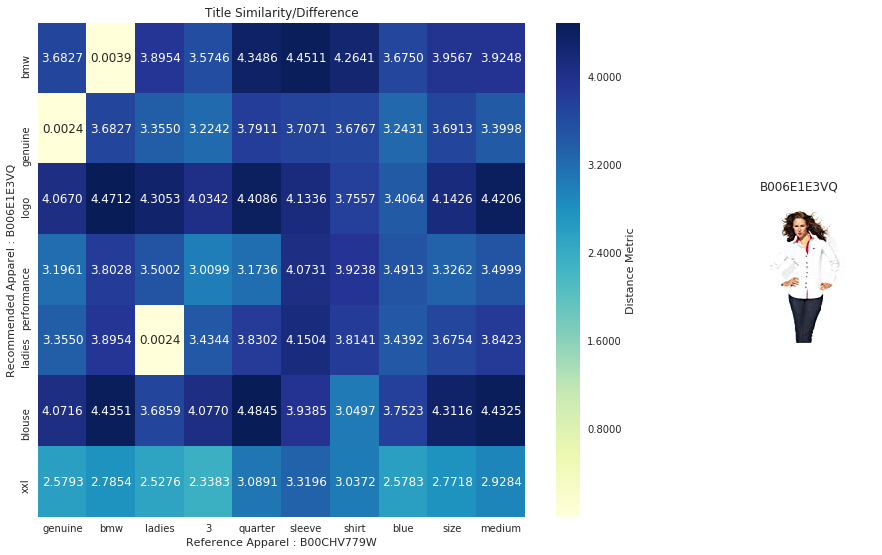





Recommended Product 2 Information :

ASIN:	 B008R82LNQ
Brand: 	 None
Color: 	 Red
Price:	 $41.97

Description Summary: 

 bmw ladies polo  red xlarge  



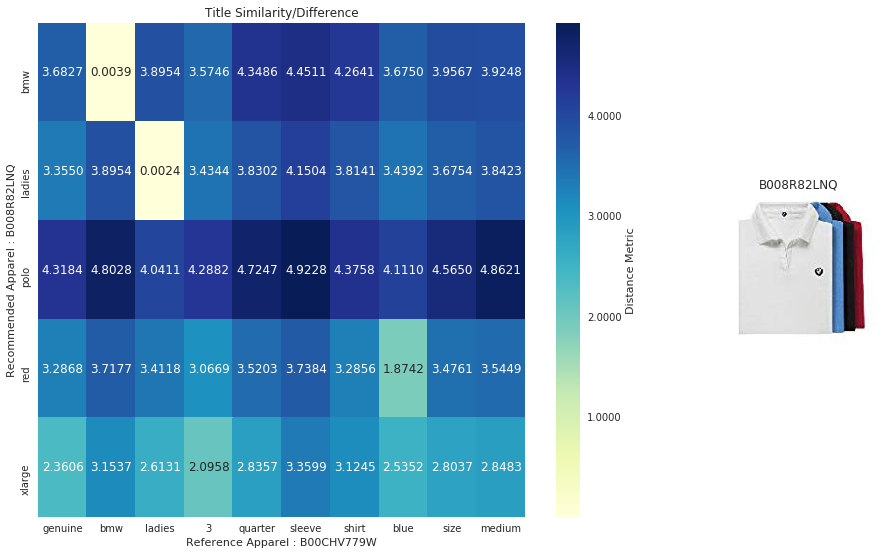





Recommended Product 3 Information :

ASIN:	 B00FLVWB0U
Brand: 	 BMW
Color: 	 white/dark blue
Price:	 $58.50

Description Summary: 

 bmw yachting polo shirt  ladies whitedark blue  medium  



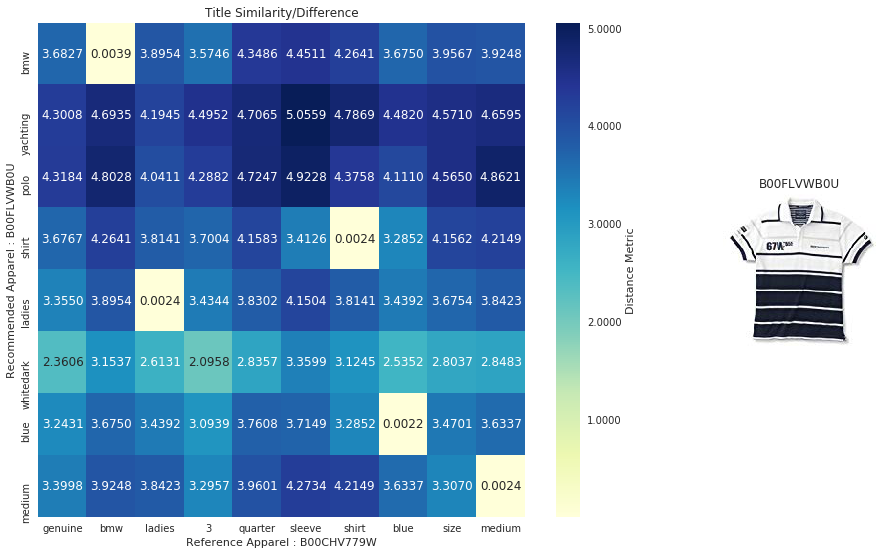





Recommended Product 4 Information :

ASIN:	 B007BIE4DI
Brand: 	 BMW
Color: 	 Blue
Price:	 $41.00

Description Summary: 

 bmw ladies polo shirt  light blue  x large  



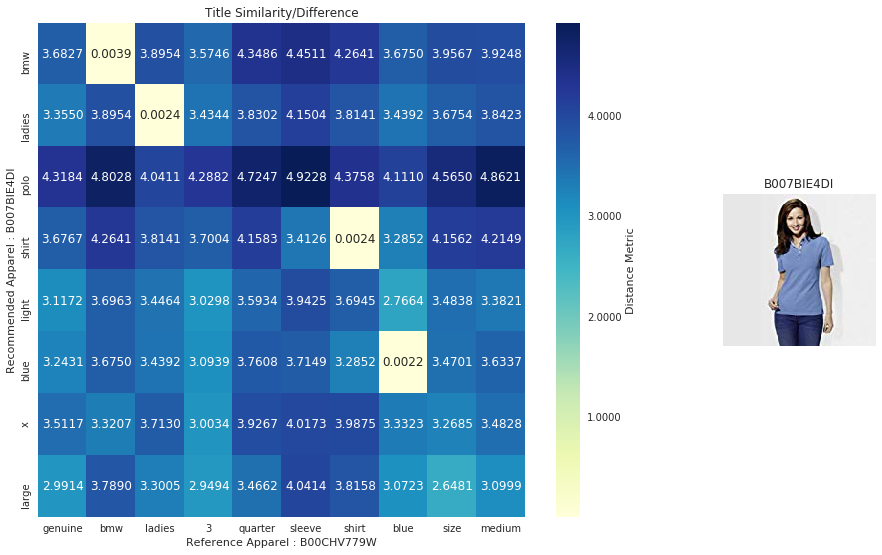





Recommended Product 5 Information :

ASIN:	 B007UAEXPG
Brand: 	 VW
Color: 	 Black
Price:	 $19.75

Description Summary: 

 genuine volkswagen ladies little black tee  size large  



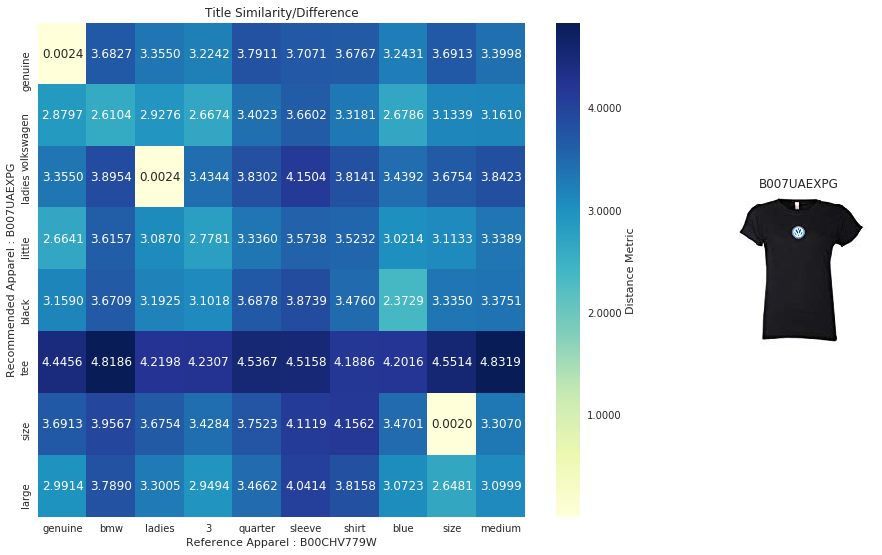





Recommended Product 6 Information :

ASIN:	 B014N2GMWK
Brand: 	 Elementz
Color: 	 Black
Price:	 $4.02

Description Summary: 

 elementz blouse black three quarter sleeve size  



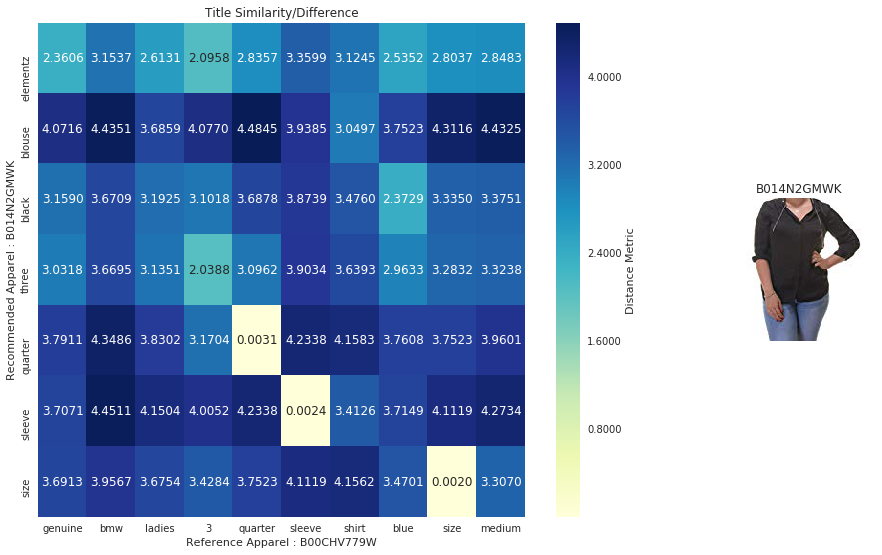





Recommended Product 7 Information :

ASIN:	 B00AA30188
Brand: 	 BMW
Color: 	 dark blue
Price:	 $29.00

Description Summary: 

 bmw ladies longsleeve shirt dark blue  small  



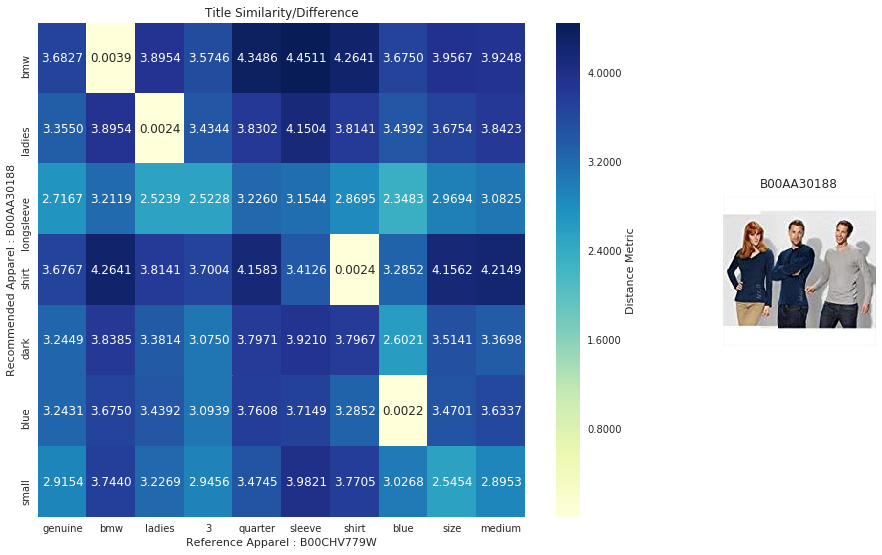





Recommended Product 8 Information :

ASIN:	 B006F8W9B4
Brand: 	 BMW
Color: 	 Blue
Price:	 $78.45

Description Summary: 

 bmw ladies longsleeve  light blue  small  



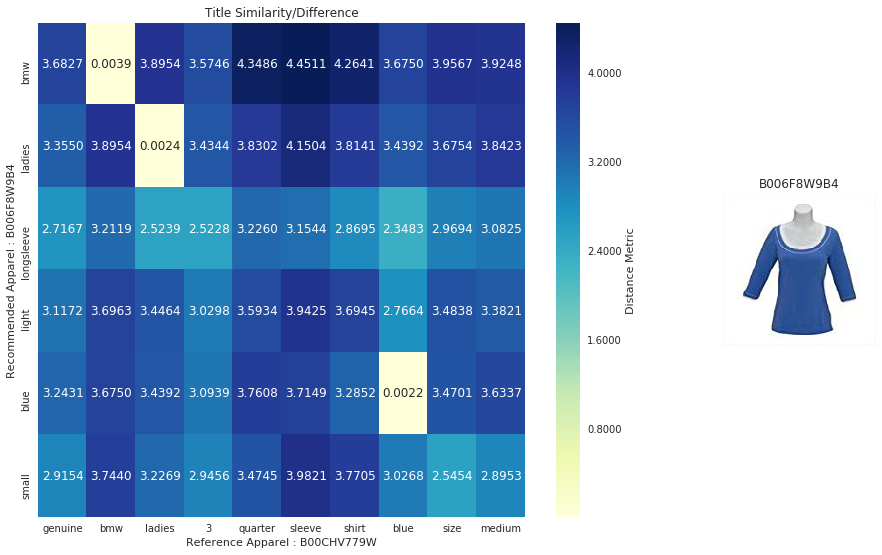




**************************************************
**************************************************
<--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><-->
Reference Image ... 



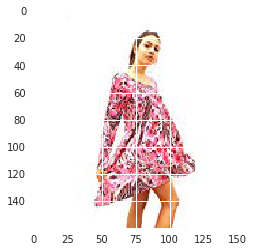

<--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><--><-->

Recommended Product 1 Information :

ASIN:	 B01N4QQMBJ
Brand: 	 BASICOJ
Color: 	 Gray
Price:	 $17.99

Description Summary: 

 basicoj womens turtle neck long sleeve leopard animal print top  



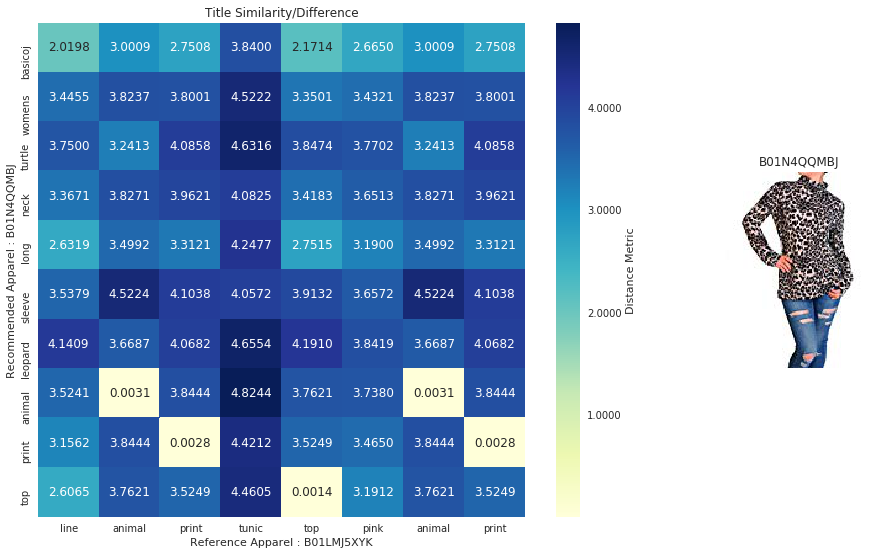





Recommended Product 2 Information :

ASIN:	 B06X6GX6WG
Brand: 	 Animal
Color: 	 Banana Yellow Marl
Price:	 $38.95

Description Summary: 

 animal oceania tshirt  yellow  



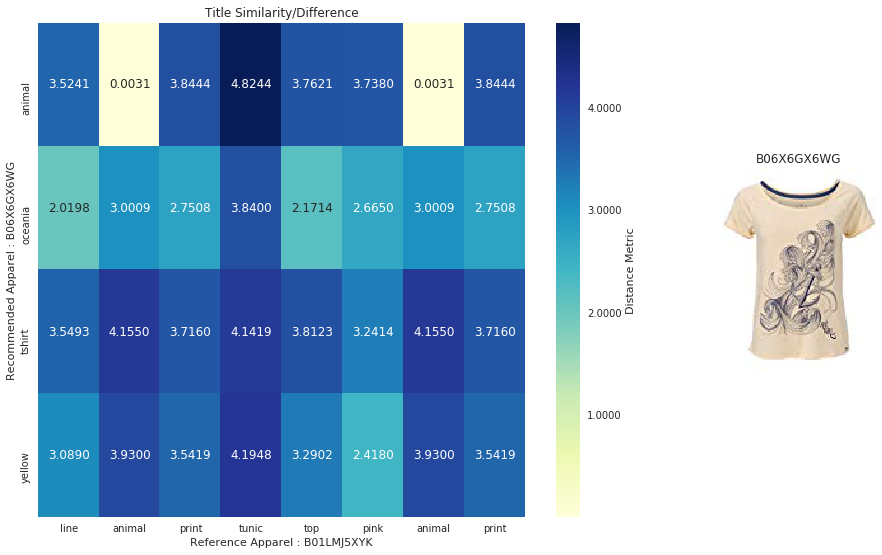





Recommended Product 3 Information :

ASIN:	 B074QV7PCM
Brand: 	 Brazen
Color: 	 Gray
Price:	 $18.99

Description Summary: 

 brazen womens one animal print embellished blouse gray one size  



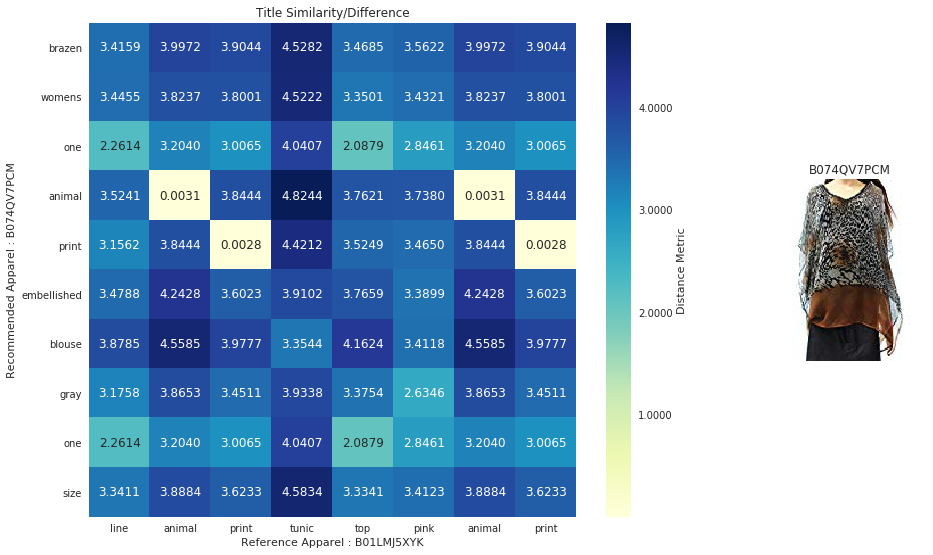





Recommended Product 4 Information :

ASIN:	 B071Z8L7Z3
Brand: 	 Bifast
Color: 	 Grey
Price:	 $14.99

Description Summary: 

 bifast womens daily neck batwing sleeve cotton animal print shirt greyxl  



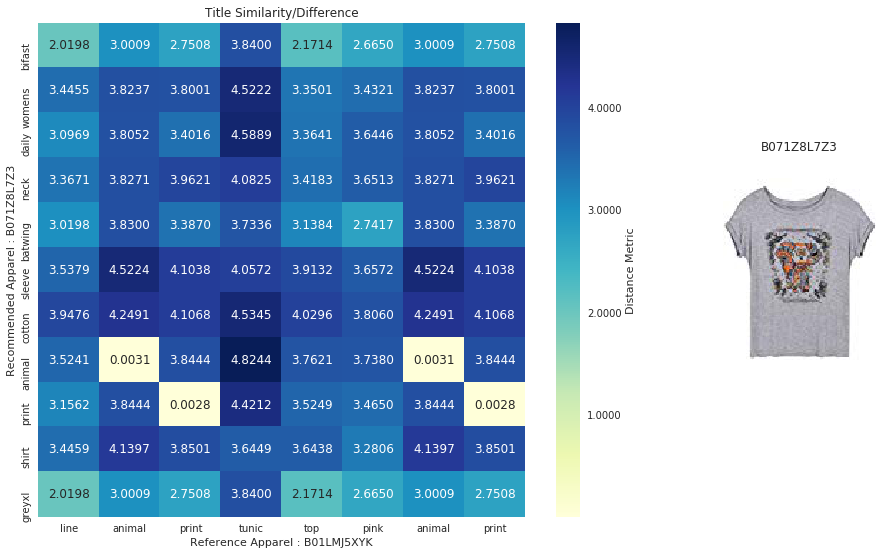





Recommended Product 5 Information :

ASIN:	 B01DSAAHAG
Brand: 	 Modamix Woman
Color: 	 Multi Color
Price:	 $39.99

Description Summary: 

 modamix womens plus short sleeve animal print blouse 1x zebra  



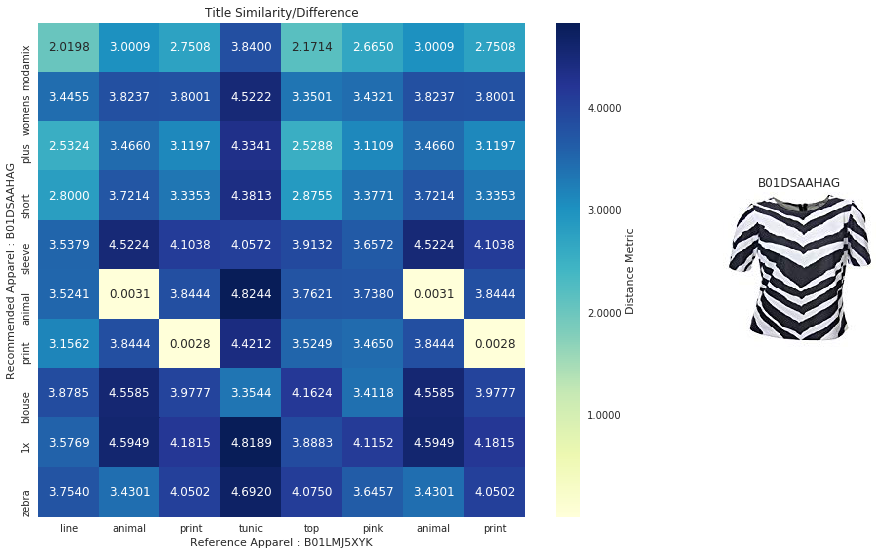





Recommended Product 6 Information :

ASIN:	 B01EXZQR4K
Brand: 	 eshion
Color: 	 One Color
Price:	 $8.99

Description Summary: 

 eshion womens summer casual tiger animal print tshirt tops  



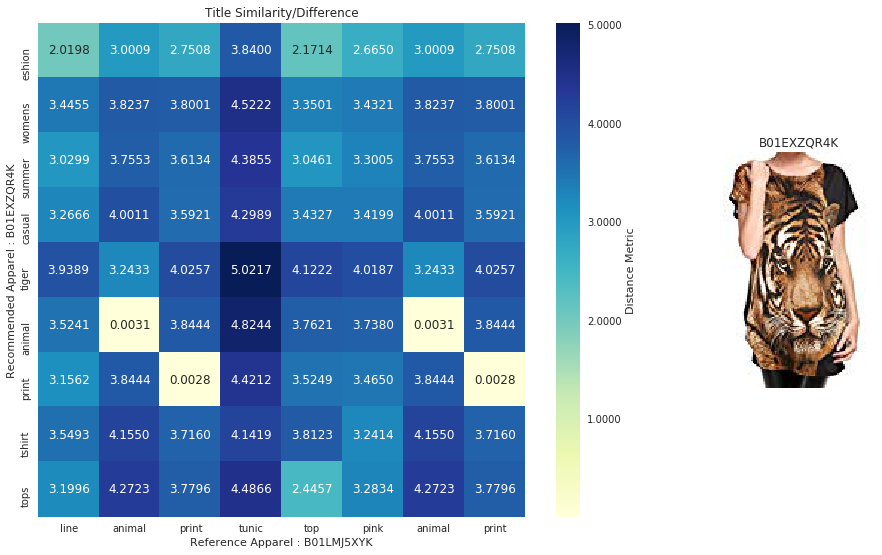





Recommended Product 7 Information :

ASIN:	 B00GX3NO74
Brand: 	 Demarkt
Color: 	 Leopard
Price:	 $10.77

Description Summary: 

 demarkt womens sexy animal leopard print long sleeve blouse  



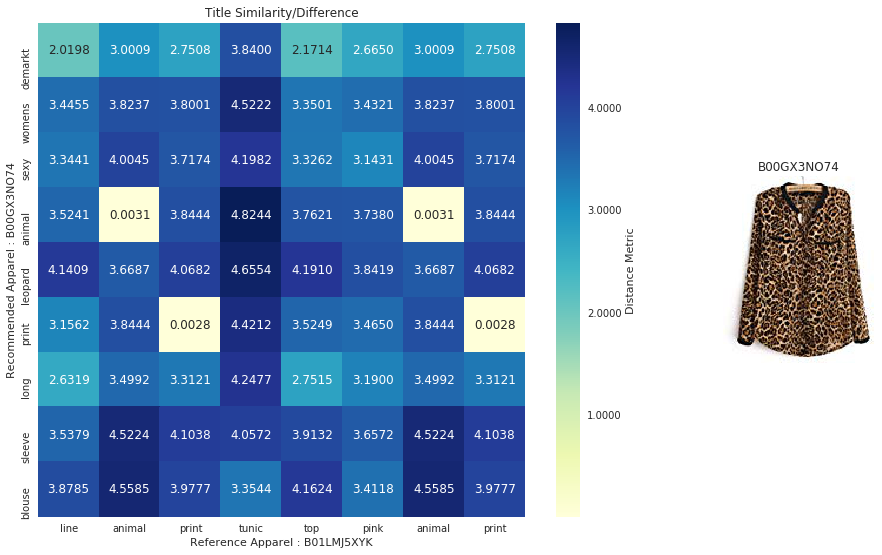





Recommended Product 8 Information :

ASIN:	 B0756L6MTG
Brand: 	 Salvatore Ferragamo
Color: 	 Black/Lavender
Price:	 $149.00

Description Summary: 

 salvatore ferragamo animal print tshirt l  



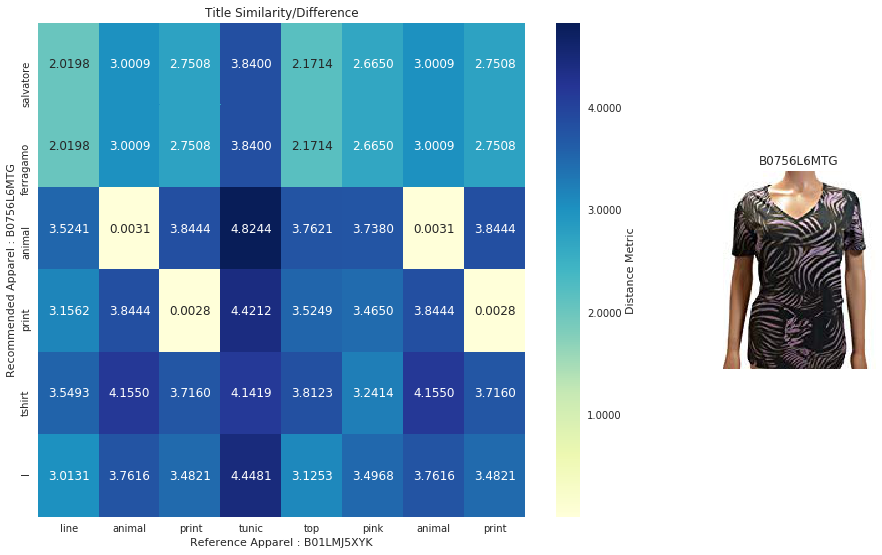




**************************************************


In [59]:
for i in range(1, 5):
    weighted_df_path = './data/final_weigted_df_' + str(i) + '.csv'
    recommend_apparel(weighted_df_path, ref_apparel_list)

# Procedure Summary

<ul>
<li> Vectorized title using tf-idf vectorizer </li>
<li> Vectorized brand, color data using Bag of words vectorizer </li>
<li> Image features is extracted using CNN </li>
<li> Dimensionality reduction using SVD is done on the image features </li>
<li> Final dataset is prepared by combining all types of features </li>
<li> Four different combinations of weights are assigned to each of the features to create input dataframes</li>
<li> Similar item to a given apparel is identified using cosine similarity metric </li>
</ul>

# Conclusion

<ul>
<li> Recommended 8 similar apparels for four different reference apparel</li>
<li> From the above results, apparels recommended to a given apparel is very similar to it </li>
<li> Most of the apparels recommended are woman apparels </li>
<li> Giving equal weight i.e (0.25, 0.25, 0.25, 0.25) to each of the featues title, color, brand, image
     showed better results</li>
<li> Considering all the features improved results </li>
<li> More feature engineering methods can be tried to improve the results further </li>
</ul>